# 🚀 Deep Learning Odyssey

🪖 **Special Forces:** 

    🐒 Jeyakumar Sriram (p2214618)

    🦧 Shawn Lim Jun Jie (p2239745)

**📚 Class:** DAAA/FT/2A/01

**🔍 Module Code:** ST1504

---

## 🌟 Mission Brief

Embark on a transformative journey as we engineer a marvelous Generative Adversarial Network (GAN) to breathe life into images from the renowned CIFAR-10 dataset. Our mission is to generate realistic and twisty pixels.

### 🎨 Artistry in AI

Generative Adversarial Networks (GANs) are a tested architecture, able to craft images that blur the line between reality and imagination with finesse and sophistication.

### 🌌 Exploring the Data Cosmos

CIFAR-10, a dataset of 60,000 32x32 color images spanning 10 distinct classes. Our objective is to create a GAN monster to produce images that match the visual diversity of the authentic CIFAR-10 dataset.

### 🔬 Methodology

Harnessing the power of PyTorch, we'll architect our GAN to wield a generator that crafts indistinguishable images, while a discriminator sharpens its ability to discern authentic from generated.

---

## 🚀 Project Blueprint

1. **🔧 Imports & Configuration**
2. **🔍 In-Depth Research**
3. **🛠️ Engineering Marvels: Feature Engineering**
4. **🗺️ Navigating the CIFAR-10 Landscape**
5. **📊 Metrics: Precision and Creativity**
6. **🤖 Beep Boop! GAN Comes to Life**
7. **🎯 Engineering our Model for Excellence**
8. **🔍 Critical Appraisal: Evaluating Our Creation**
9. **🔚 Conclusion: Bridging Creativity and Performance**

---

## 📚 References

1. Betzalel, E. et al. (2022) ‘A Study on the Evaluation of Generative Models’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/2206.10935.

2. Borji, A. (2021) ‘Pros and Cons of GAN Evaluation Measures: New Developments’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/2103.09396.

3. Gandhi, R. (2018). Generative Adversarial Networks — Explained. [online] Medium. Available at: https://towardsdatascience.com/generative-adversarial-networks-explained-34472718707a.

4. Ghosh, B. et al. (2020) ‘An Empirical Analysis of Generative Adversarial Network Training Times with Varying Batch Sizes’, in 2020 11th IEEE Annual Ubiquitous Computing, Electronics & Mobile Communication Conference (UEMCON), pp. 0643–0648. doi: 10.1109/UEMCON51285.2020.9298092.

5. Goodfellow, I. J. et al. (2014) ‘Generative Adversarial Networks’, arXiv [stat.ML]. Available at: http://arxiv.org/abs/1406.2661.

6. Mack, D. (2019). A simple explanation of the Inception Score. [online] Octavian. Available at: https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a.

7. Mirza, M. and Osindero, S. (2014) ‘Conditional Generative Adversarial Nets’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/1411.1784.

8. Odena, A., Olah, C., & Shlens, J. (2016). *Conditional Image Synthesis With Auxiliary Classifier GANs*, arXiv preprint arXiv:1610.09585.

9. Pleiss, G. et al. (2020) ‘Identifying Mislabeled Data using the Area Under the Margin Ranking’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/2001.10528.

10. Radford, A., Metz, L. and Chintala, S. (2016) ‘Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/1511.06434.

11. Sato, N. and Iiduka, H. (2023) ‘Existence and Estimation of Critical Batch Size for Training Generative Adversarial Networks with Two Time-Scale Update Rule’, arXiv [cs.LG]. Available at: http://arxiv.org/abs/2201.11989.

12. Zhao, S. et al. (2020) ‘Differentiable Augmentation for Data-Efficient GAN Training’, arXiv [cs.CV]. Available at: http://arxiv.org/abs/2006.10738.

13. Zhang, Xinbin, An Improved Method of Identifying Mislabeled Data and the Mislabeled Data in MNIST and CIFAR-10 (November 30, 2017). Available at SSRN: https://ssrn.com/abstract=3080736 or http://dx.doi.org/10.2139/ssrn.3080736.

## 🔧 Imports & Configuration

We will be using these libraries in our project. To ensure availability we will import the crucial ones.

In [1]:
!pip install --quiet tensorflow matplotlib tqdm torchmetrics[image] kornia aum


[notice] A new release of pip is available: 23.3.1 -> 23.3.2
[notice] To update, run: python -m pip install --upgrade pip


In [2]:
import warnings; warnings.filterwarnings("ignore")

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# TorchVision
from torchvision import transforms, datasets

# TorchGAN
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image.kid import KernelInceptionDistance
from aum import AUMCalculator, DatasetWithIndex
# Keras
from keras.datasets import cifar10
from keras.utils import to_categorical

# DiffAugment
import kornia.augmentation as K

# Warnings and Time
import time
import random 

# Data Visualization
import matplotlib.pyplot as plt
import numpy as np

# Progress Bar
from tqdm import tqdm

# Device Configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

2024-01-31 11:31:15.380151: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-31 11:31:15.421975: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-31 11:31:15.422013: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-31 11:31:15.423034: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-31 11:31:15.429291: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-31 11:31:15.429905: I tensorflow/core/platform/cpu_feature_guard.cc:1

### Constants

In [3]:
IMAGE_SIZE = 32     # image size, number of pixel, assuming square image (length = width)
CHANNELS = 3        # number of channels, which in our case is 3, because RGB
NUM_CLASS = 10      # number of classes, which in cifar-10, is 10
TRAIN_BATCH_SIZE = 512 # Adjust based on how powerful GPU is, 2048 for RTX 4090 but 512 for P100
CLASSES = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

### Utility Code

In [4]:
def plot_losses(epochs, models):
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))
    epochs = list(range(epochs))
    for model, name in models:
        axes[0, 0].plot(epochs, model.disc_scores, marker='o', linestyle='-', label=f'{name}')
    axes[0, 0].set_title('Discriminator Loss over Epochs/Steps')
    axes[0, 0].set_xlabel('Epochs/Steps')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].legend()
    axes[0, 0].grid(True)

    for model, name in models:
        axes[0, 1].plot(epochs, model.gen_scores, marker='x', linestyle='-', label=f'{name}')
    axes[0, 1].set_title('Generator Loss over Epochs/Steps')
    axes[0, 1].set_xlabel('Epochs/Steps')
    axes[0, 1].set_ylabel('Loss')
    axes[0, 1].legend()
    axes[0, 1].grid(True)
        
    for model, name in models:
        axes[1, 0].plot(model.fid_epochs, model.kid_scores, marker='s', linestyle='-', label=f'{name}')
    axes[1, 0].set_title('KID Score over Epochs/Steps')
    axes[1, 0].set_xlabel('Epochs/Steps')
    axes[1, 0].set_ylabel('KID Score')
    axes[1, 0].legend()
    axes[1, 0].grid(True)

    for model, name in models:
        axes[1, 1].plot(model.fid_epochs, model.fid_scores, marker='s', linestyle='-', label=f'{name}')
    axes[1, 1].set_title('FID Score over Epochs/Steps')
    axes[1, 1].set_xlabel('Epochs/Steps')
    axes[1, 1].set_ylabel('FID Score')
    axes[1, 1].legend()
    axes[1, 1].grid(True)
        
    plt.tight_layout()
    plt.show()
    plt.figure(figsize=(12, 6))

In [5]:
def visualize_images(images, title):
    fig, axes = plt.subplots(1, len(images), figsize=(12, 4))
    for i in range(len(images)):
        axes[i].imshow(images[i].cpu().numpy())
        axes[i].axis('off')
    fig.suptitle(title)
    plt.show()

## 🔍 In-Depth Research



### The GAN Concept:

GAN stands for Generative Adversarial Networks. As the name suggests, it features two adversarial networks competing to complete a generative task. 

The GAN architecture was first introduced in [this paper](https://arxiv.org/abs/1406.2661) by Ian Goodfellow and his colleages and has proven itself as a viable method for generative tasks. 

The generator generates a set of fake images using some noise while the discriminator tries to differentiate the fake images from actuals images sampled from the dataset.The two models have two opposing objectives:
- Generator creates images and tries to fool the discriminater
- Discriminator will improve and prevent generator from fooling it

![diag](https://miro.medium.com/v2/resize:fit:1400/format:webp/1*XKanAdkjQbg1eDDMF2-4ow.png)

As shown in the diagram, the generator takes in noise as input and through a series of upsampling layers, turns the noise into something like a image. The discriminator on the other hand takes in both the generated images and some original images and tries to classify which one is fake and not. 

![formula](https://miro.medium.com/v2/resize:fit:1400/1*M_YipQF_oC6owsU1VVrfhg.jpeg)

Backpropagation is done twice. Once to update the discriminator and once to update the generator while backpropagating through the discriminator. 


### Challenges in Training GAN

This adversarial way of training presents unique challenges that are not easy to solve. During the training, we need to ensure the generator and discrminator are learning in a balanced way. 

Discriminator Too Strong -> Generator will not even be able to start fooling it and thus won't learn much

Generator Too Strong -> Discriminator will not be able to provide useful information during backpropagation hindering improvement

![mode collapse](https://i0.wp.com/neptune.ai/wp-content/uploads/2022/10/GANs-Failure-Modes-How-to-Identify-and-Monitor-Them_9.png?resize=559%2C555&ssl=1)

Without a delicate balance the GAN will not produce good balance. Another common problem is Mode Collapse. This is a scenarios where the generator learns to produce one specific type of image very well and fools the discriminator consistently, effectively trading output variety for a higher score. 

![vg](https://velog.velcdn.com/images/masibasi/post/802845b9-4810-4ad0-87fd-a9c2f0905c43/image.png)

Another problem could be vanishing gradients. When there is vanishing gradients, a discrminator might be less sensitive to the generator's output and provide weak feedback. Since the generator's update backprogates through the discrminator, vanishing gradient could result in the generator learning little as the gradient's are not as useful by the time they reach it. This can be mitigated by using normalisation in our model architecture.


### The CIFAR-10 Story

CIFAR-10 stands for the "Canadian Institute for Advanced Research - 10 classes" and was created to facilitate research in computer vision and machine learning. It contains 60,000 labelled 32x32 images from 10 classes which are plane, car, bird, cat, deer, dog, frog, horse, ship, and truck. The dataset has a train-test split of 50,000-10,000. 

While it is a popular dataset, it does have its problems:

**Low Image Resolution:**

   - The images in CIFAR-10 are relatively small, with dimensions of 32x32 pixels. This low resolution can make it challenging for models to capture fine-grained details in the images.

**Limited Diversity:**

   - The dataset consists of 60,000 images across 10 classes, and each class contains only 6,000 images. The limited number of samples per class may not be sufficient for training complex models.
    
**Mislabelling:**

   - Though the images were all labelled by humans, due to some human error there are some mislabelled images. A [paper](https://papers.ssrn.com/sol3/papers.cfm?abstract_id=3080736) published by Mr Zhang from Beijing University of Posts and Telecommunications found 118 images in CIFAR-10 being mislabelled. After reclassifying them, it was observed that model performance improved.
   
In lieu of these limitations, a highly complex model may not always be the best choice. We will start of simple and focus on improving the training process and model architecture rather than just increasing model complexity.

## 🛠️ Engineering Marvels: Feature Engineering


#### Scaling
One of the important preprocessing that has to be done is to scale the pixel values for the training images to [-1, 1]. This is because we will be using the tanh activation function for the generator model which ranges from -1 to 1. So to ensure that the real and fake images have the same range, we will need to scale the real images to [-1, 1]. This can also help the model converge faster

This will be the formula for performing the transformation:

$$X_{new} = \frac{X_{old}}{127.5} - 1$$

#### One Hot Encoding

As we need to labeled images, and since the labelling are in nominal, we will do one hot encoding on the labels


#### Batch Size

In the context of training GANs batch size is one of the most important hyperparameters. It defines how many real images are being passed into the GAN at any one time. Too small batch size might result in high variability in gradient estimates and lead to instability while training. While too large of a batch size might run into memory requirements. 

![plot](https://i.ibb.co/9h9dSfP/Screenshot-2024-01-28-at-11-10-25-PM.png)

We found an analysis of GANs with varying batch sizes in this [paper](https://arxiv.org/pdf/2201.11989.pdf) where they analysed the number of step $N$ needed to reach a lower FID score across varying batch sizes. They tested DCGAN, WGAN-GP and BigGAN. Their results for DCGANs on the LSUN-Bedroom dataset seems to suggests that bigger batch sizes may result in faster improvement. Although the dataset is different from our, this provides a good starting point for us to begin finding a optimal batch size for our model.

#### Handling Mislabelling

As mentioned in a previous section, CIFAR-10 containes quite some mislabelled data. Even during EDA I had observed a few. But in this feature engineering section, I would like to identify the mislabelled data and reclassify them into their right category. 

**Methodology**

- Finding Mislablled Data
- Reclassfying


To train our ResNet model used to classify the mislabelled images we will temporarily use the torch version of Cifar10 but later we will switch back to Tensorflow. 

To start of I will first get the dataset, perform a train val split on the training data. This is done in accordance with the methods outline in the research paper.

In [14]:
VALID_SIZE = 5000
TRAIN_BATCH_SIZE = 64
VALID_BATCH_SIZE = 64
LEARNING_RATE = 0.1
MOMENTUM = 0.9
EPOCHS = 32
CSV_DIR = './csv'

train_transforms = transforms.Compose([
    transforms.RandomCrop(32, padding=4),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])
test_transforms = transforms.Compose([
    transforms.ToTensor(),
])

train_dataset_torch = datasets.CIFAR10('test',
                                train=True,
                                transform=train_transforms,
                                download=True)
val_dataset_torch = datasets.CIFAR10('test', train=True, transform=test_transforms)
test_dataset_torch = datasets.CIFAR10('test', train=False, transform=test_transforms)


# do a shuffle and then slice the training data to have training and validation
indices = torch.randperm(len(train_dataset_torch))
train_indices = indices[:len(indices) - VALID_SIZE]
valid_indices = indices[len(indices) - VALID_SIZE:]
train_data = torch.utils.data.Subset(train_dataset_torch, train_indices)
val_data = torch.utils.data.Subset(val_dataset_torch, valid_indices)

# use AUM's custom dataset
train_set = DatasetWithIndex(train_data)
val_set = DatasetWithIndex(val_data)
test_set = DatasetWithIndex(test_dataset_torch)

val_loader = DataLoader(val_set,
                        batch_size=64,
                        shuffle=False,
                        pin_memory=(torch.cuda.is_available()))
test_loader = DataLoader(test_set,
                            batch_size=64,
                            shuffle=False,
                            pin_memory=(torch.cuda.is_available()))

Files already downloaded and verified


Here, we will create the model, instantiate the a data structue to hold the AUM, and write functions to evaluate AUM of each datapoint using the model.

In [15]:
# Reference: https://github.com/asappresearch/aum/blob/master/examples/cifar100/train.py
from torchvision.models import resnet34
class AverageMeter(object):
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def train_step(metrics, aum_calculator, batch_step, num_batches,
               batch, epoch, num_epochs, model, optimizer, device, calculate_aum):
    start = time.time()
    model.train()
    with torch.enable_grad():
        optimizer.zero_grad()
        
        # if we want to calculate the AUM, then there will be another value to unpack
        if calculate_aum:
            input, target, sample_ids = batch
        else:
            input, target = batch
                    
        input = input.to(device)
        target = target.to(device)

        # Compute output
        output = model(input)
        loss = F.cross_entropy(output, target)

        # Compute gradient and optimize
        loss.backward()
        optimizer.step()

        # Measure accuracy & record loss
        end = time.time()
        batch_size = target.size(0)
        _, pred = output.data.cpu().topk(1, dim=1)
        error = torch.ne(pred.squeeze(), target.cpu()).float().sum().item() / batch_size

        metrics['error'].update(error, batch_size)
        metrics['loss'].update(loss.item(), batch_size)
        metrics['batch_time'].update(end - start)

        # Update AUM
        if calculate_aum:
            aum_calculator.update(output, target, sample_ids.tolist())

        # log to console
        if (batch_step + 1) % 100 == 0:
            results = '\t'.join([
                'TRAIN',
                f'Epoch: [{epoch}/{num_epochs}]',
                f'Batch: [{batch_step}/{num_batches}]',
                f'Time: {metrics["batch_time"].val:.3f} ({metrics["batch_time"].avg:.3f})',
                f'Loss: {metrics["loss"].val:.3f} ({metrics["loss"].avg:.3f})',
                f'Error: {metrics["error"].val:.3f} ({metrics["error"].avg:.3f})',
            ])
            print(results)


def eval_step(metrics, batch, model, device):
    start = time.time()
    model.eval()
    with torch.no_grad():
        input, target, sample_ids = batch
        input = input.to(device)
        target = target.to(device)

        # Compute output
        output = model(input)
        loss = F.cross_entropy(output, target)

        # Measure accuracy & record loss
        end = time.time()
        batch_size = target.size(0)
        _, pred = output.data.cpu().topk(1, dim=1)
        error = torch.ne(pred.squeeze(), target.cpu()).float().sum().item() / batch_size

        metrics['error'].update(error, batch_size)
        metrics['loss'].update(loss.item(), batch_size)
        metrics['batch_time'].update(end - start)


# Load Model
model = resnet34(num_classes=10)
model = model.to(device)
num_params = sum(x.numel() for x in model.parameters() if x.requires_grad)
print(model)
f'Number of parameters: {num_params}'

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

'Number of parameters: 21289802'

Once modelling is done, we will now calculate the AUM for each datapoint using the ResNet model and save the AUM values to a CSV. We are saving it to a CSV because that is how the AUM libary is implemented. 

In [16]:
# Reference: https://github.com/asappresearch/aum/blob/master/examples/cifar100/train.py
import math
# Create optimizer & lr scheduler
parameters = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(parameters,
                            lr=LEARNING_RATE,
                            momentum=MOMENTUM,
                            nesterov=True)
milestones = [0.5 * EPOCHS, 0.75 * EPOCHS]
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=milestones, gamma=0.1)

# Keep track of AUM
aum_calculator = AUMCalculator(CSV_DIR, compressed=True)

# Keep track of things
best_error = math.inf

# keep the best model
best_model = None

for epoch in range(EPOCHS):

    train_loader = DataLoader(train_set,
                                batch_size=TRAIN_BATCH_SIZE,
                                shuffle=True,
                                pin_memory=(torch.cuda.is_available()),
                                num_workers=0)

    # set up the metrics
    train_metrics = {
        'loss': AverageMeter(),
        'error': AverageMeter(),
        'batch_time': AverageMeter()
    }
    val_metrics = {
        'loss': AverageMeter(),
        'error': AverageMeter(),
        'batch_time': AverageMeter()
    }

    num_batches = len(train_loader)
    for batch_step, batch in enumerate(train_loader):
        train_step(train_metrics, aum_calculator,
                    batch_step, num_batches, batch, epoch, EPOCHS, model,
                    optimizer, device, True)

    scheduler.step()

    num_batches = len(val_loader)
    for batch_step, batch in enumerate(val_loader):
        eval_step(val_metrics,  batch, model, device)

    # show the validation data metrics
    results = '\t'.join([
        'VAL',
        f'Epoch: [{epoch}/{EPOCHS}]',
        f'Time: {val_metrics["batch_time"].val:.3f} ({val_metrics["batch_time"].avg:.3f})',
        f'Loss: {val_metrics["loss"].val:.3f} ({val_metrics["loss"].avg:.3f})',
        f'Error: {val_metrics["error"].val:.3f} ({val_metrics["error"].avg:.3f})',
    ])
    print(results)

    # get the best model
    if val_metrics['error'].avg < best_error:
        best_error = val_metrics['error'].avg
        best_model = model

# Finalize aum calculator
aum_calculator.finalize(CSV_DIR)

TRAIN	Epoch: [0/32]	Batch: [99/704]	Time: 0.023 (0.025)	Loss: 2.709 (3.679)	Error: 0.859 (0.880)
TRAIN	Epoch: [0/32]	Batch: [199/704]	Time: 0.025 (0.025)	Loss: 2.246 (2.969)	Error: 0.891 (0.861)
TRAIN	Epoch: [0/32]	Batch: [299/704]	Time: 0.014 (0.026)	Loss: 2.082 (2.686)	Error: 0.844 (0.844)
TRAIN	Epoch: [0/32]	Batch: [399/704]	Time: 0.021 (0.026)	Loss: 1.936 (2.526)	Error: 0.672 (0.832)
TRAIN	Epoch: [0/32]	Batch: [499/704]	Time: 0.033 (0.026)	Loss: 2.144 (2.418)	Error: 0.797 (0.819)
TRAIN	Epoch: [0/32]	Batch: [599/704]	Time: 0.012 (0.026)	Loss: 1.806 (2.337)	Error: 0.625 (0.807)
TRAIN	Epoch: [0/32]	Batch: [699/704]	Time: 0.027 (0.026)	Loss: 1.935 (2.271)	Error: 0.797 (0.795)
VAL	Epoch: [0/32]	Time: 0.004 (0.016)	Loss: 2.255 (2.237)	Error: 0.750 (0.756)
TRAIN	Epoch: [1/32]	Batch: [99/704]	Time: 0.012 (0.027)	Loss: 1.736 (1.878)	Error: 0.656 (0.722)
TRAIN	Epoch: [1/32]	Batch: [199/704]	Time: 0.024 (0.027)	Loss: 1.730 (1.851)	Error: 0.688 (0.711)
TRAIN	Epoch: [1/32]	Batch: [299/704]	Time

In [18]:
torch.save(best_model, "ResNetClassifier")

We will also evaluate the model.

In [19]:
# Eval best model on on test set
test_metrics = {'loss': AverageMeter(), 'error': AverageMeter(), 'batch_time': AverageMeter()}
num_batches = len(test_loader)
for batch_step, batch in enumerate(test_loader):
    eval_step(test_metrics, batch, best_model, device)

# log test metrics to console
results = '\t'.join([
    'FINAL TEST RESULTS',
    f'Loss: {test_metrics["loss"].avg:.3f}',
    f'Error: {test_metrics["error"].avg:.3f}',
])
print(results)

FINAL TEST RESULTS	Loss: 0.779	Error: 0.220


To identify the mislabelled images we will be using the same baseline of -0.8 as mentioned in the paper. 

In [20]:
import pandas as pd
# df_anom = pd.read_csv('./csv/cifar10_high_aum.1d188306.csv')
df_aum = pd.read_csv('./csv/aum_values.csv')
df_normal = df_aum[df_aum['aum'] >= -0.8]
df_anom = df_aum[df_aum['aum'] < -0.8]

# get the list of indexes that are normal and anomalous
normal_idx = df_normal['sample_id'].to_list()
anomalous_idx = df_anom['sample_id'].to_list()
print(f'Number of anomalous images: {len(anomalous_idx)}')

# get the subset of the images that are labelled correct
normal_imgs = torch.utils.data.Subset(train_dataset_torch, normal_idx)

Number of anomalous images: 5270


Once we identified the mislabelled images, we will split them from the main dataset, train another model on the remaining data and classify the removed images using that model.

In [21]:
reclassifier_model = resnet34(num_classes=10)
reclassifier_model = reclassifier_model.to(device)

# Create optimizer & lr scheduler
parameters = [p for p in reclassifier_model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(parameters,
                            lr=LEARNING_RATE,
                            momentum=MOMENTUM,
                            nesterov=True)
milestones = [0.5 * EPOCHS, 0.75 * EPOCHS]
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=milestones, gamma=0.1)

# Keep track of things
best_error = math.inf

# keep the best model
best_reclassifier_model = None

for epoch in range(EPOCHS):

    train_loader = DataLoader(normal_imgs,
                                batch_size=TRAIN_BATCH_SIZE,
                                shuffle=True,
                                pin_memory=(torch.cuda.is_available()),
                                num_workers=0)

    # set up the metrics
    train_metrics = {
        'loss': AverageMeter(),
        'error': AverageMeter(),
        'batch_time': AverageMeter()
    }
    val_metrics = {
        'loss': AverageMeter(),
        'error': AverageMeter(),
        'batch_time': AverageMeter()
    }

    num_batches = len(train_loader)
    for batch_step, batch in enumerate(train_loader):
        train_step(train_metrics, aum_calculator,
                    batch_step, num_batches, batch, epoch, EPOCHS, reclassifier_model,
                    optimizer, device, False)

    scheduler.step()

    num_batches = len(val_loader)
    for batch_step, batch in enumerate(val_loader):
        eval_step(val_metrics,  batch, reclassifier_model, device)

    # show the validation data metrics
    results = '\t'.join([
        'VAL',
        f'Epoch: [{epoch}/{EPOCHS}]',
        f'Time: {val_metrics["batch_time"].val:.3f} ({val_metrics["batch_time"].avg:.3f})',
        f'Loss: {val_metrics["loss"].val:.3f} ({val_metrics["loss"].avg:.3f})',
        f'Error: {val_metrics["error"].val:.3f} ({val_metrics["error"].avg:.3f})',
    ])
    print(results)

    # get the best model
    if val_metrics['error'].avg < best_error:
        best_error = val_metrics['error'].avg
        best_reclassifier_model = reclassifier_model

TRAIN	Epoch: [0/32]	Batch: [99/621]	Time: 0.064 (0.025)	Loss: 2.394 (4.760)	Error: 0.844 (0.882)
TRAIN	Epoch: [0/32]	Batch: [199/621]	Time: 0.014 (0.026)	Loss: 2.239 (3.567)	Error: 0.875 (0.871)
TRAIN	Epoch: [0/32]	Batch: [299/621]	Time: 0.055 (0.027)	Loss: 2.227 (3.128)	Error: 0.891 (0.862)
TRAIN	Epoch: [0/32]	Batch: [399/621]	Time: 0.025 (0.028)	Loss: 2.308 (2.891)	Error: 0.828 (0.854)
TRAIN	Epoch: [0/32]	Batch: [499/621]	Time: 0.045 (0.027)	Loss: 2.028 (2.743)	Error: 0.828 (0.849)
TRAIN	Epoch: [0/32]	Batch: [599/621]	Time: 0.023 (0.027)	Loss: 2.038 (2.635)	Error: 0.766 (0.842)
VAL	Epoch: [0/32]	Time: 0.004 (0.011)	Loss: 1.762 (2.132)	Error: 0.875 (0.811)
TRAIN	Epoch: [1/32]	Batch: [99/621]	Time: 0.025 (0.033)	Loss: 2.028 (2.047)	Error: 0.766 (0.790)
TRAIN	Epoch: [1/32]	Batch: [199/621]	Time: 0.049 (0.032)	Loss: 2.006 (2.033)	Error: 0.828 (0.788)
TRAIN	Epoch: [1/32]	Batch: [299/621]	Time: 0.024 (0.032)	Loss: 2.008 (2.017)	Error: 0.828 (0.787)
TRAIN	Epoch: [1/32]	Batch: [399/621]	Time

In [22]:
torch.save(best_reclassifier_model, "ResNet_Reclassifier")

Now that we have training our reclassifier model, we will reclassify all the wrong images.

In [23]:
pure_train_dataset = datasets.CIFAR10('test', train=True, transform=test_transforms)
anomalous_imgs = torch.utils.data.Subset(pure_train_dataset, anomalous_idx)

anomal_loader = DataLoader(anomalous_imgs,
                                batch_size=TRAIN_BATCH_SIZE,
                                shuffle=True,
                                pin_memory=(torch.cuda.is_available()),
                                num_workers=0)

X_corrected = None
y_corrected = None

# unscale the image data so that we can reintegrate them back to the tensorflow cifar10
unscale = lambda x: (x * 255)

for batch in anomal_loader:
    input_, _ = batch
    unscaled_input = unscale(input_.permute(0, 2, 3, 1))
    
    input_ = input_.to(device)
    preds = best_reclassifier_model(input_)
    
    if X_corrected is None and y_corrected is None:
        X_corrected = unscaled_input.numpy()
        y_corrected = torch.argmax(preds, dim=1).cpu().numpy()
    else:
        X_corrected = np.concatenate((X_corrected, unscaled_input.numpy()), axis=0)
        y_corrected = np.concatenate((y_corrected, torch.argmax(preds, dim=1).cpu().numpy()), axis=0)

y_corrected = np.expand_dims(y_corrected, axis=1)

In [59]:
np.savez('corrected_data.npz', X_corrected=X_corrected, y_corrected=y_corrected,anomalous_idx=anomalous_idx )


In [16]:
loaded_data = np.load('./corrected_data2.npz')
X_corrected = loaded_data['X_corrected']
y_corrected = loaded_data['y_corrected']
anomalous_idx = loaded_data['anomalous_idx']


Now we have the inex of the images that are wrongly classfied and also their correct labels. Using this information, we will now switch to tensorflow and use those indexs to shift the data. We would also like to mention that since both tensorflow and pytorch get the data from the same repo, we have confirmed that the indexs of the images are consistent alowing this switch to be possible.

In [17]:
(X_train, y_train), (X_test, y_test) = cifar10.load_data()

# remove images and labels that are anomalous
X_train = np.delete(X_train, anomalous_idx, axis=0)
y_train = np.delete(y_train, anomalous_idx, axis=0)

# and then concatenate the dataset with the corrected label
X_train = np.concatenate((X_train, X_corrected), axis=0)
y_train = np.concatenate((y_train, y_corrected), axis=0)

X_train = torch.from_numpy(X_train).to(device).type(torch.int32)
y_train = torch.from_numpy(y_train).squeeze()
X_test = torch.from_numpy(X_test).to(device).type(torch.int32)
y_test = torch.from_numpy(y_test).squeeze()

170498071/170498071 [==============================] - 8s 0us/step


In [18]:
# Normalisation
scaler = lambda x: (x.type(torch.float32) / 127.5) - 1

X_train_scaled = scaler(X_train)
X_test_scaled = scaler(X_test)

# lastly, I need to reshape our images so that it fits into the pytorch model
X_train_scaled = X_train_scaled.permute(0, 3, 1, 2)
X_test_scaled = X_test_scaled.permute(0, 3, 1, 2)

# One Hot
y_train = torch.from_numpy(to_categorical(y_train).astype('int64')).to(device)
y_test = torch.from_numpy(to_categorical(y_test).astype('int64')).to(device)

train_dataset = TensorDataset(X_train_scaled, y_train)
test_dataset = TensorDataset(X_test_scaled, y_test)

train_loader = DataLoader(train_dataset, batch_size=TRAIN_BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=TRAIN_BATCH_SIZE, shuffle=False)

#### Data Augmentation

Since we have limited data of just 50,000 training images, data augmentations could help us generate more while also reducing overfitting in the dicriminator. While traditional data augmentation could be viable for this project, we propose to use a more novel approach as described in [this paper](https://arxiv.org/pdf/2006.10738.pdf) where Differentiable Augmentation was used to get state of the art results. 

![diff](https://i.ytimg.com/vi/FKgURAY04fs/maxresdefault.jpg)

> We experiment on the class-conditional BigGAN [2] and CR-BigGAN [50] and unconditional
StyleGAN2 [18] models. For a fair comparison, we also augment real images with random horizontal
flips for all the baselines. The baseline models already adopt advanced regularization techniques,
including Spectral Normalization [28], Consistency Regularization [50], and R1 regularization [27];
however, none of them achieves satisfactory results under the 10% data setting. For DiffAugment, we
adopt Translation + Cutout for the BigGAN models, Color + Cutout for StyleGAN2 with 100% data,
and Color + Translation + Cutout for StyleGAN2 with 10% or 20% data. As summarized in Table 4,
our method improves all the baselines independently of the baseline architectures, regularizations,
and loss functions (hinge loss in BigGAN and non-saturating loss in StyleGAN2) without any
hyperparameter changes. We refer the readers to the appendix (Tables 6-7) for the complete tables
with IS. The improvements are considerable especially when limited data is available. This is, to
our knowledge, the new state of the art on CIFAR-10 and CIFAR-100 for both class-conditional and
unconditional generation under all the 10%, 20%, and 100% data settings.

Differential Augmentation as the name suggests adds image augmentation which are differentiable to the Discriminator model. Instead of introducing random noise, the paper, we allow the model to adapt its augmentation strategy based on the learning objective. The paper also proposes a "Augment everywhere" idea which suggests to apply augmentation not just to the real data but also the fake data. This approach will definitely help with mitigating mode collapse as the generator would have to generate more variety of images to fool the discriminator. 

![kornia](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcS3yeZF_gfxK5qLHlyqWWFUy9RXVHVe0g47bPKaItbK3Aq2LReWMq2m1kozB333iBORMnY&usqp=CAU)

Although it is possible to implement DiffAugment from scratch using PyTorch and we have tried it. We would like to simplify the process by using a library called Kornia. Kornia is a open source computer vision library that is designed for differtiable computer vision operations. One of its main selling points is its close integration with pytorch. All of its modules are actually valid PyTorch objects and thus it ontegrates well into our exisiting code.

In [19]:
diffaugment = nn.Sequential(
    K.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2, p=0.5),
    K.RandomAffine(degrees=0, translate=(0.2, 0.2), scale=(1.0, 1.0), p=0.5),
    K.RandomErasing(scale=(0.1, 0.2), ratio=(0.3, 3.3), same_on_batch=False, p=0.5)
)

## 🗺️ Navigating the CIFAR-10 Landscape

We will using a series of visualisations to take a look at our dataset.

#### Sample Image

I visualized a sample image from the training dataset, showcasing a 32 x 32 size image. The image was displayed with the corresponding class label, providing a quick overview of the dataset.

In [20]:
# Loading Tensorflow Dataset
(X_train_eda, y_train_eda), (X_test_eda, y_test_eda) = cifar10.load_data()

X_train_eda = torch.from_numpy(X_train_eda).to(device).type(torch.int32)
y_train_eda = torch.from_numpy(y_train_eda).squeeze()
X_test_eda = torch.from_numpy(X_test_eda).to(device).type(torch.int32)
y_test_eda = torch.from_numpy(y_test_eda).squeeze()

train_dataset_eda = TensorDataset(X_train_eda, y_train_eda)
test_dataset_eda = TensorDataset(X_test_eda, y_test_eda)

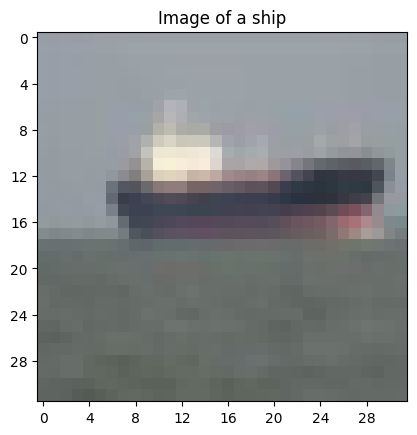

In [21]:
sample_image, label = train_dataset_eda[69]
plt.title(f"Image of a {CLASSES[label]}")
plt.imshow(sample_image.cpu().squeeze().numpy())
plt.xticks(range(0, sample_image.shape[0], 4))
plt.yticks(range(0, sample_image.shape[1], 4))
plt.show()

#### Dataset Split Overview
I examined the split between the training and testing datasets, revealing a balanced distribution of 50,000 images for training and 10,000 images for testing.


Training Images: 50000
Testing Images: 10000



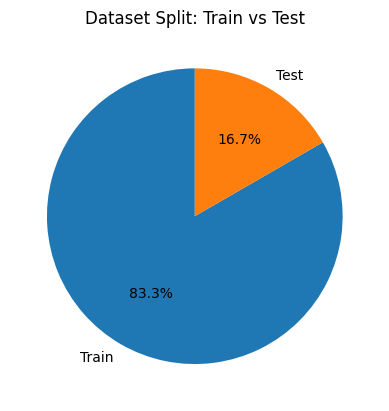

In [22]:
split = [len(train_dataset_eda),len(test_dataset_eda)]
train_test = ["Train", "Test"]
print(f"""
Training Images: {split[0]}
Testing Images: {split[1]}
""")
plt.pie(split, labels=train_test, autopct='%1.1f%%', startangle=90)

plt.title('Dataset Split: Train vs Test')
plt.show()

#### Class Distribution in Train and Test Sets
I analyzed the distribution of classes in both the training and testing sets, confirming a well-balanced distribution across all classes.

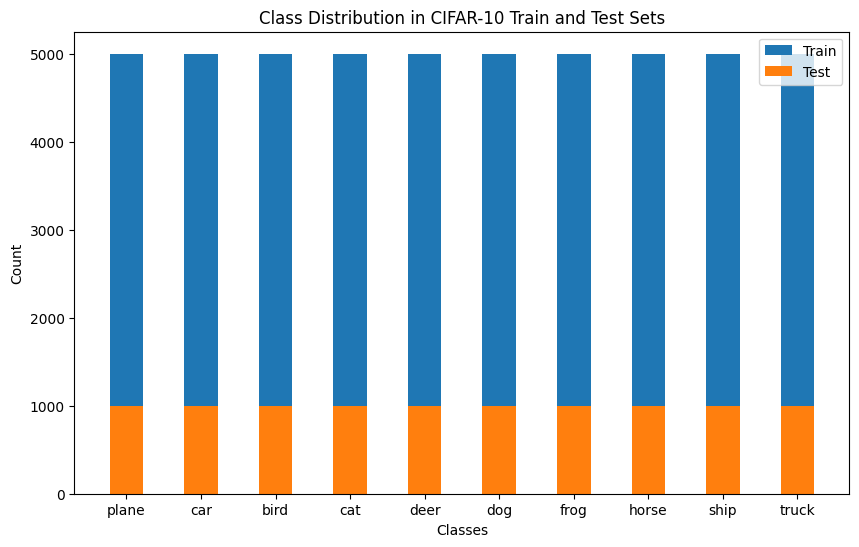

In [23]:
train_counts = {k: 0 for k in CLASSES}
test_counts = {k: 0 for k in CLASSES}

for _, labels in train_dataset_eda:
    class_name = CLASSES[labels]
    train_counts[class_name] += 1

for _, labels in test_dataset_eda:
    class_name = CLASSES[labels]
    test_counts[class_name] += 1

fig, ax = plt.subplots(figsize=(10, 6))

plt.bar(range(len(CLASSES)), train_counts.values(), 0.45, label='Train')
plt.bar(range(len(CLASSES)), test_counts.values(), 0.45, label='Test')

plt.xlabel('Classes')
plt.ylabel('Count')
plt.title('Class Distribution in CIFAR-10 Train and Test Sets')
plt.xticks(range(len(CLASSES)), CLASSES)
plt.legend()
plt.show()

#### Overview of Class Images
I provided an overview of images from each class in the training dataset, offering a visual representation of the distinct classes.

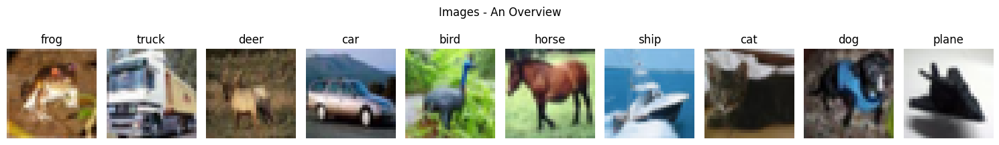

In [24]:
class_images = {k: None for k in range(len(CLASSES))}
fig, axes = plt.subplots(1, len(CLASSES), figsize=(15, 6))
i = 0
for images, labels in train_dataset_eda:
    if class_images[labels.item()] is None:
        axes[i].imshow(images.cpu().squeeze().numpy())
        axes[i].set_title(CLASSES[labels.item()])
        axes[i].axis('off')

        i+=1
        class_images[labels.item()] = True
fig.suptitle("Images - An Overview")
plt.tight_layout()
fig.subplots_adjust(top=1.5)
plt.show()

#### Averaging Classes
I calculated the average image for each class in the training dataset, providing a visual representation of the rough outlines for the car, horse, and truck classes.

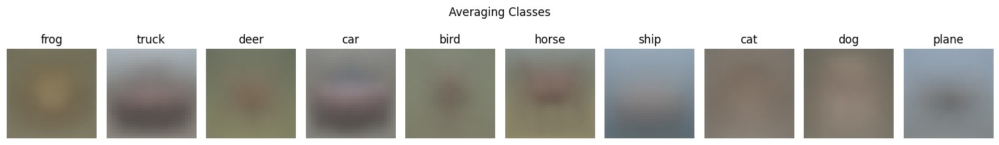

In [25]:
class_averages = {}
class_counts = {}

for data, target in train_dataset_eda:
    target = target.item()
    if target not in class_averages:
        class_averages[target] = torch.zeros_like(data)
        class_counts[target] = 0

    class_averages[target] += data
    class_counts[target] += 1

i = 0
fig, axes = plt.subplots(1, len(CLASSES), figsize=(15, 6))

for key in class_averages.keys():
    img = (class_averages[key] / class_counts[key]) / 255
    axes[i].imshow(img.cpu().squeeze().numpy())
    axes[i].set_title(CLASSES[key])
    axes[i].axis('off')
    i+=1
fig.suptitle("Averaging Classes")
plt.tight_layout()
fig.subplots_adjust(top=1.5)

In [26]:
IMAGE_SIZE = 32     # image size, number of pixel, assuming square image (length = width)
CHANNELS = 3        # number of channels, which in our case is 3, because RGB
NUM_CLASS = 10      # number of classes, which in cifar-10, is 10
TRAIN_BATCH_SIZE = 512 # Adjust based on how powerful GPU is, 2048 for RTX 4090 but 512 for P100
CLASSES = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

## 📊 Metrics: Precision and Creativity

GANs are notoriously difficult to score. Evaluating the effectiveness of GAN is still an area of ongoing research and new techniques are still being found. Hoewever, there are still some commonly used metrics which could help us gauge a model's performance here. 

### Inception Score (higher is better)

This metric makes use of the Inception V3 model to generate a softmax probability distribution of a given image. For context, Inception V3 is a classification model training on the ImageNet dataset which has 1000 classes. 

![inception](https://miro.medium.com/v2/resize:fit:1400/1*X29oOi1Tzch2j6MuG9XS1Q.png)

When we input an image into the model, it generates a probability distribtuion indicating which class the image is more likely to belong to. 

![sum](https://miro.medium.com/v2/resize:fit:2000/1*23gj_d3dxfm5FoKae_pc5Q.png) 

We then compare the distribution to get the Inception Score to a marginal distribution. The way this is done is using somthing called KL divergence. 

![kl](https://miro.medium.com/v2/resize:fit:2000/format:webp/1*hPEJY3MkOZyKFA6yEqzuyg.png) 

If a image is not very clear or badly generated, the idea is that the softmax probability distribution will be more uniform. On the other hand when the image is very clear, it will be less uniform and concentrated around a certain label, say Dog. 


### Fréchet Inception Distance (lower the better)

FID builds on the Inception score and make it even better. Rather than just analysing the distribution of the generated imaged, FID, compares the distirbution of the real images and fake images using Fréchet Distance. Unlike, the Inception Score, rather than using the final layer softmax probabilities, the activations of the final pooling layers are used to extract high level semantic information about the characteristics of an image.  

![imag](https://machinelearningmastery.com/wp-content/uploads/2019/06/Example-of-How-Increased-Distortion-of-an-Image-Correlates-with-High-FID-Score.png)

Here, if the generated images are closer to the actual images, it suggests that they are very realistic, resulting in a lower score. Therefore, the lower FID suggests higher quality images. 

### Kernel Inception Distance (lower the better)

KID was introduced to address some of the bias present in FID, especially for small datasets. Rather than using Fréchet Distance to compare two distributions, KID uses Maximum Mean Discrepancy instead. 

The following is an excerpt from a paper on [Evaluation of Generative Models](https://arxiv.org/pdf/2206.10935.pdf)

> The Kernel Inception Distance (KID) [16] aims to improve on FID by relaxing the Gaussian assumption. KID measures the squared Maximum Mean Discrepancy (MMD) between the Inception
representations of the real and generated samples using a polynomial kernel. This is a non-parametric
test so it does not have the strict Gaussian assumption, only assuming that the kernel is a good
similarity measure. It also requires fewer samples as we do not need to fit the quadratic covariance
matrix.

Since our CIFAR-10 dataset is a relatviely smaller dataset, we feel that KID is a more suitable metric for this project. But we will use both FID and KID for completeness.


### Torch Metric

To use KID in our project, we will be using the Torchmetric library which provides a fast and precise wasy of calculating all the metrics mentioned here. 

Based on online data, these are the best possible scores our model can get. 

| Metric                      | Value                |
|-----------------------------|----------------------|
| Frechet Inception Distance  | 3.14               |
| Kernel Inception Distance   | ≈ 0                  |

These scores will help us gauge how close our model is to the best possible score.

In [27]:
import PIL.Image as Image
fid_metric = FrechetInceptionDistance(feature=2048, reset_real_features=False).to(device)
kid_metric = KernelInceptionDistance(feature=2048, reset_real_features=False).to(device)

transform = transforms.Compose([
                            transforms.Resize((299, 299), Image.BILINEAR,antialias=True),
                        ])

for batch in tqdm(train_loader):
        real_images = batch[0].to(device)
        real_images = transform(real_images)
        #real_images = torch.stack([transform(img) for img in real_images]).to(device)
        real_images = real_images * 255
        real_images = real_images.to(torch.uint8)
        fid_metric.update(real_images, real=True)
        kid_metric.update(real_images, real=True)
        del real_images, batch
        torch.cuda.empty_cache()


Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:01<00:00, 57.4MB/s]
100%|██████████| 98/98 [01:14<00:00,  1.32it/s]


## 🤖 Beep Boop! GAN Comes to Life

The CIFAR-10 dataset presents a unique challenge due to its diverse set of 10 classes. A vanilla GAN trained on such a dataset would generate images that blend all classes, resulting in incomprehensible outputs. To address this limitation and gain better control over image generation, we turn to a more sophisticated approach – Conditional GAN (cGAN). The concept of cGAN was introduced in the research paper by Mirza, M. and Osindero, S. (2014) and we will drawing inspiration from it.

### Why cGAN?

1. **Class-Specific Generation:**
   - Vanilla GANs mix all classes during training, leading to ambiguous outputs.
   - cGAN allows us to input a class label ($y$) into both the discriminator ($D$) and generator ($G$), enabling class-specific image generation.

2. **Conditional Input:**
   - In cGAN, the label $y$ serves as a condition for both $D$ and $G$, influencing the generation process.
   - Mathematically, this is represented as $G(z|y)$, indicating that the generator takes a vector $z$ as input, given the condition $y$.

### How cGAN Works:

- **Model Architecture:**
  - Both the generator and discriminator receive the class label ($y$) as an additional input beside the random noise ($z$) and image ($x$), as illustrated below.

  ![Conditional GAN Architecture](https://www.taskus.com/wp-content/uploads/2023/10/image.png)

- **Training Objective:**
  - By incorporating the class label during training, the cGAN learns to distinguish and generate images specific to the input class.


- **Our Modifications**

    We will be using the following suggested modifications from a [paper on Deep Convolutional GAN](https://arxiv.org/pdf/1511.06434v2.pdf)

> - Replacing any pooling layers with strided convolutions (discriminator) and fractional-strided convolutions (generator).
     - Using batchnorm in both the generator and the discriminator.
     - Removing fully connected hidden layers for deeper architectures.
     - Using ReLU activation in generator for all layers except for the output, which uses tanh.
     - Using LeakyReLU activation in the discriminator for all layer.


In [40]:
# Generator architecture
class SimpleGenerator(nn.Module):
    def __init__(self, latent_dim, hidden_dim):
        super(SimpleGenerator, self).__init__()
        
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        
        self.input_layers = nn.Sequential(
            nn.Linear(latent_dim + NUM_CLASS, hidden_dim*2),
            nn.Linear(hidden_dim*2, hidden_dim),
            nn.LeakyReLU(0.1, inplace=True)
        )

        self.conv_layers = nn.Sequential(
            nn.ConvTranspose2d(int(hidden_dim/4), 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(32, CHANNELS, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(CHANNELS),
            nn.LeakyReLU(True),
        
            nn.Tanh()
        )
    
    def forward(self, noise, classes):
        inputs = torch.cat((classes, noise), 1)
        outputs = self.input_layers(inputs)
        reshape_shape = int(self.hidden_dim/4)
        outputs = torch.reshape(outputs, (outputs.size()[0], reshape_shape, 2, 2))
        return self.conv_layers(outputs)

Here, instead of adding the label embeddings into the input image, I will concatenate it to the intermediate representation.

In [41]:
# Discriminator architecture

class SimpleDiscriminator(nn.Module):
    def __init__(self):
        super(SimpleDiscriminator, self).__init__()
        
        self.conv_layers = nn.Sequential(
            nn.Conv2d(CHANNELS, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
        
            nn.AvgPool2d(2, stride=2)
        )
        
  
        self.output_layers = nn.Sequential(
            nn.Linear(256 + NUM_CLASS, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )
    
    def forward(self, x, labels):
        output = self.conv_layers(x).squeeze()
        x = torch.cat((output,labels), dim=1)
        x = self.output_layers(x)
        return x

### Model

The cGAN class has the architecture of a Conditional Generative Adversarial Network

#### Architecture:
- The cGAN integrates a discriminator and a generator
- Following GAN princples, these two models will compete to fool each other

#### Training:
- The cGAN engages in adversarial training, where the generator learns to produce realistic images, and the discriminator learns to distinguish between real and generated samples.
- Separate optimizers are defined for the generator and discriminator.
- Optimizers also can have different learning rates

#### Conditioning
- The generator is tasked with producing synthetic images based on random noise and provided class labels.
-  While there are many methods of conditioning, for our base model we decided to go ahead with simple concatenation

#### Loss

- In the original implementation of Minimax loss the authors has observed problems in the early stages of GAN training. To combat this we can use the modified BCELoss.

In [42]:
class cGAN(nn.Module):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__()
        
        self.discriminator = discriminator.apply(self.init_weight)
        self.generator = generator.apply(self.init_weight)
        
        self.g_opt = optim.Adam(self.generator.parameters(), 
                               lr=0.0002, betas=(0.5, 0.999), 
                               weight_decay=2e-5)
        
        self.d_opt = optim.Adam(self.discriminator.parameters(), 
                               lr=0.0002, betas=(0.5, 0.999), 
                               weight_decay=2e-5)
        
        self.fid_metric = fid_metric
        self.kid_metric = kid_metric
        
        self.loss = nn.BCELoss()
        
        self.disc_scores, self.gen_scores, self.fid_scores = [], [], []
        self.kid_scores, self.fid_epochs = [], []

        self.best_model = None
        self.best_score = 1000
        
    def init_weight(self,layer):
        name = layer.__class__.__name__
        
        if name.find("BatchNorm") != -1:
            nn.init.normal_(layer.weight, 1.0, 0.02)
            nn.init.zeros_(layer.bias)
            
        if name.find("Conv") != -1:
            nn.init.normal_(layer.weight, 0.0, 0.02)
            
    def gen_step(self,img,label):
        self.g_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        
        fake_imgs = self.generator(noise, label)
        fake_pred = self.discriminator(fake_imgs, label)
        
        real_label = torch.ones((img.size()[0], 1), device=device)
        
        g_loss = self.loss(fake_pred, real_label)
        
        g_loss.backward()
        self.g_opt.step()
        
        return g_loss.cpu().item()
    
    def disc_step(self,img,label):
        self.d_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred = self.discriminator(fake_imgs, label)
        real_pred = self.discriminator(img, label)
        
        fake_label = torch.zeros((img.size()[0], 1), device=device)
        real_label = torch.ones((img.size()[0], 1), device=device)
    
        d_loss = (self.loss(fake_pred, fake_label) + self.loss(real_pred, real_label)) / 2
        
        d_loss.backward()
        self.d_opt.step()
        
        return d_loss.cpu().item()
    
    def fit(self, epochs, train_loader):
        print(f"Training {self.__class__.__name__} for {epochs} Epochs")

        self.discriminator.train()
        self.generator.train()
        
        for epoch in range(epochs):
            
            disc_losses, gen_losses = [], []
             
            progress = tqdm(train_loader, desc=f'Training Epoch {epoch + 1}/{epochs}', leave=True, colour="green", dynamic_ncols=True)
            for img, label in  progress:
                
                disc_loss = self.disc_step(img, label)
                gen_loss = self.gen_step(img, label)
                
                disc_losses.append(disc_loss)
                gen_losses.append(gen_loss)
                
                progress.set_postfix(disc_loss=disc_loss, gen_loss=gen_loss)
                
            self.disc_scores.append(np.mean(disc_losses))
            self.gen_scores.append(np.mean(gen_losses))
            
            self.on_epoch_end(epoch)

    def on_epoch_end(self, epoch):
        
        if epoch%20 == 0:
                fid,kid = self.get_fid_kid()
                self.fid_epochs.append(epoch)
                self.fid_scores.append(fid)
                self.kid_scores.append(kid)
                print(f"FID: {fid}, KID: {kid}")
                
        if epoch%50 == 0:
                img, label = self.generate_samples(10)
                self.display_images(img, label)
                img, label = self.generate_samples(10)
                self.display_images(img, label)
    
    def generate_samples(self,n):
        self.generator.eval()
        
        noise = torch.normal(0, 1, (n, self.generator.latent_dim), device=device)

        random_indices = torch.randint(0, 10, size=(n,), device = device)

        sample_classes = torch.eye(10, device = device)[random_indices]

        generated_imgs = self.generator(noise, sample_classes)
        generated_imgs = (generated_imgs.cpu().detach().permute(0, 2, 3, 1).numpy() - (-1)) / (1 - (-1))   # scale from [-1, 1] to [0, 1]
        
        return generated_imgs, sample_classes
            
    def get_fid_kid(self):
        
        self.fid_metric.reset()
        self.kid_metric.reset()
        
        for _ in tqdm(range(10000//TRAIN_BATCH_SIZE)):
            with torch.no_grad():
                latent_space = torch.normal(
                    0, 1, (TRAIN_BATCH_SIZE, self.generator.latent_dim), device=device, requires_grad=False)
                
                gen_labels = torch.randint(
                    0, 10, (TRAIN_BATCH_SIZE,), device=device, requires_grad=False)
                gen_labels = torch.nn.functional.one_hot(gen_labels, 10)

                fake_imgs = self.generator(latent_space, gen_labels)
                
                fake_imgs = torch.tensor(fake_imgs).to(device)
                fake_imgs = transform(fake_imgs)
                fake_imgs = (fake_imgs * 255).to(torch.uint8)
                
                self.fid_metric.update(fake_imgs, real=False)
                self.kid_metric.update(fake_imgs, real=False)
            
        fid = self.fid_metric.compute().cpu().numpy()
        kid = self.kid_metric[0].compute().cpu().numpy()

        if fid < self.best_score:
            self.best_score = fid
            self.best_model = [self.generator, self.discriminator]
        
        return fid, kid
    
    def display_images(self, imgs, labels):
        
        num_cols = 5
        num_rows = (10 + num_cols - 1) // num_cols
    
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 6))
        axs = axs.flatten()

        for i in range(10):
            axs[i].imshow(imgs[i])
            class_index = labels[i].nonzero().item()

            axs[i].set_title(CLASSES[class_index])
            axs[i].axis('off')

        plt.tight_layout()
        plt.show() 
    
    def save(self, name=None):
        time_post = int(time.time())
        if name is None:
            torch.save(self.generator,f"{self.__class__.__name__}-gen_{time_post}.pt")
            torch.save(self.discriminator,f"{self.__class__.__name__}-disc_{time_post}.pt")

            best_gen, best_disc = self.best_model
            torch.save(self.generator,f"{self.__class__.__name__}-best_gen_{time_post}.pt")
            torch.save(self.discriminator,f"{self.__class__.__name__}-best_disc_{time_post}.pt")
            
        else:
            torch.save(self.generator,f"{name}-gen_{time_post}.pt")
            torch.save(self.discriminator,f"{name}-disc_{time_post}.pt")
            
            best_gen, best_disc = self.best_model
            torch.save(self.generator,f"{name}-best_gen_{time_post}.pt")
            torch.save(self.discriminator,f"{name}-best_disc_{time_post}.pt")
    

For subsequency models, I will be inheriting from this class and overidding the required methods.

Training cGAN for 501 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 108.72743225097656, KID: 0.1169365644454956


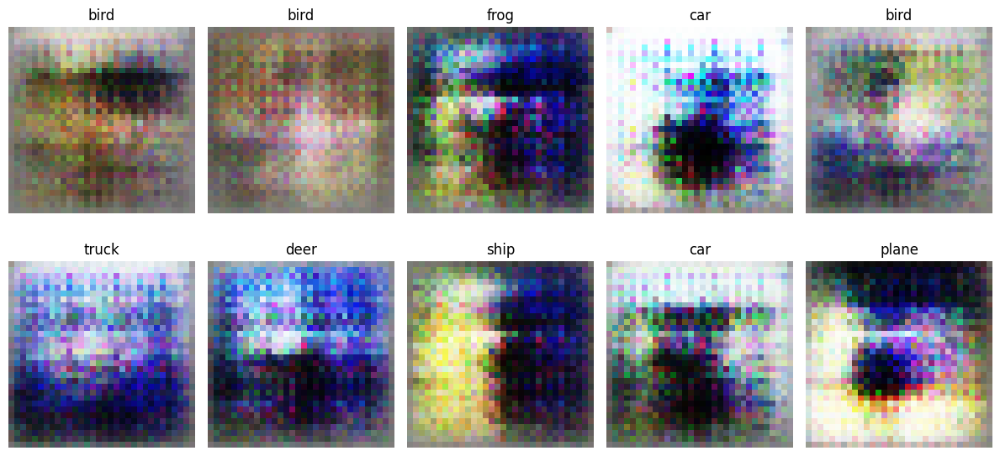

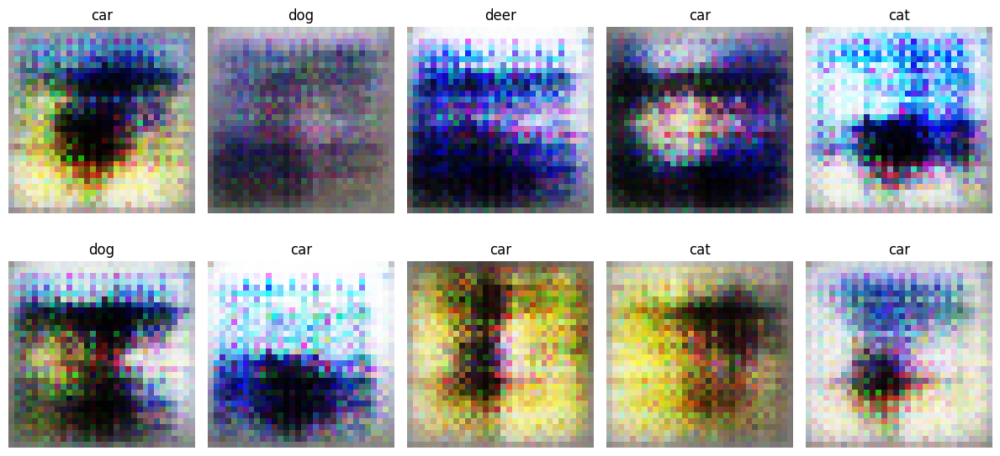

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.00499725341797, KID: 0.041580237448215485


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.55277633666992, KID: 0.04315266013145447


Training Epoch 51/501: 100%|██████████| 98/98 [00:02<00:00, 45.26it/s, disc_loss=0.111, gen_loss=2.83] 


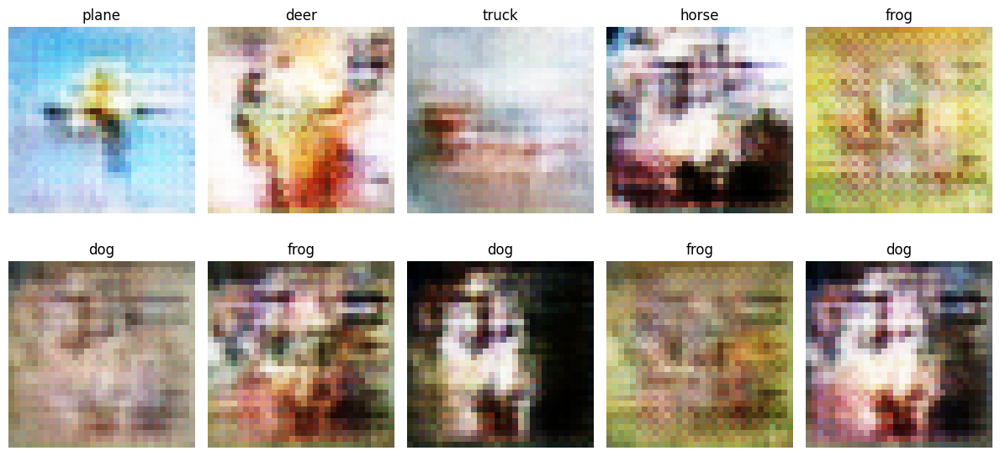

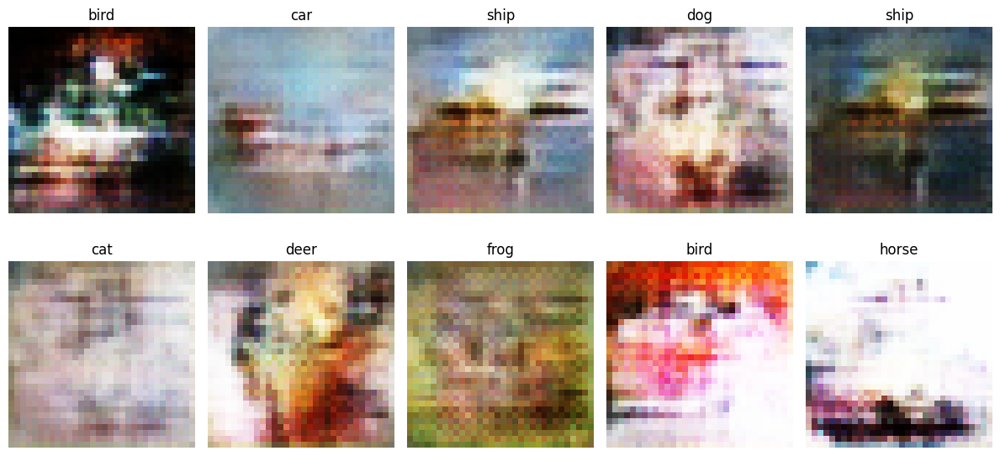

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 64.534423828125, KID: 0.04101591184735298


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 54.90828323364258, KID: 0.03475838154554367


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 69.50497436523438, KID: 0.04874425008893013


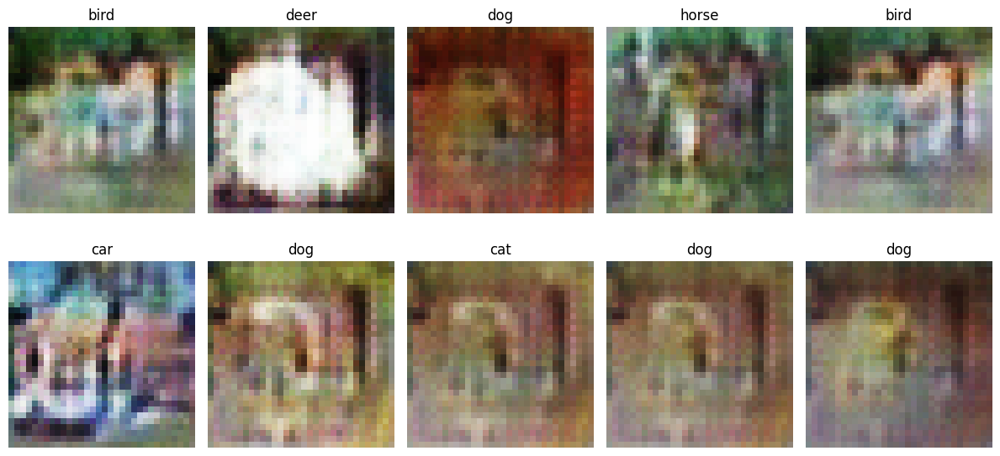

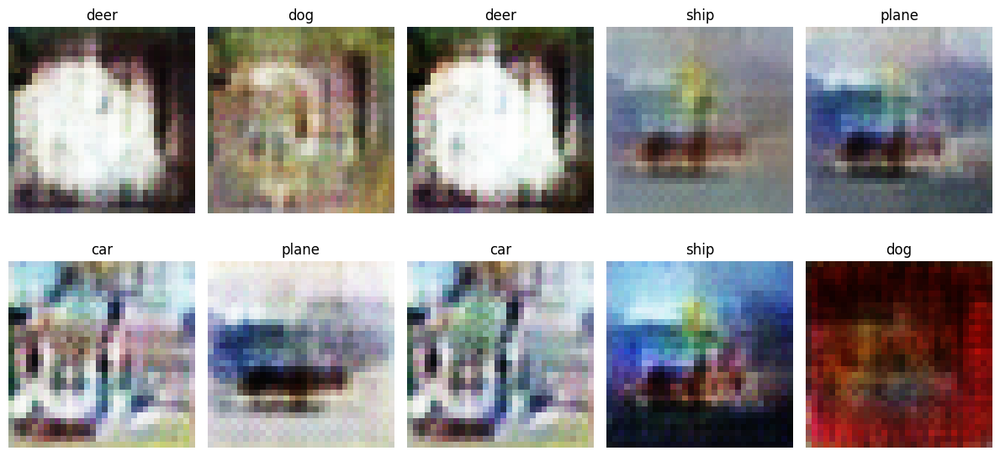

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 57.43680191040039, KID: 0.030427144840359688


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 77.4580307006836, KID: 0.04872879758477211


Training Epoch 151/501: 100%|██████████| 98/98 [00:02<00:00, 46.83it/s, disc_loss=0.106, gen_loss=5.52] 


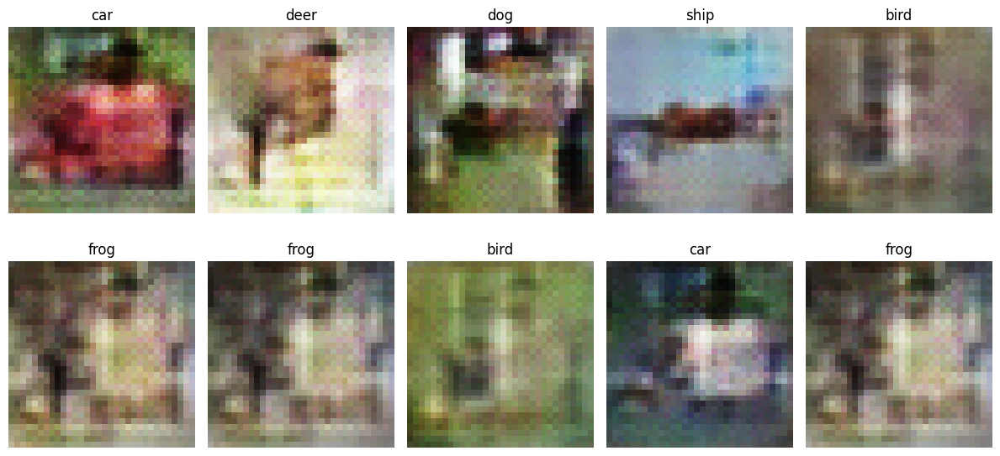

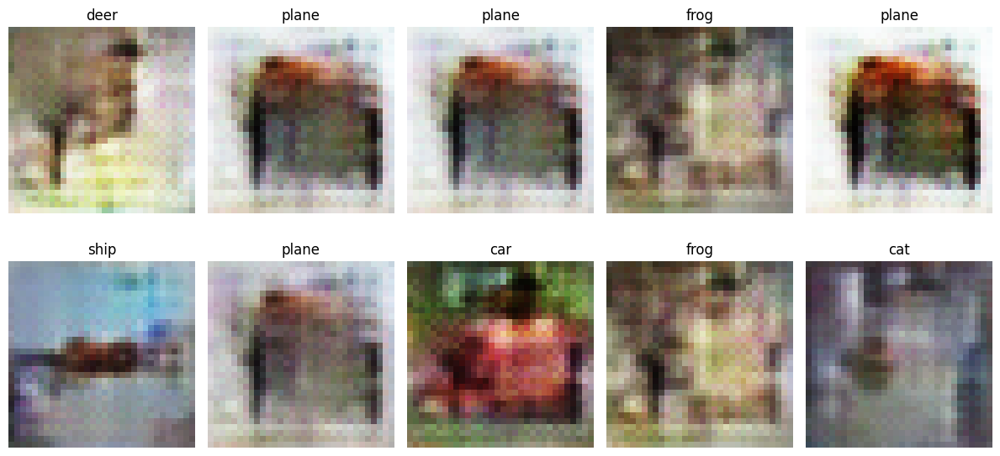

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 87.05989837646484, KID: 0.0632399395108223


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 62.692684173583984, KID: 0.031642768532037735


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 73.3487777709961, KID: 0.044249050319194794


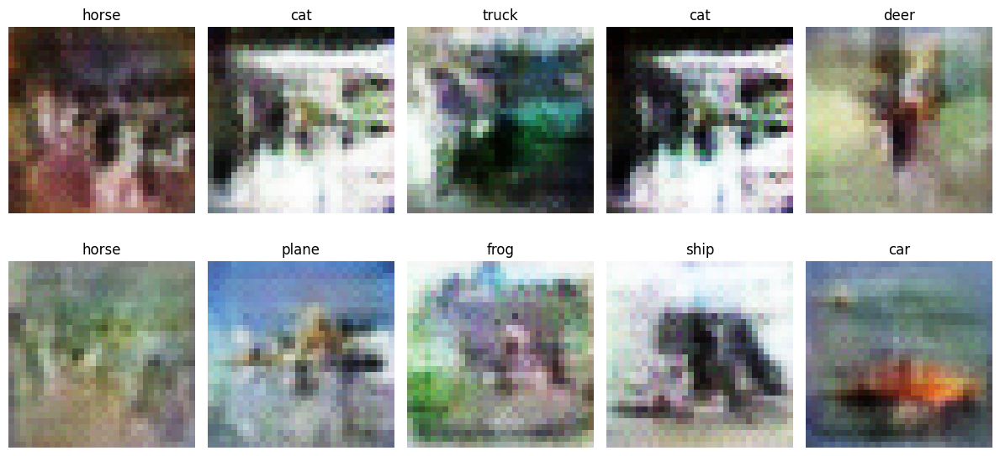

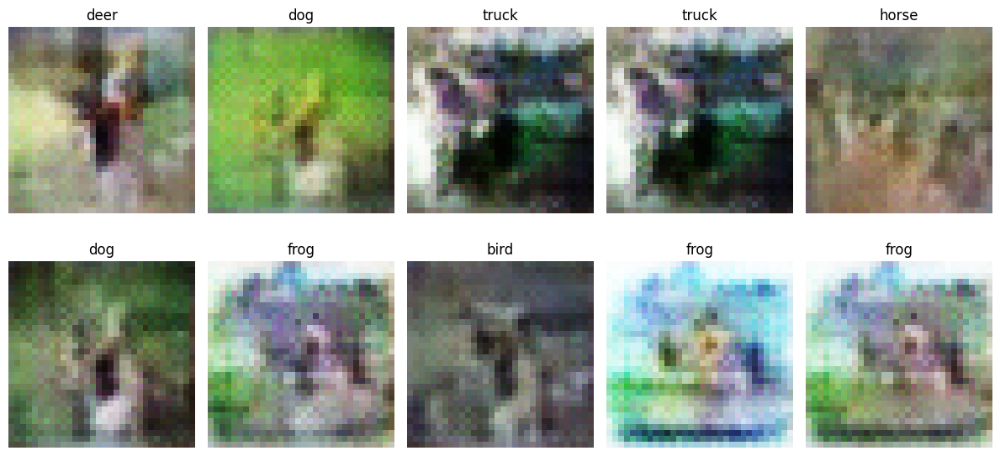

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 68.39086151123047, KID: 0.035694729536771774


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 82.64505004882812, KID: 0.05528467893600464


Training Epoch 251/501: 100%|██████████| 98/98 [00:02<00:00, 45.17it/s, disc_loss=0.217, gen_loss=6.57] 


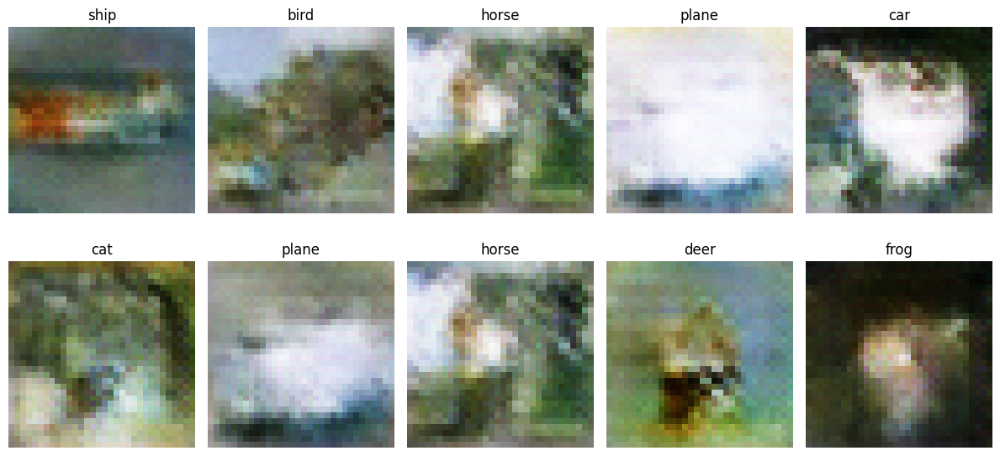

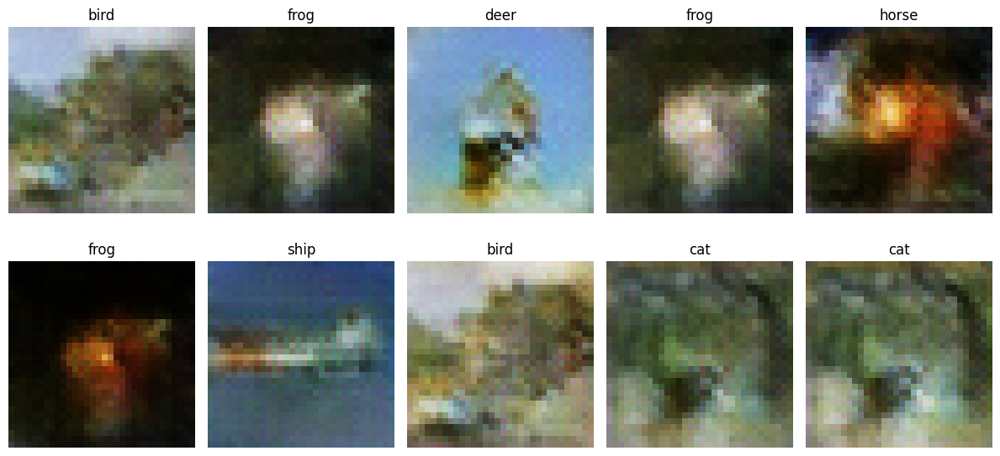

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 64.75682067871094, KID: 0.034916024655103683


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.88471221923828, KID: 0.034934282302856445


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 69.01610565185547, KID: 0.03959473595023155


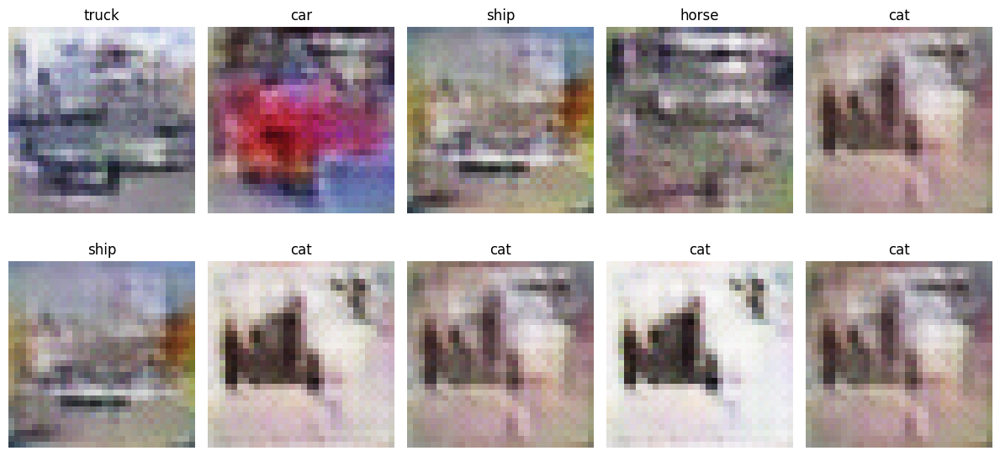

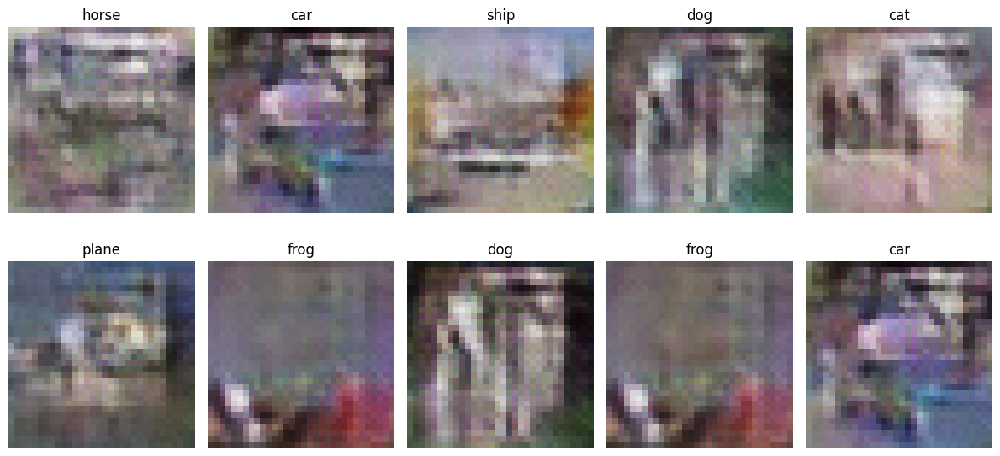

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 79.71592712402344, KID: 0.045825861394405365


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 70.9151611328125, KID: 0.040683142840862274


Training Epoch 351/501: 100%|██████████| 98/98 [00:02<00:00, 43.15it/s, disc_loss=0.0727, gen_loss=5.18]


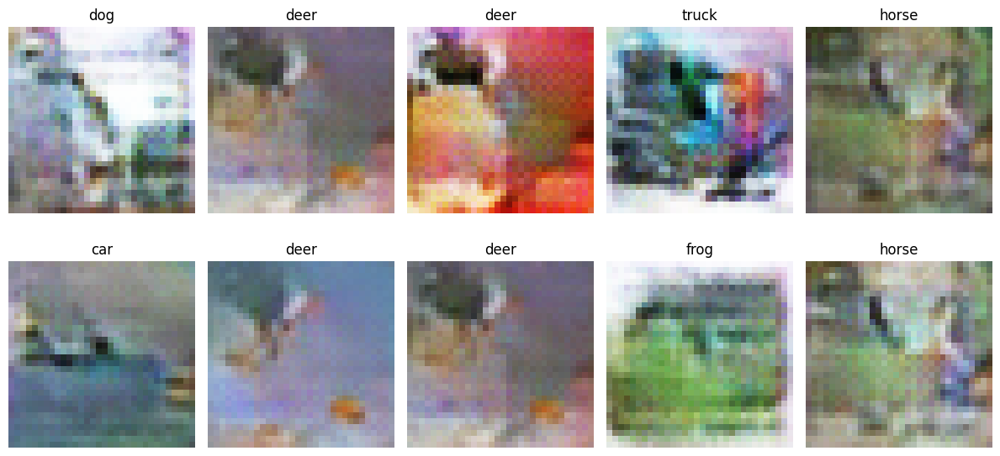

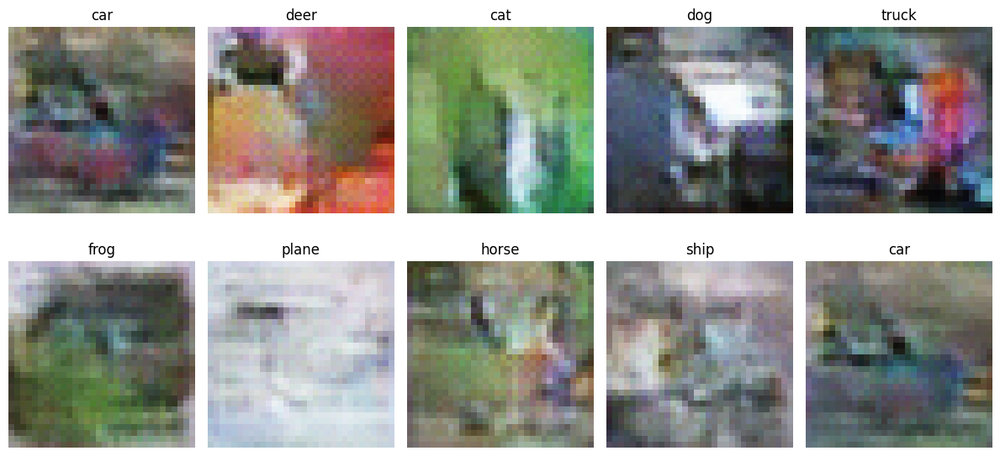

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 69.93022155761719, KID: 0.03374826908111572


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 68.84089660644531, KID: 0.03525520861148834


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 68.9583511352539, KID: 0.04055214673280716


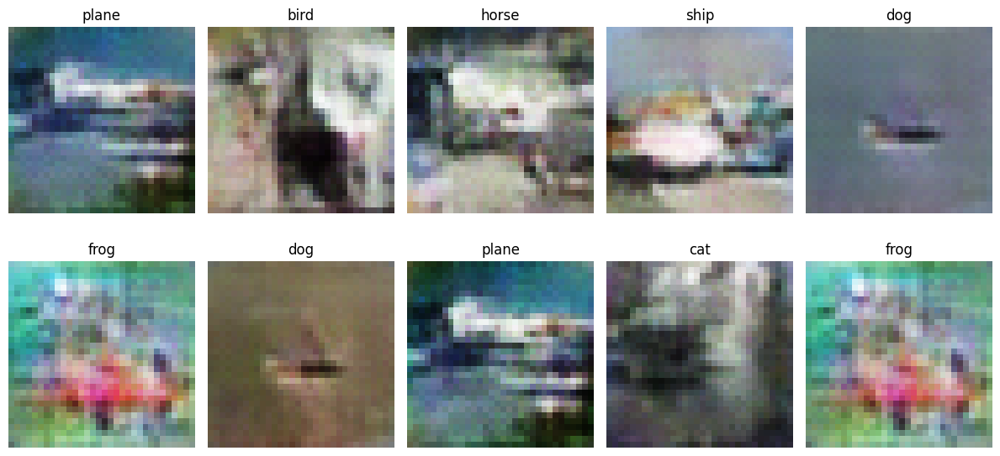

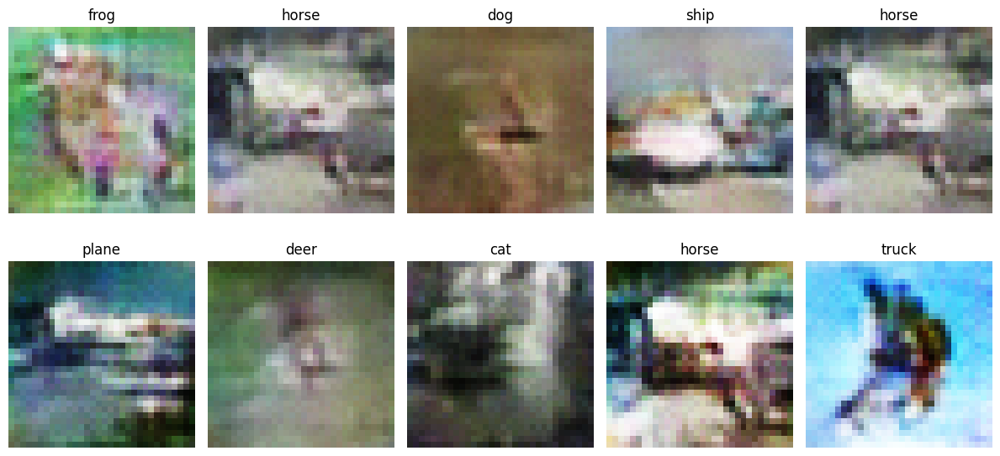

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 65.97594451904297, KID: 0.037072453647851944


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 72.26649475097656, KID: 0.03805358707904816


Training Epoch 451/501: 100%|██████████| 98/98 [00:02<00:00, 46.15it/s, disc_loss=0.359, gen_loss=0.975] 


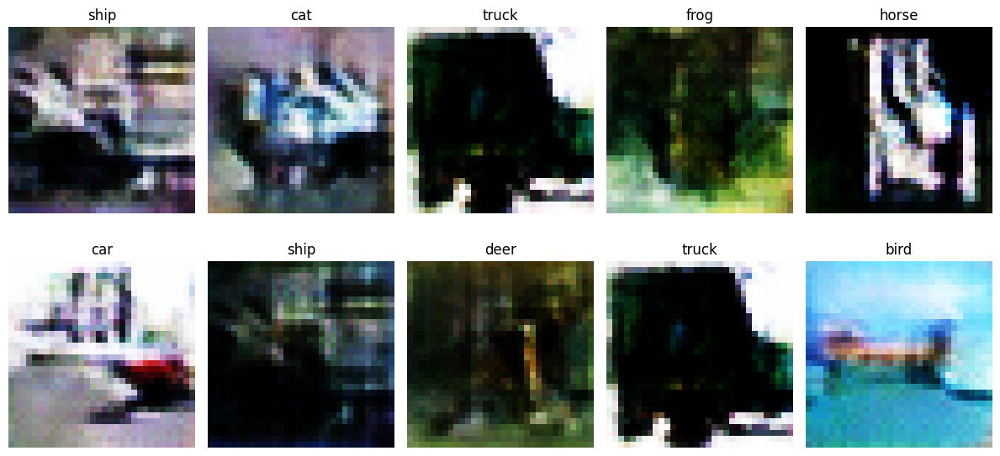

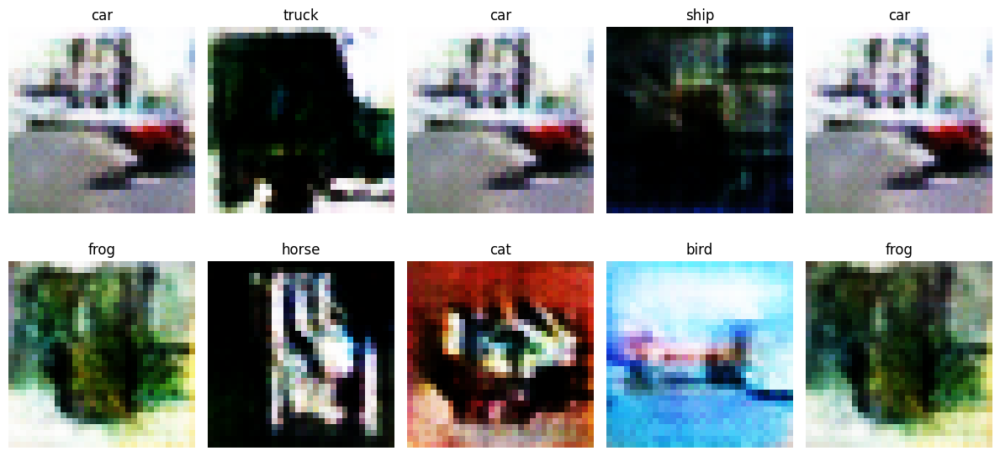

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.31888961791992, KID: 0.030933653935790062


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 66.50039672851562, KID: 0.03389844670891762


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 75.39200592041016, KID: 0.03671291843056679


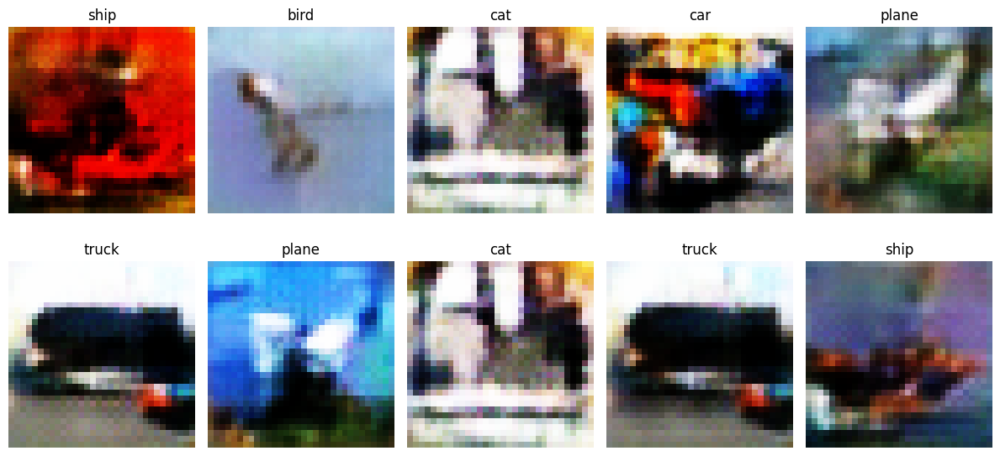

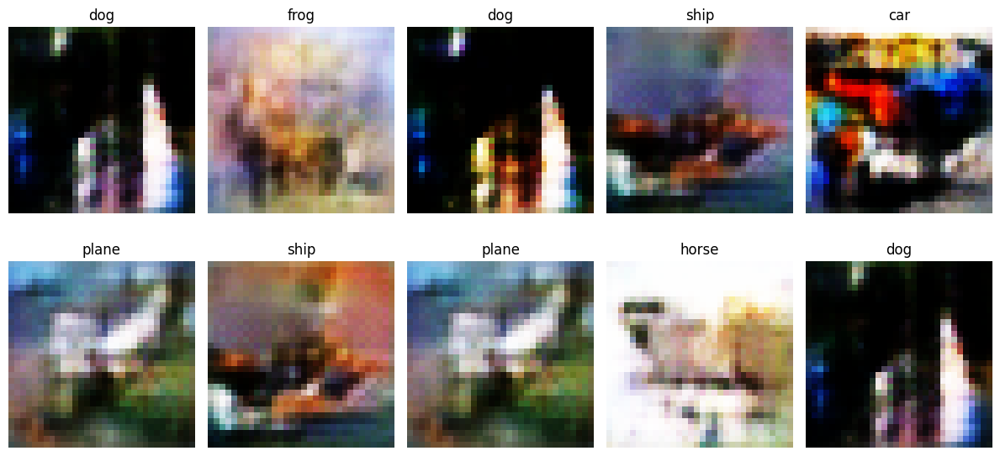

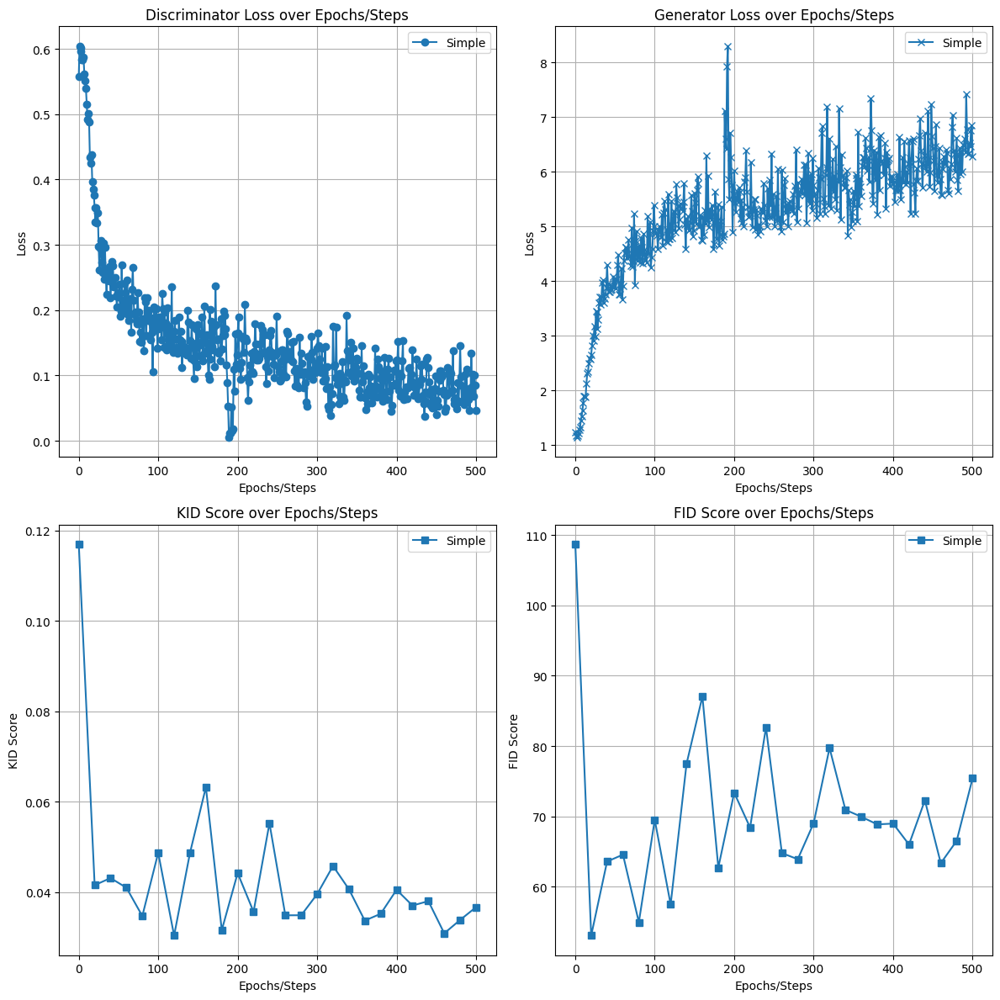

<Figure size 1200x600 with 0 Axes>

In [43]:
gen_simple = SimpleGenerator(128,1024).to(device)
disc_simple = SimpleDiscriminator().to(device)

cgan = cGAN(gen_simple,disc_simple,train_loader)
cgan.fit(501,train_loader)
plot_losses(501,[(cgan,"Simple")])

cgan.save("cgan-500e-v2")
torch.cuda.empty_cache()

In [ ]:
gen_loaded = torch.load(f"/workspace/cgan-500e-gen_1706658766.pt")
disc_loaded = torch.load(f"/workspace/cgan-500e-disc_1706658766.pt")

cgan = cGAN(gen_loaded,disc_loaded,train_loader)


#### Observations:
- The generated images exhibit decent poor quality and there are many aspects that could be improved. There are quite some artifacts present in the image most likely due to a overlap issue. 
- Regardless of labels, model seems to output very similiar looking images which may suggest mode collapse. 
- Throughout the model's training the generator loss seems to increase alot while the dicriminator loss decreased slowly. This could suggest that the discriminator is getting too strong and resulting in the generator not learning anything meaningful.
- Both the FID and KID are quite unstable reaching a low point around 50. This suggests the model is not improving due to the discriminator overpowering. 


## 🎯 Engineering our Model for Excellence

### Regularisation

To prevent the discriminator from overfitting, we will apply some simple regularisation techniques such as one sided label smoothing and R1 regularisation as discussed in [this article](https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b). Later on we can also experiement with using DiffAugment, Feature matching and Minibatch discrimination if needed.

#### Label Smoothing

In a standard GAN setup, the discriminator is trained to distinguish between real and fake samples. The labels for real samples are set to 1, and those for fake samples are set to 0. However, in practice, this can lead to sharp decision boundaries, making the training more instable.

Label smoothing addresses these challenges by introducing a small amount of noise to the target labels. Instead of using the binary labels 1 and 0, label smoothing replaces them with values slightly less than 1 for real samples and slightly more than 0 for fake samples. A hyperparameter called smoothing factor determines the degree of smoothing that occurs.

This technique can be easily implemented by including an additoning parameter in our TorchGAN loss function.

#### R1 Regularization

R1 Regularization is a technique introduced [in this paper](https://arxiv.org/pdf/1801.04406v4.pdf) to combat overfitting of the discriminator. It introduces a weight penalty term to the loss function that is proportional to the sum of all weights in the model. 

The complete objective function during training is a combination of the original loss function added to the R1 regularization term:

$ \text{Total Loss} = \text{Original Loss} + R1(W) $

During optimization, the model aims to minimize this total loss, striking a balance between fitting the training data and preventing overfitting by penalizing large weights.

There are no official implementations of R1 loss but I did find a [good implementation](https://github.com/ChristophReich1996/Dirac-GAN/blob/a41cebec7c6a8e6c34c3d2ca93cbb85cf366cd0c/dirac_gan/loss.py#L292) which I will use here with some modifications.


### Avoiding Artifacts

Including pairs of upsampling and downsampling could improve our model. As mentioned in [this article](https://distill.pub/2016/deconv-checkerboard/), simply using upsampling could lead to artifacts being present i images due to a overlap issue. Although the article suggests using resizing with nearest neigbours to upsample, we found our that this approach lead to poor results. So we didn't use it.


In [44]:
class R1(nn.Module):
    """
    Implementation of the R1 GAN regularization.
    """

    def __init__(self, gamma):
        """
        Constructor method
        """
        # Call super constructor
        super(R1, self).__init__()
        self.gamma= gamma

    def forward(self, prediction_real: torch.Tensor, real_sample: torch.Tensor) -> torch.Tensor:
        """
        Forward pass to compute the regularization
        :param prediction_real: (torch.Tensor) Prediction of the discriminator for a batch of real images
        :param real_sample: (torch.Tensor) Batch of the corresponding real images
        :return: (torch.Tensor) Loss value
        """
        #real_sample.requires_grad_(True)
        # Calc gradient
        grad_real = torch.autograd.grad(outputs=prediction_real.sum(), inputs=real_sample, create_graph=True)[0]
        # Calc regularization
        regularization_loss: torch.Tensor = self.gamma \
                                            * grad_real.pow(2).view(grad_real.shape[0], -1).sum(1).mean()
        return regularization_loss

In [45]:
def smooth_labels(labels, factor=0.2):
    return labels * (1 - factor) + 0.5 * factor

In [46]:
# Generator architecture
class ResizeGenerator(nn.Module):
    def __init__(self, latent_dim, hidden_dim):
        super(ResizeGenerator, self).__init__()
        
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        
        self.input_layers = nn.Sequential(
            nn.Linear(latent_dim + NUM_CLASS, hidden_dim),
            nn.LeakyReLU(0.1, inplace=True)
        )

        self.conv_layers = nn.Sequential(
            nn.ConvTranspose2d(int(hidden_dim/4), 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(32, CHANNELS, kernel_size=4, stride=2, padding=1, bias=False),
            #nn.Upsample(size=32),
            nn.BatchNorm2d(CHANNELS),
            nn.LeakyReLU(True),
        
            nn.Tanh()
        )
        
        
    def forward(self, noise, classes):
        inputs = torch.cat((classes, noise), 1)
        outputs = self.input_layers(inputs)
        reshape_shape = int(self.hidden_dim/4)
        outputs = torch.reshape(outputs, (outputs.size()[0], reshape_shape, 2, 2))
        return self.conv_layers(outputs)


In [47]:
class R1GAN(cGAN):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__(generator, discriminator, train_loader)

        self.r1_loss = R1(0.2)
    
    def disc_step(self,img,label):
        self.d_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        img.requires_grad = True
        
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred = self.discriminator(fake_imgs, label)
        real_pred = self.discriminator(img, label)
        
        fake_label = smooth_labels(torch.zeros((img.size()[0], 1), device=device))
        real_label = smooth_labels(torch.ones((img.size()[0], 1), device=device))
    
        r1_loss = self.r1_loss(real_pred, img)
        d_loss = (self.loss(fake_pred, fake_label) + self.loss(real_pred, real_label)) / 2
        d_loss = d_loss + r1_loss
        
        self.d_opt.zero_grad()
        d_loss.backward()
        self.d_opt.step()
        
        return d_loss.cpu().item()


Training R1GAN for 501 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 118.98226928710938, KID: 0.10694579780101776


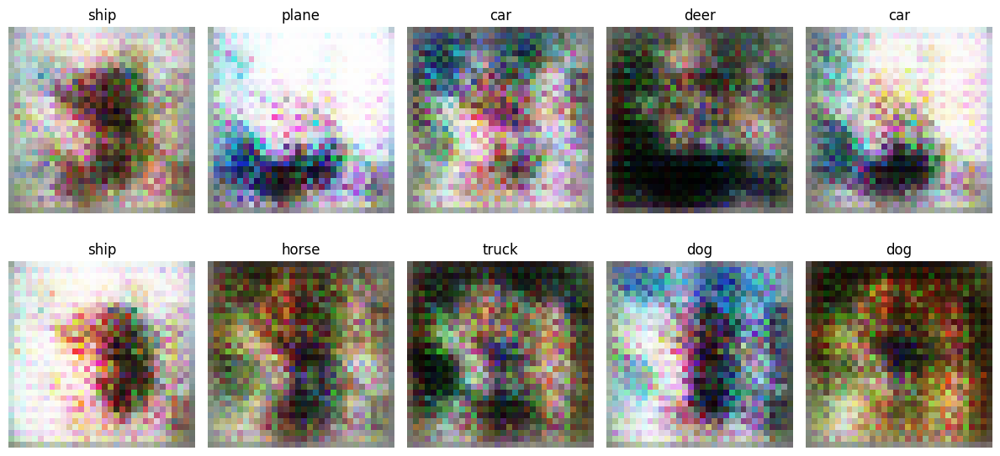

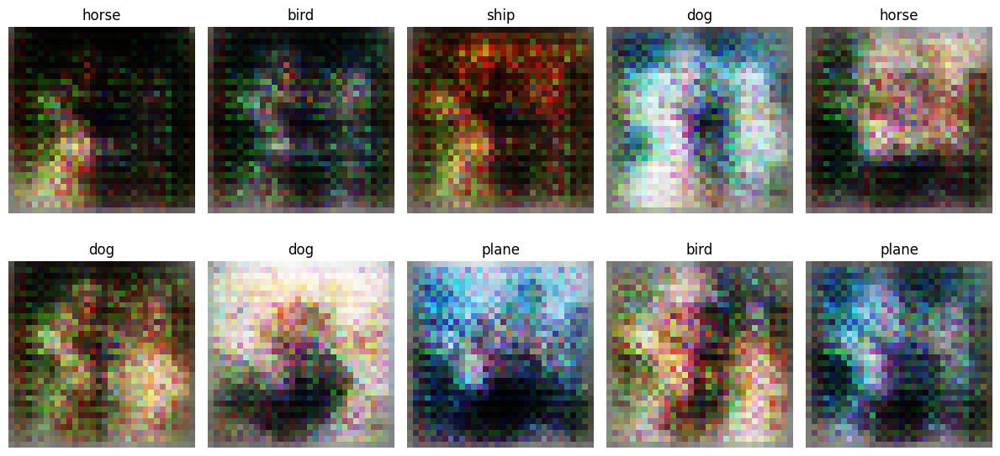

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 65.17433166503906, KID: 0.056415949016809464


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 69.68119812011719, KID: 0.0629037469625473


Training Epoch 51/501: 100%|██████████| 98/98 [00:02<00:00, 42.11it/s, disc_loss=0.379, gen_loss=1.69]


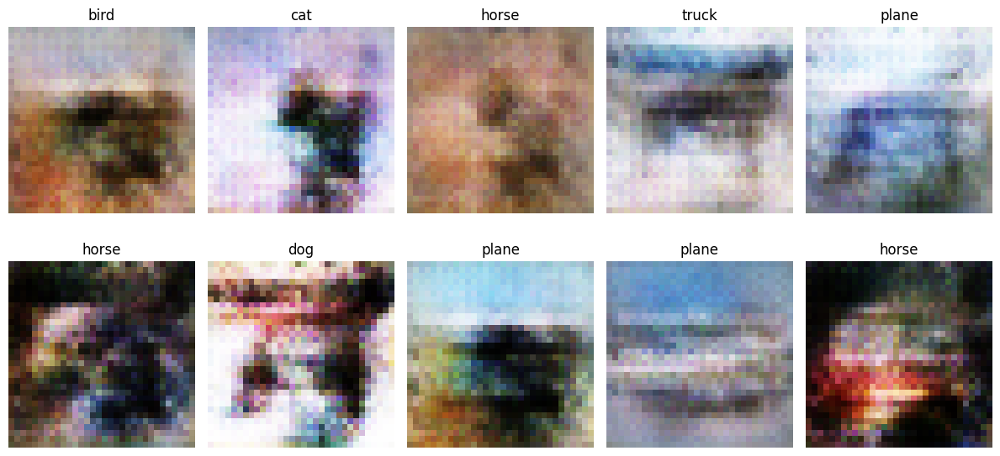

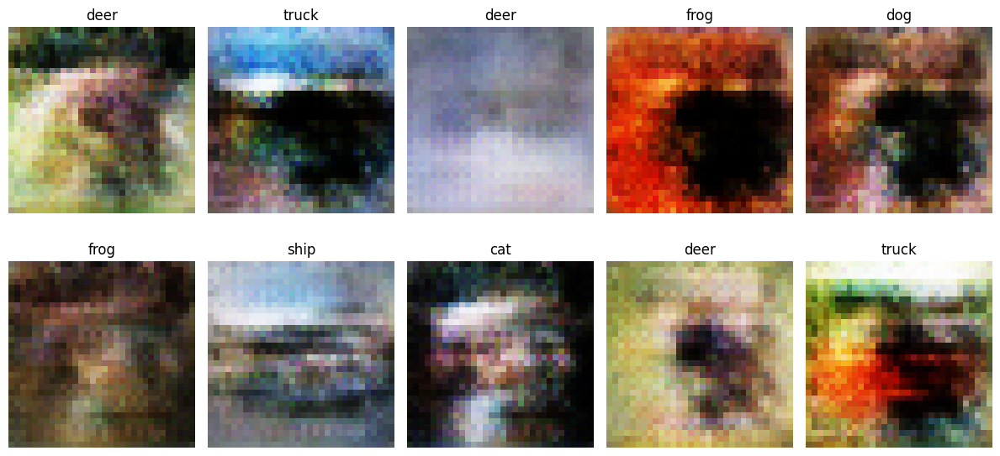

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 64.255859375, KID: 0.0571897029876709


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 54.158607482910156, KID: 0.046451032161712646


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 50.88734436035156, KID: 0.0472293384373188


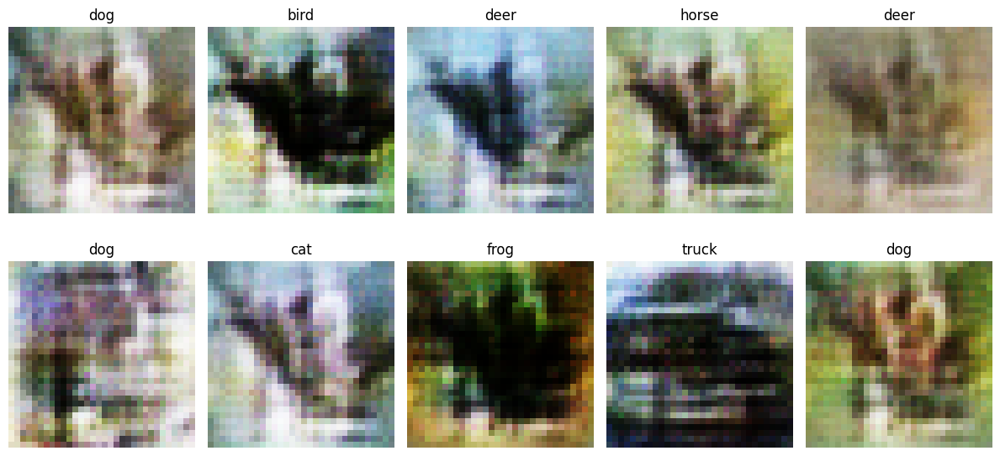

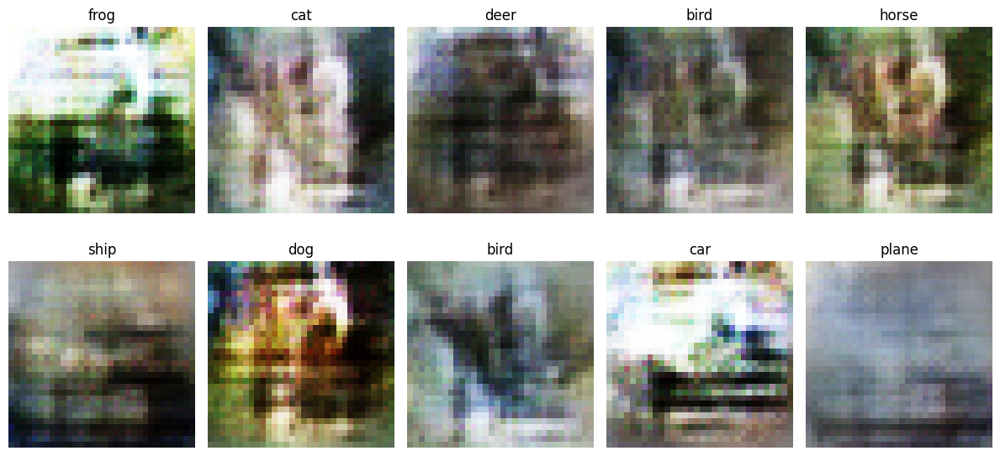

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 54.175872802734375, KID: 0.04654587805271149


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 54.470558166503906, KID: 0.04310765117406845


Training Epoch 151/501: 100%|██████████| 98/98 [00:02<00:00, 40.12it/s, disc_loss=0.411, gen_loss=2.75]


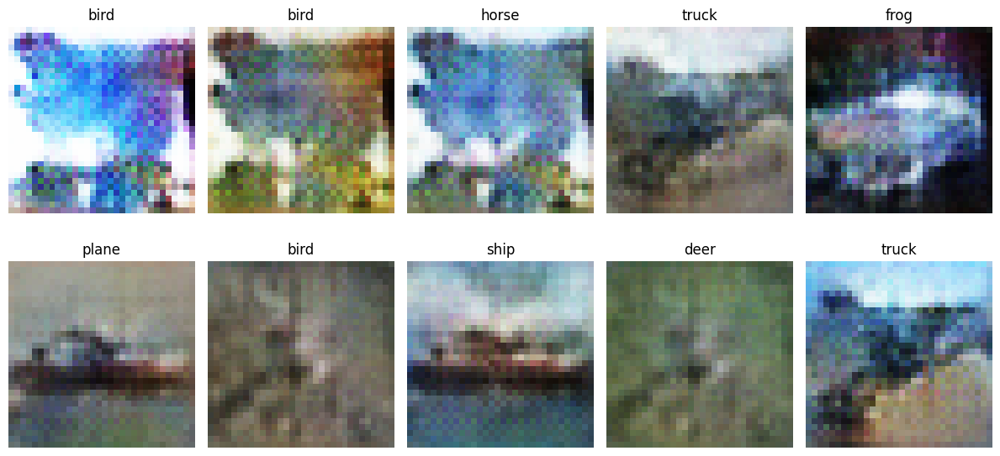

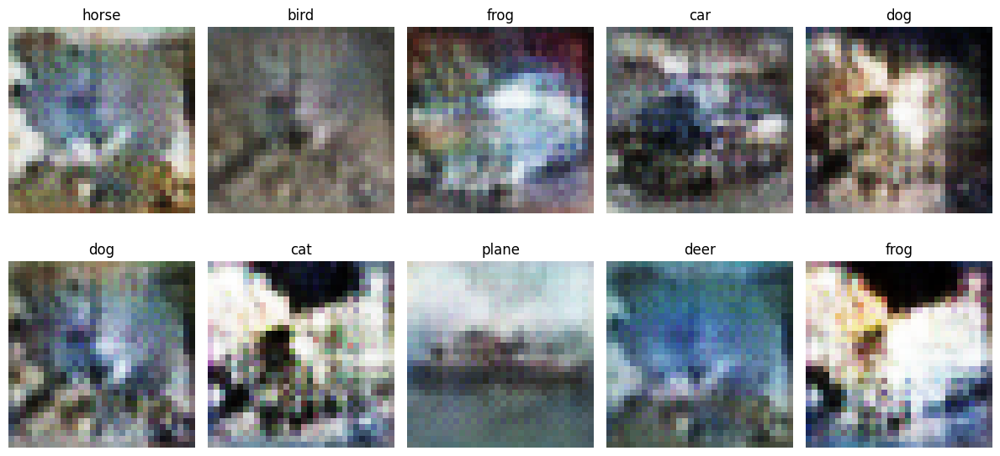

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.74485778808594, KID: 0.04580831900238991


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 61.677799224853516, KID: 0.05125243961811066


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 45.20331954956055, KID: 0.031952839344739914


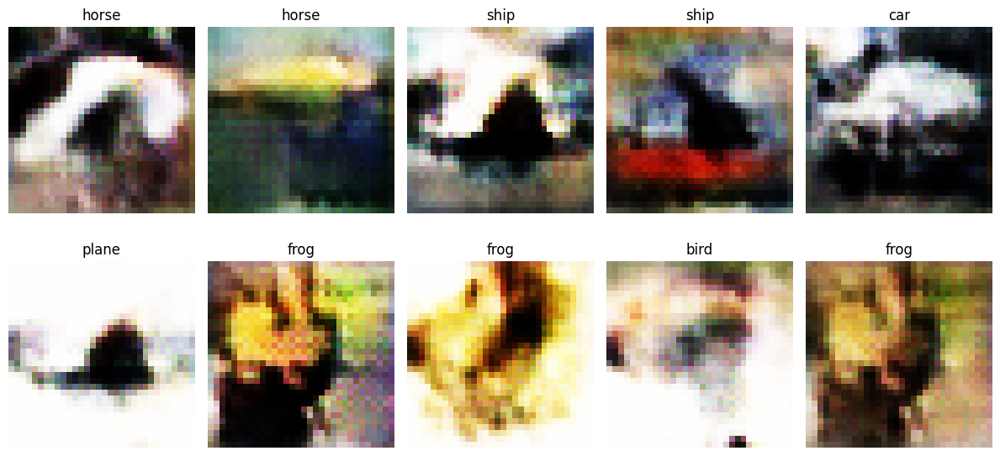

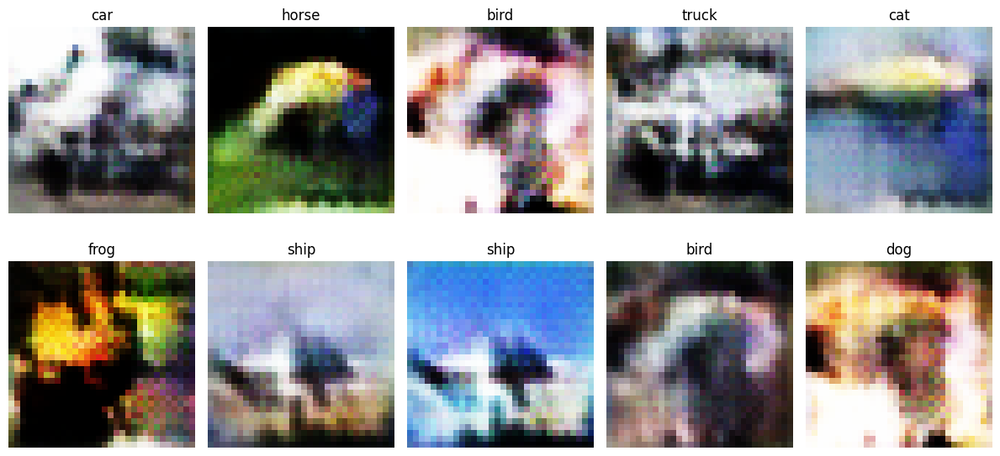

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.94200134277344, KID: 0.038055263459682465


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.962013244628906, KID: 0.037415146827697754


Training Epoch 251/501: 100%|██████████| 98/98 [00:02<00:00, 34.50it/s, disc_loss=0.367, gen_loss=1.93]


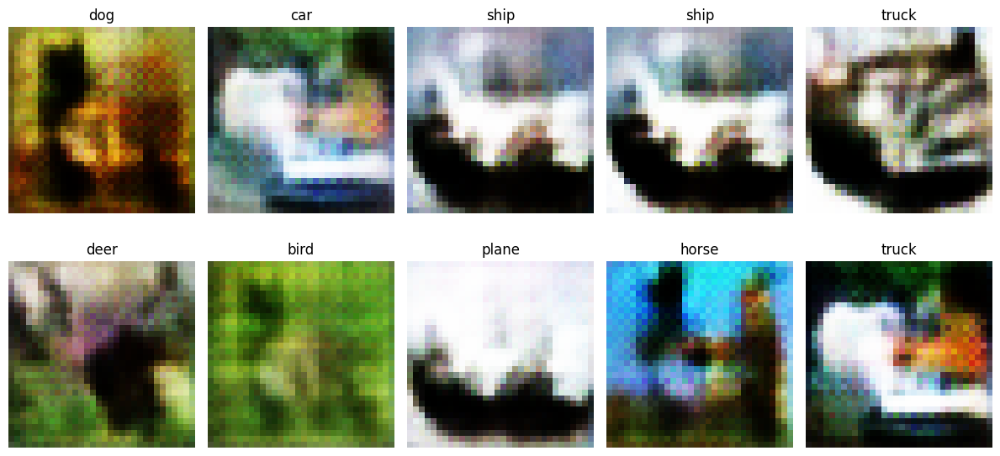

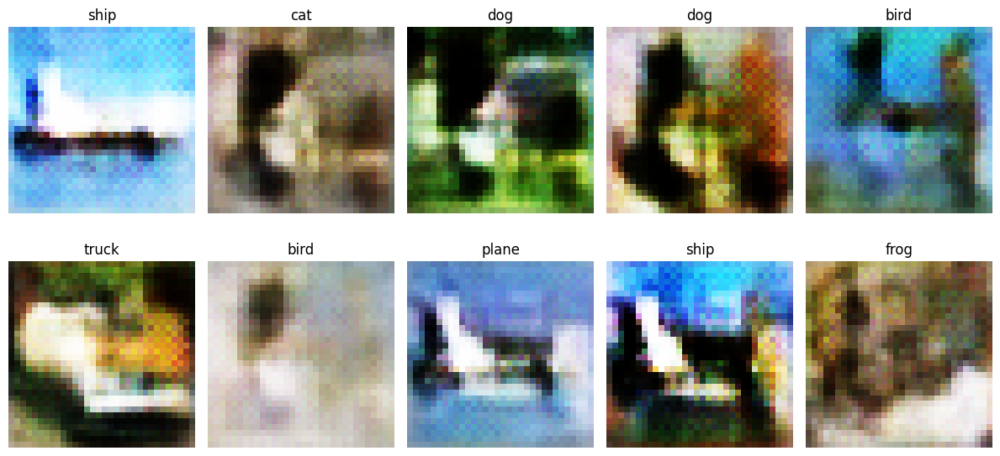

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.291893005371094, KID: 0.0362553633749485


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 50.821144104003906, KID: 0.036678437143564224


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.592079162597656, KID: 0.039605822414159775


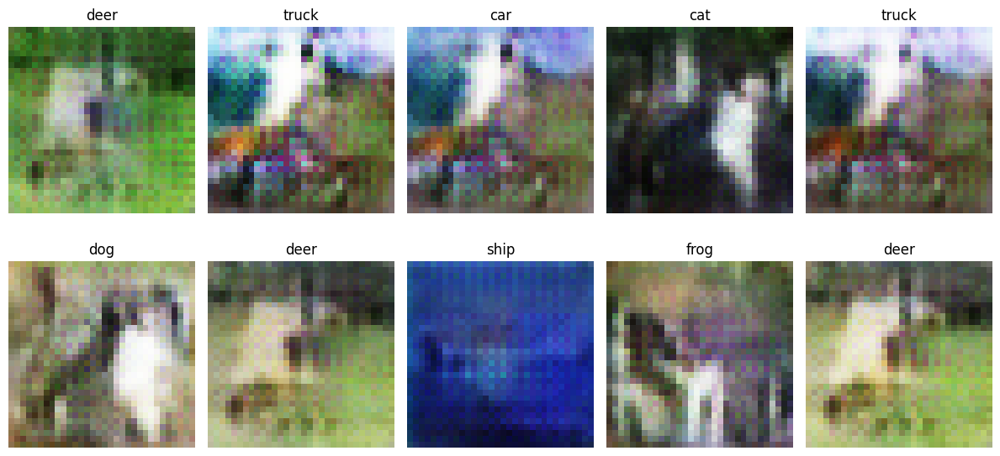

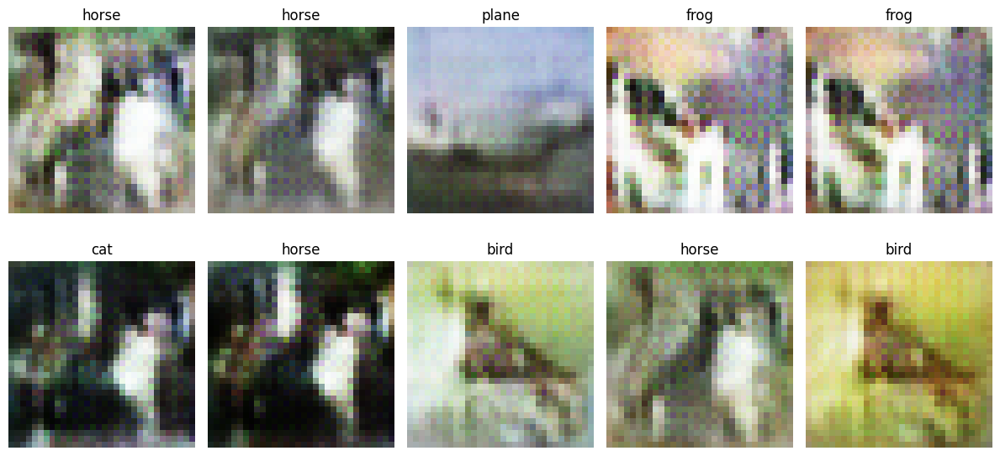

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.89706802368164, KID: 0.03594847023487091


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 49.727996826171875, KID: 0.03628916293382645


Training Epoch 351/501: 100%|██████████| 98/98 [00:02<00:00, 33.14it/s, disc_loss=0.387, gen_loss=1.56]


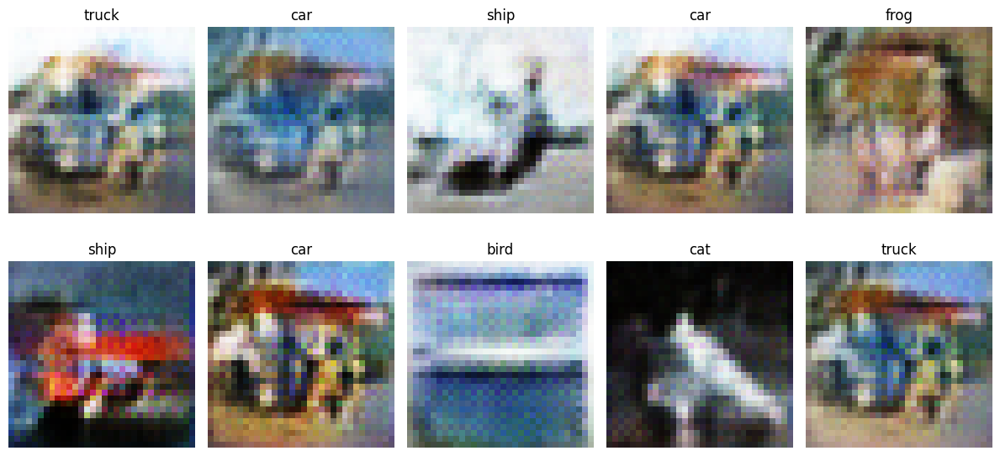

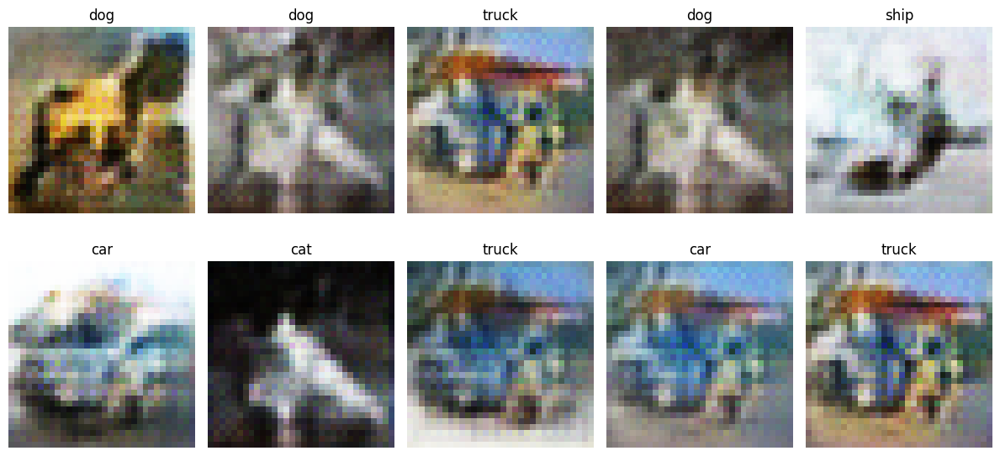

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 52.250553131103516, KID: 0.034269001334905624


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 57.562255859375, KID: 0.04314497858285904


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.145652770996094, KID: 0.03413400426506996


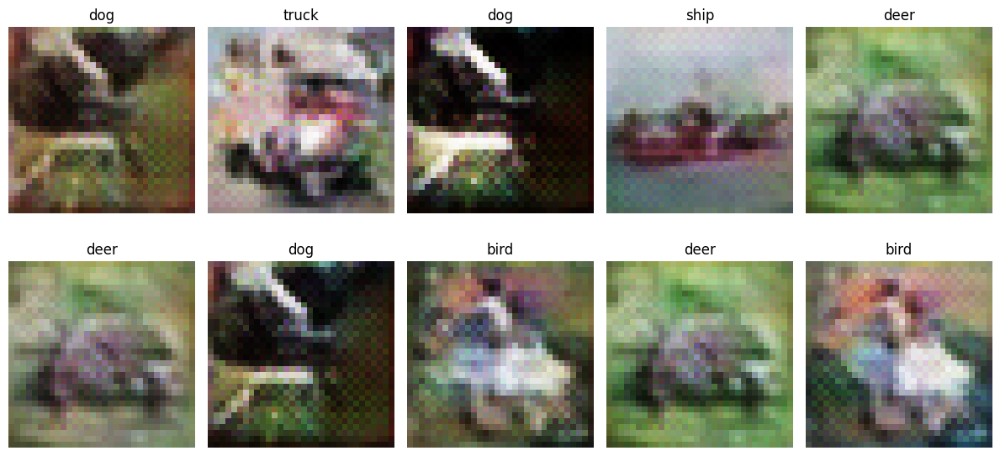

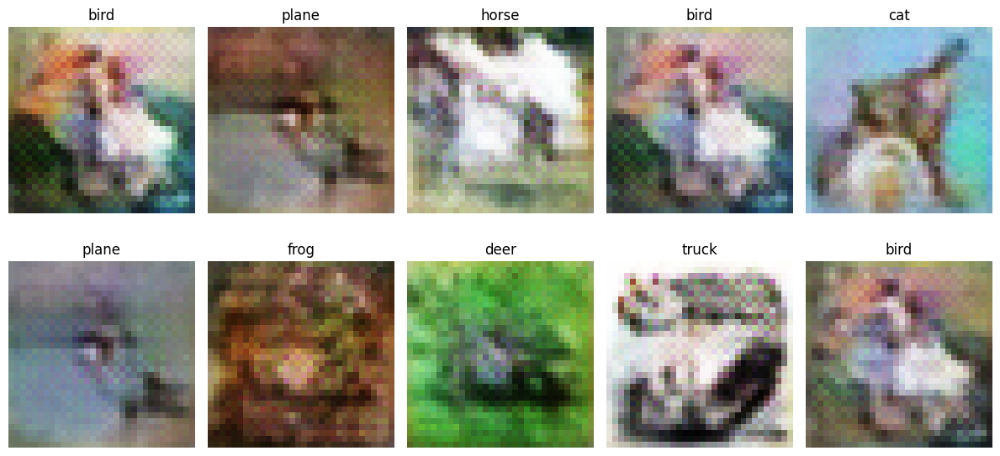

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.108726501464844, KID: 0.03441181406378746


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.564632415771484, KID: 0.02987150102853775


Training Epoch 451/501: 100%|██████████| 98/98 [00:02<00:00, 35.75it/s, disc_loss=0.357, gen_loss=2.21]


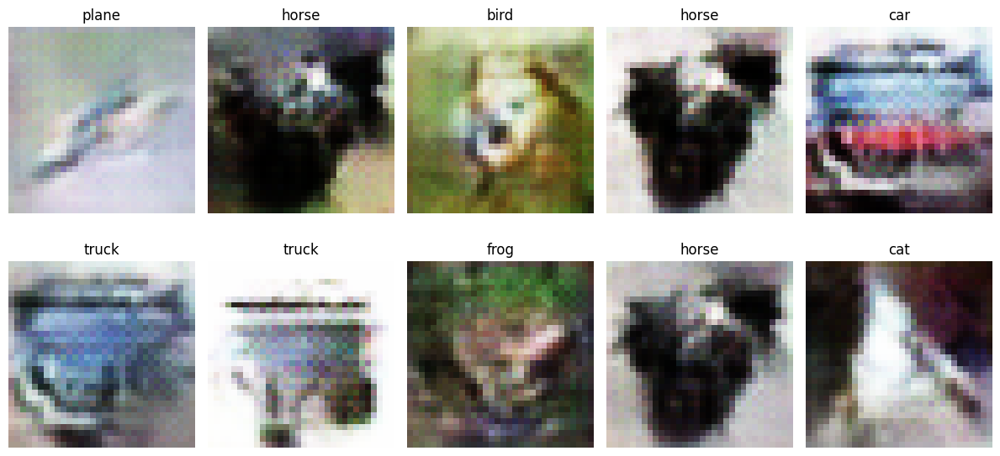

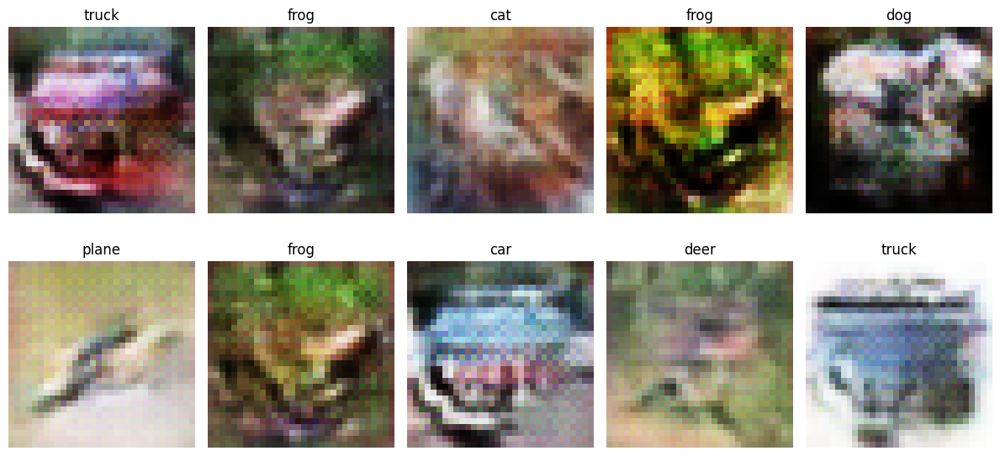

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.933658599853516, KID: 0.04409979656338692


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.597721099853516, KID: 0.031788088381290436


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 59.407806396484375, KID: 0.03649253398180008


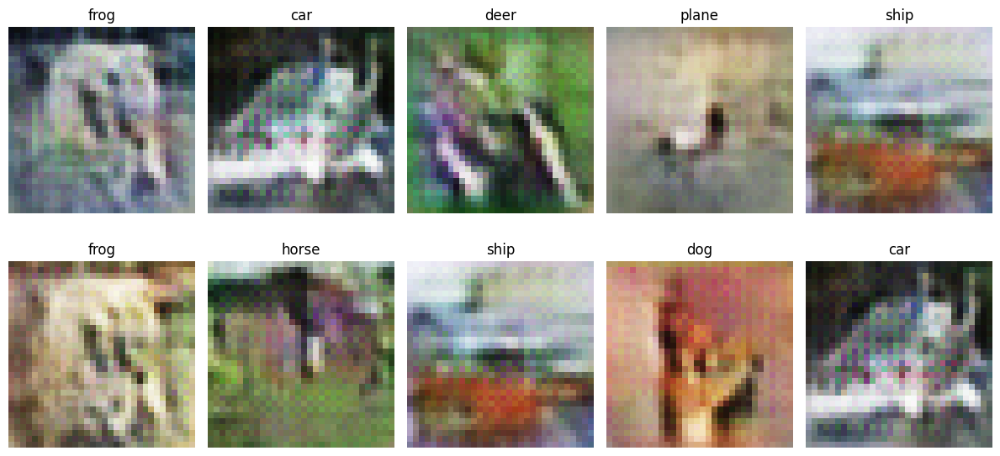

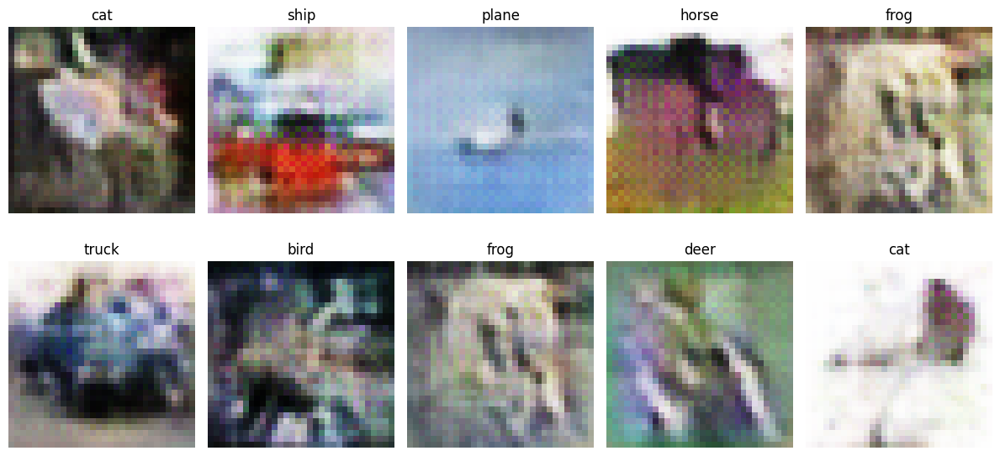

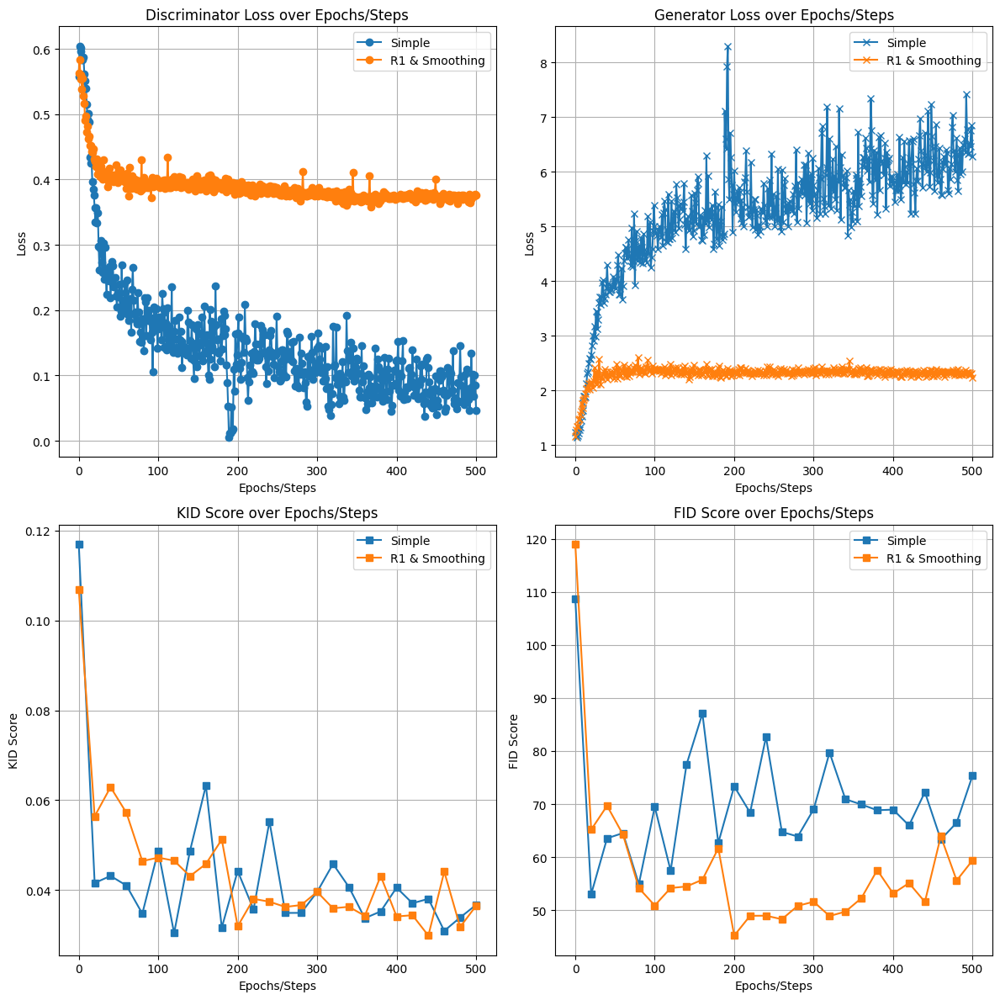

<Figure size 1200x600 with 0 Axes>

In [48]:
gen_resize = ResizeGenerator(128,1024).to(device)
disc_simple = SimpleDiscriminator().to(device)

r1gan = R1GAN(gen_resize,disc_simple,train_loader)
r1gan.fit(501,train_loader)
plot_losses(501,[(cgan,"Simple"),(r1gan,"R1 & Smoothing")])

r1gan.save("r1-500e-v2")
torch.cuda.empty_cache()

#### Observations

- After adding regularisation, from the training graph we can observe the generator overpowering the discriminator as the discriminator loss keeps decreasing while the generator plateaus
- Even though FID increases at the beginning, it slowly deteriorates as the discirminator is providing wrong feedback to the generator
- Images seem more realistic but might have some mode collapse towards the end.

### Balanced Training

To solve the problem of discriminator or generator overpowering each other, we introduced a balancing mechanism that will stop training one of the models if it gets too powerful and allow the other to catch up. 

**Precision Score**

In this mechanism, as our key metric we will be using Precision (or recall depnding on how you see it) to determine if the generator is fooling the discriminator well or the other way around. We chose it over other scores due to its lightweight and simplicity. Precision is defined as 

$\text{Precision} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Positives}}$

In our case, the True Positives are images which are real that was classified by the discirminator as real. False positives are fake images that were classified as real. In our training the discriminator will aim to minimise false positives and generator will try to maximise it. 

**Our Baselines**

<pre>
                                    Precision Score

 0       10      20      30      40      50      60      70      80      90      100
 |-------|-------|-------|-------|-------|-------|-------|-------|-------|-------|
        Gen Strong       ^           Buffer Zone         ^      Disc Strong
                      30 mark                         70 mark
</pre>


We set a arbitrary baseline of 30% and 70%. Once the Precision drops below 30%, it means the generator is overpowering and fooling the discriminator more. If precision is more than 70%, it means the discriminator is overpowering. of course we could use other baselines but we will use this to allow a 40% range where neither overpower the other. 

**Use of Circular Buffer**

Calculating Precision can be done for every batch and decision to traing can be based off of that but we find this wrong. Certain batches are just hard to classify and if the discriminator doesn't perform it might be due to the data rather than the model. To solve this problem, we introduce a circular buffer to store past precision scores. Everytime the model calculates precision, it will take the last $n$ precision scores and average it, where $n$ can be any number but here we will use the batch_size. 

I will also give a 20 epoch buffer time for both models to get settled before this mechanism takes effect.

In [49]:
class CircularBuffer:
    def __init__(self, size):
        self.size = size
        self.buffer = [None] * size
        self.index = 0
        self.full = False

    def add(self, value):
        self.buffer[self.index] = value
        self.index = (self.index + 1) % self.size
        if self.index == 0:
            self.full = True

    def get_values(self):
        if self.full:
            return self.buffer
        else:
            return self.buffer[:self.index]

    def values(self):
        values = self.get_values()
        return sum(values) / max(len(values), 1)

In [50]:
class BalancedGAN(R1GAN):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__(generator, discriminator, train_loader)
        
        self.buffer = CircularBuffer(size=TRAIN_BATCH_SIZE)
        
    def fit(self, epochs, train_loader):
        print(f"Training {self.__class__.__name__} for {epochs} Epochs")

        self.discriminator.train()
        self.generator.train()
        
        for epoch in range(epochs):
            
            disc_losses, gen_losses = [], []
            last_disc, last_gen = 0, 0
            
            progress = tqdm(train_loader, desc=f'Training Epoch {epoch + 1}/{epochs}', leave=True, colour="green", dynamic_ncols=True)
            for img, label in  progress:
                
                precision = self.get_precision(img, label)
                self.buffer.add(precision)
                if self.buffer.values() <= 0.30 and epoch > 5:
                    disc_loss = self.disc_step(img, label)
                    last_disc = disc_loss
                    
                    disc_losses.append(disc_loss)
                    gen_losses.append(last_gen)
                    
                    progress.set_postfix(disc_loss=disc_loss)
                    
                elif self.buffer.values() >= 0.70 and epoch > 5:
                    gen_loss = self.gen_step(img, label)
                    last_gen = gen_loss
                    
                    gen_losses.append(gen_loss)
                    disc_losses.append(last_disc)
                    
                    progress.set_postfix(gen_loss=gen_loss)
                    
                else:
                    disc_loss = self.disc_step(img, label)
                    gen_loss = self.gen_step(img, label)

                    disc_losses.append(disc_loss)
                    gen_losses.append(gen_loss)

                    progress.set_postfix(disc_loss=disc_loss, gen_loss=gen_loss)
                
            self.disc_scores.append(np.mean(disc_losses))
            self.gen_scores.append(np.mean(gen_losses))
            self.on_epoch_end(epoch)
    
    def get_precision(self, img, label):
        with torch.no_grad():
            img = img.to(device)
            label = label.to(device)
            
            fake_label = torch.zeros((img.size()[0], 1), device=device)
            real_label = torch.ones((img.size()[0], 1), device=device)
            
            noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
            fake_imgs = self.generator(noise, label)

            fake_pred = self.discriminator(fake_imgs, label)
            real_pred = self.discriminator(img, label)

            tp_r = ((fake_pred  <=  0.5) & (fake_label <= 0.5)).sum().item()
            tp_f = ((real_pred  <=  0.5) & (real_label <= 0.5)).sum().item()
            tp = tp_r + tp_f
            
            fp_r = ((fake_pred >= 0.5) & (fake_label <= 0.5)).sum().item()
            fp_f = ((real_pred >= 0.5) & (real_label <= 0.5)).sum().item()
            fp = fp_r + fp_f
            
            precision = tp / max((tp + fp), 1e-9)  # Avoid division by zero
        return precision

Training BalancedGAN for 501 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 120.90723419189453, KID: 0.12361392378807068


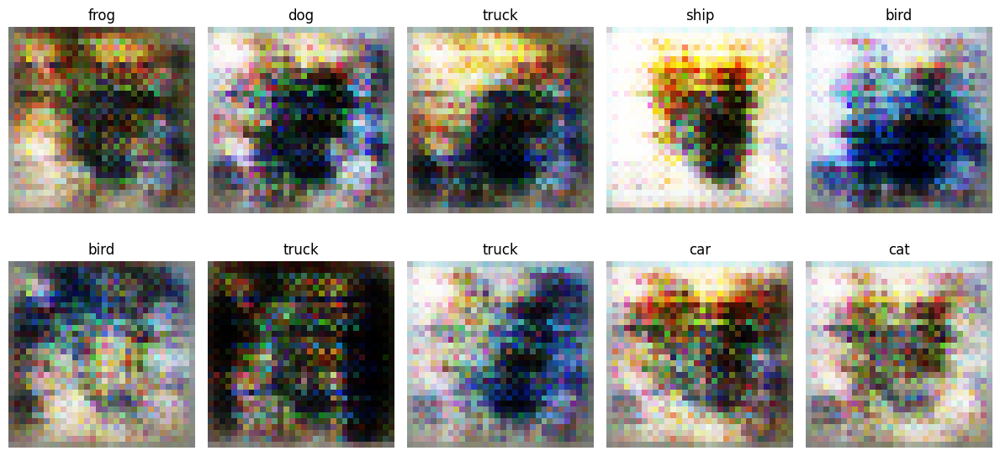

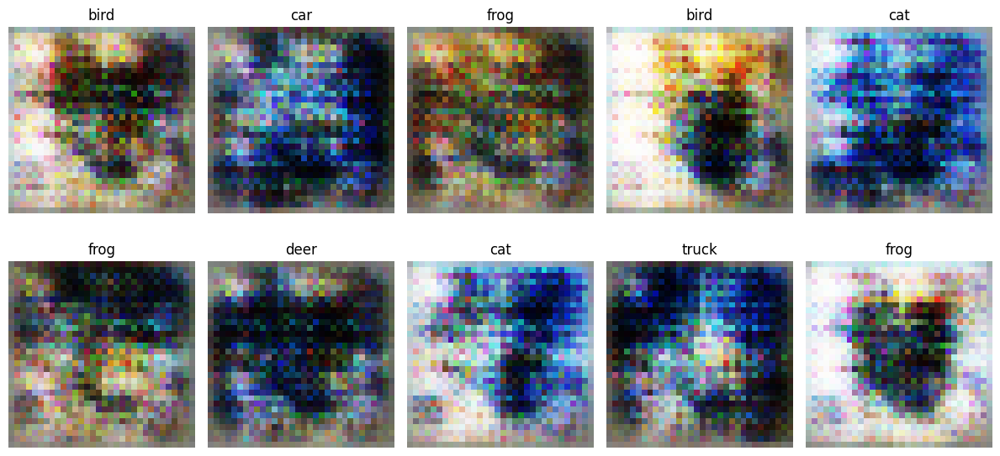

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 67.30870056152344, KID: 0.05785881355404854


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 74.90516662597656, KID: 0.06265890598297119


Training Epoch 51/501: 100%|██████████| 98/98 [00:02<00:00, 40.10it/s, gen_loss=1.58]                  


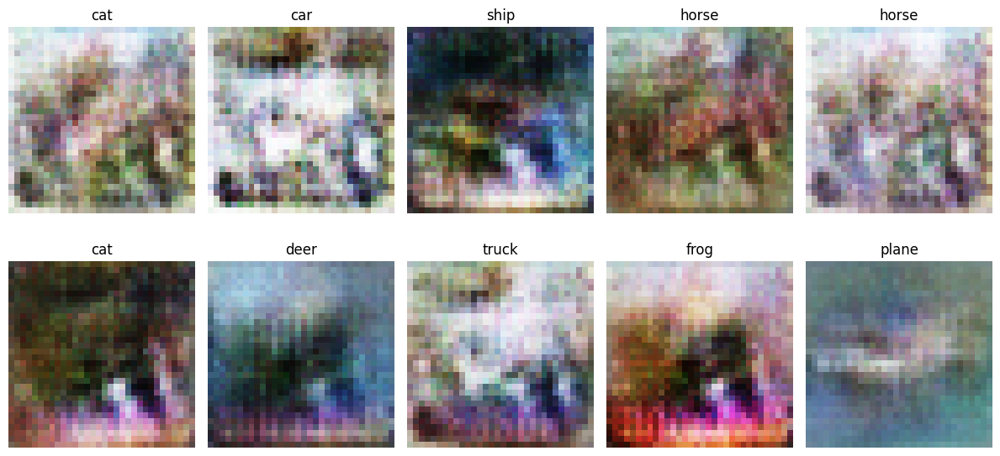

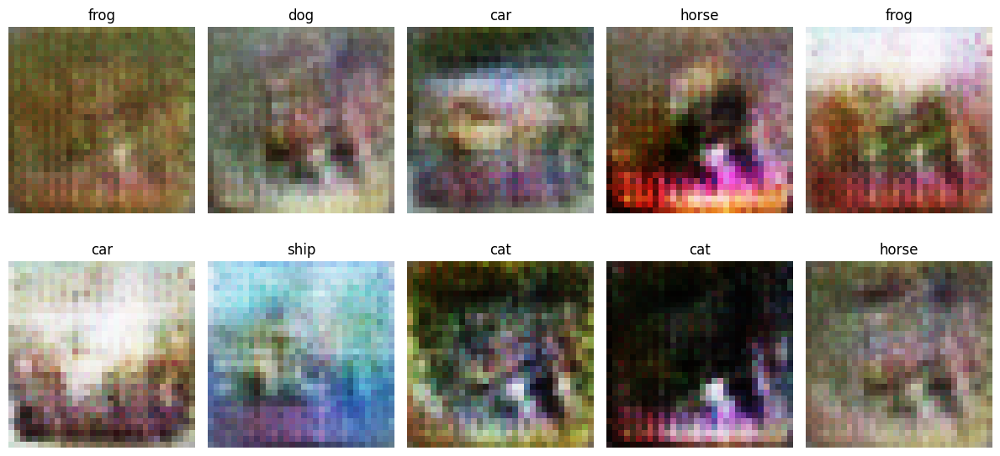

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 65.28886413574219, KID: 0.055721815675497055


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.33794021606445, KID: 0.042434852570295334


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 86.3828353881836, KID: 0.07647650688886642


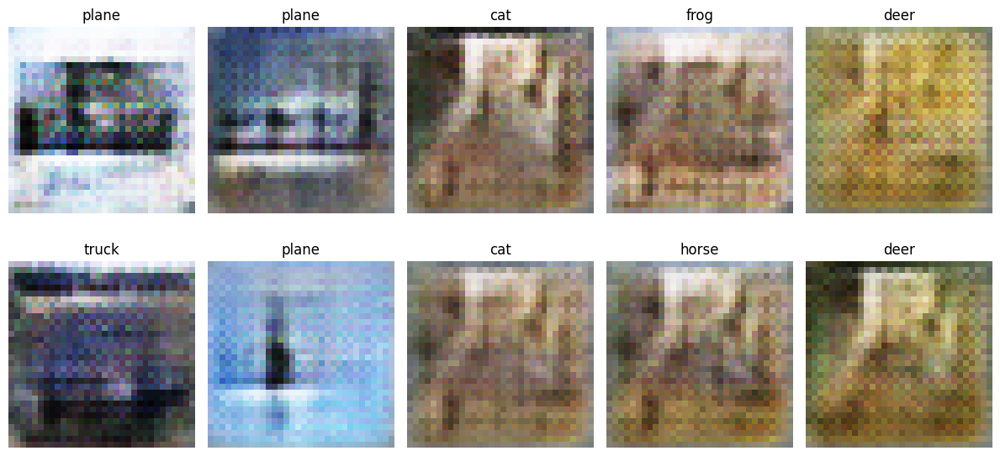

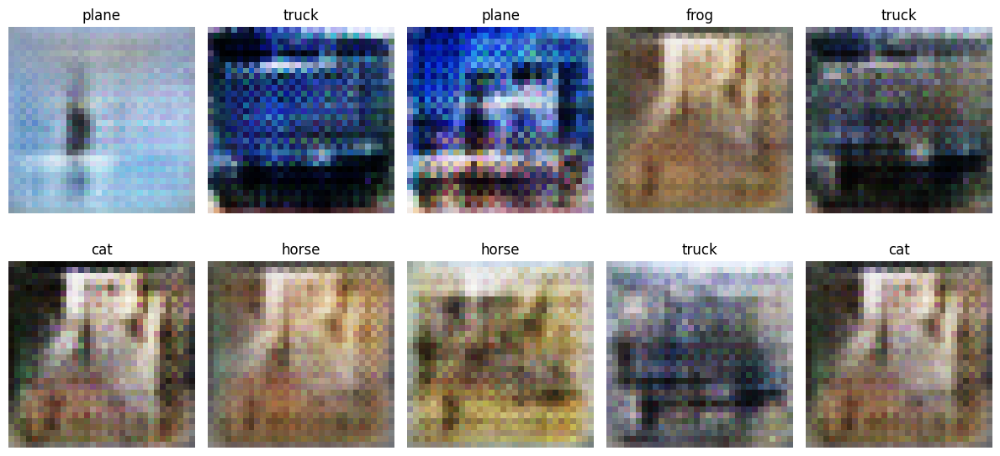

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 43.93115234375, KID: 0.03848229721188545


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 43.45783615112305, KID: 0.03471718728542328


Training Epoch 151/501: 100%|██████████| 98/98 [00:02<00:00, 37.83it/s, disc_loss=0.476, gen_loss=1.37] 


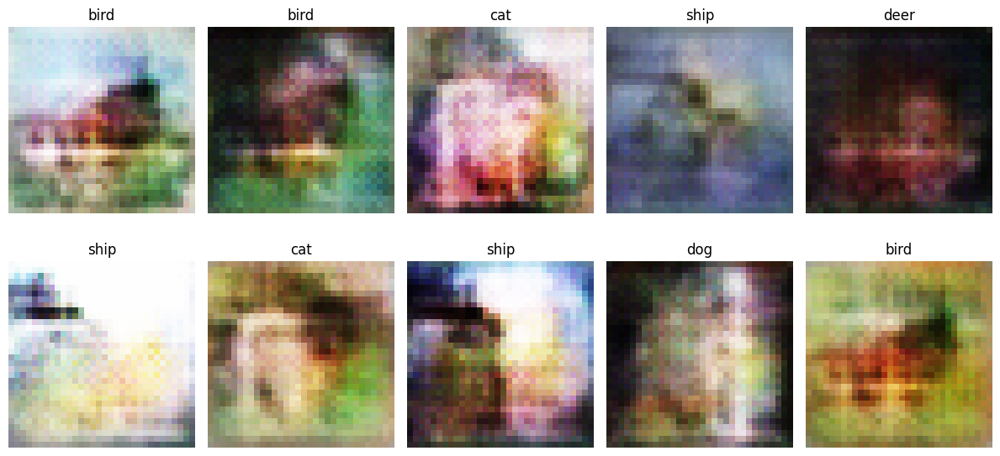

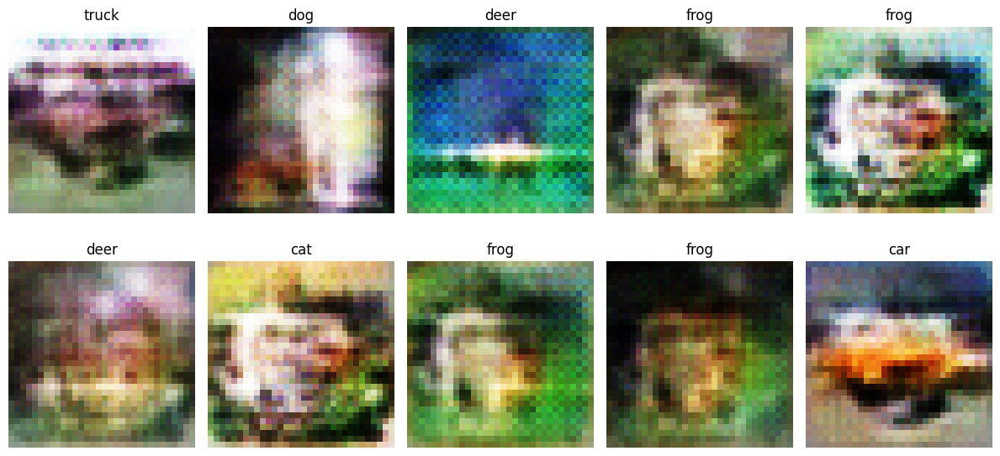

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 49.67783737182617, KID: 0.03920887038111687


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 64.3747787475586, KID: 0.056929439306259155


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 40.704071044921875, KID: 0.029724914580583572


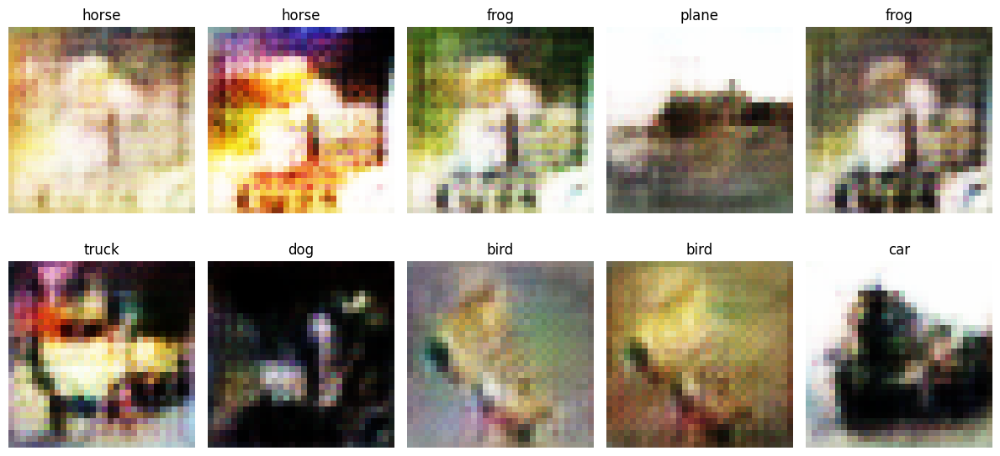

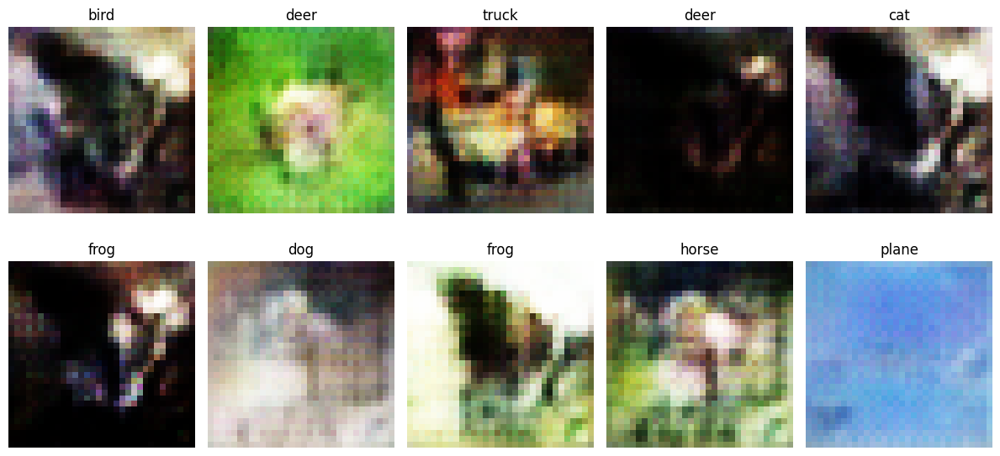

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 41.501319885253906, KID: 0.029091592878103256


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 46.847599029541016, KID: 0.03470000997185707


Training Epoch 251/501: 100%|██████████| 98/98 [00:02<00:00, 37.74it/s, disc_loss=0.46, gen_loss=2.19]  


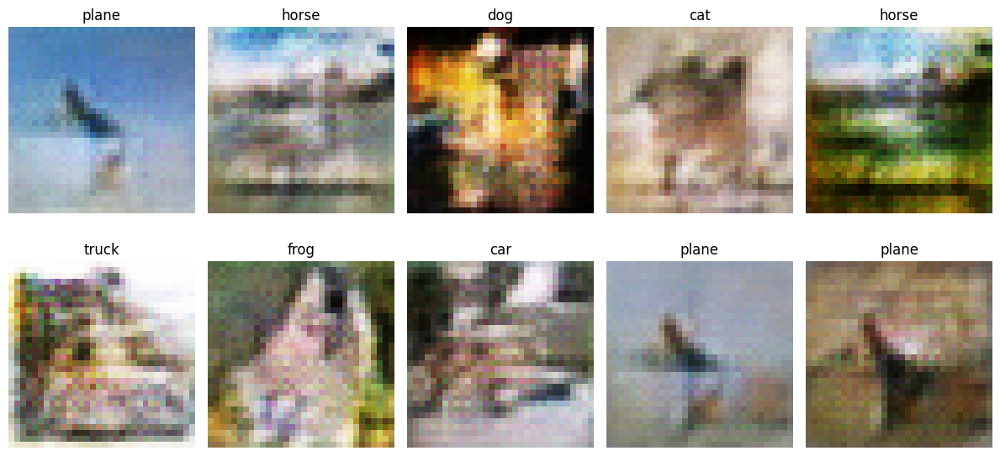

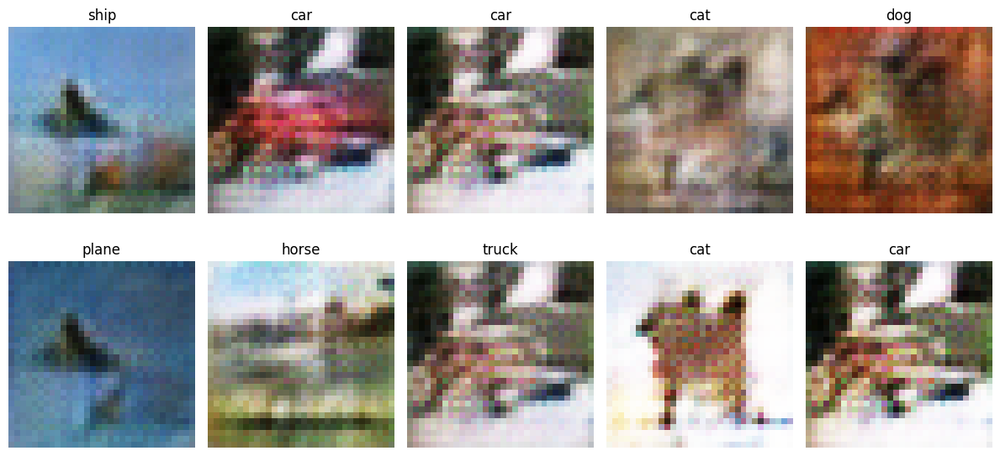

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.85567855834961, KID: 0.04690435156226158


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 66.27986145019531, KID: 0.05117489770054817


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 43.841026306152344, KID: 0.029743852093815804


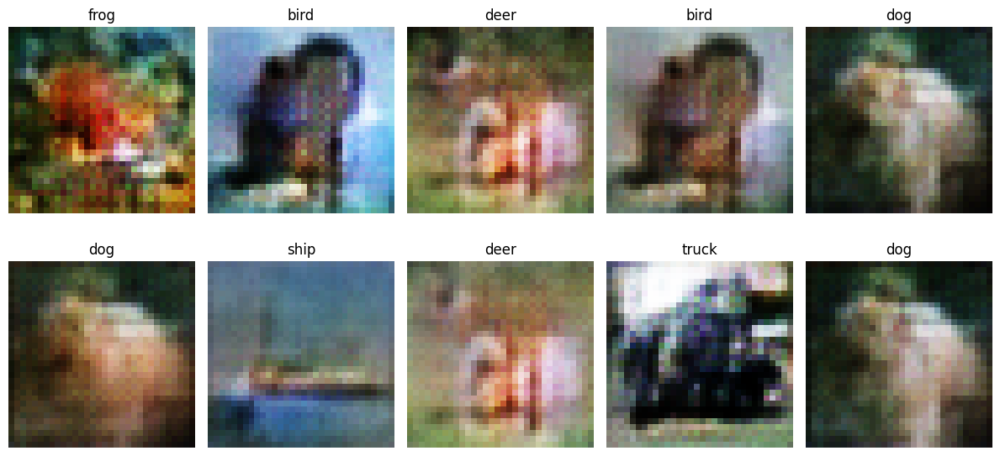

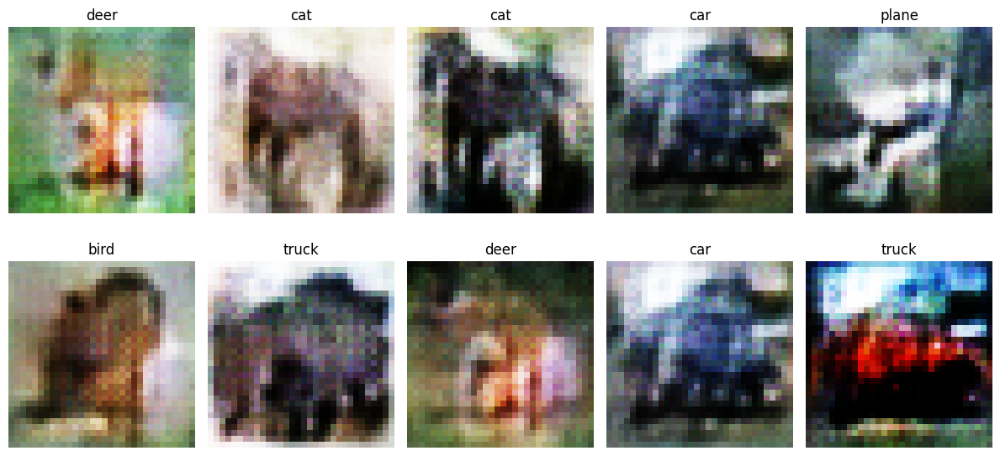

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 52.3414306640625, KID: 0.03563694283366203


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.50605773925781, KID: 0.03410603106021881


Training Epoch 351/501: 100%|██████████| 98/98 [00:02<00:00, 40.31it/s, disc_loss=0.405, gen_loss=2.15] 


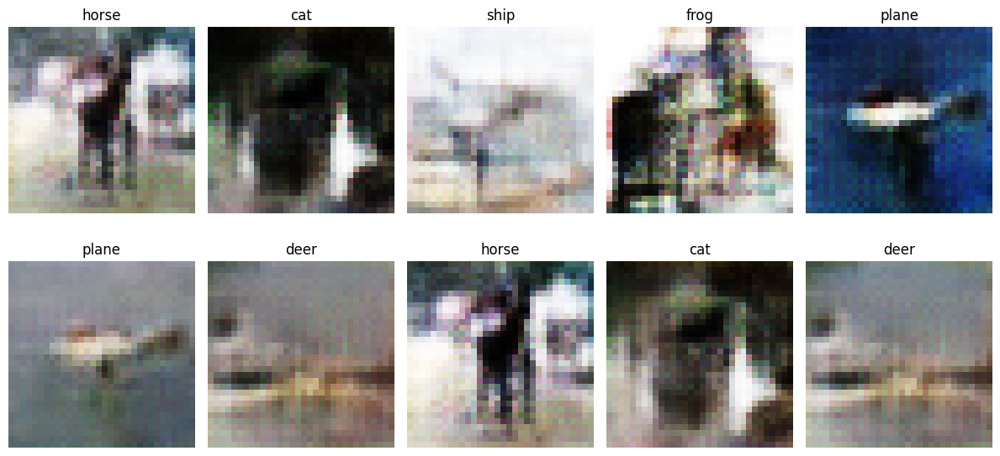

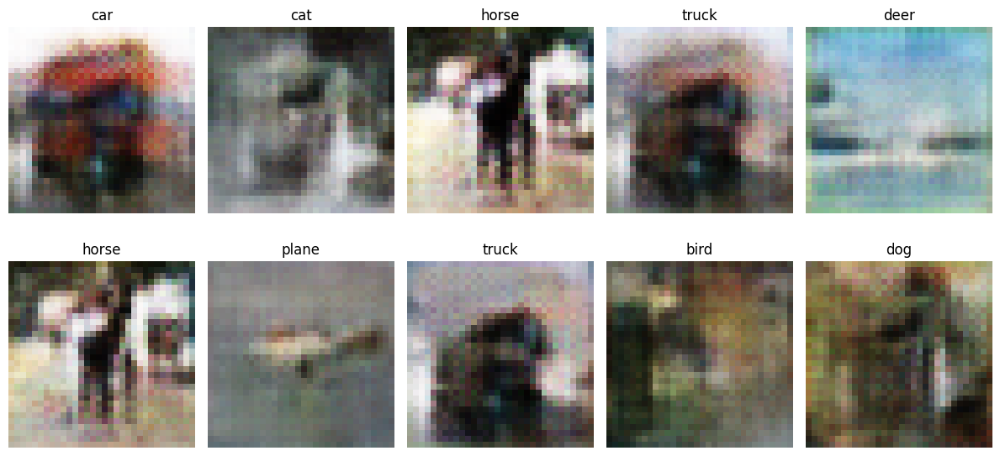

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.84241485595703, KID: 0.04619067534804344


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 64.13177490234375, KID: 0.04619920626282692


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 52.477420806884766, KID: 0.033259470015764236


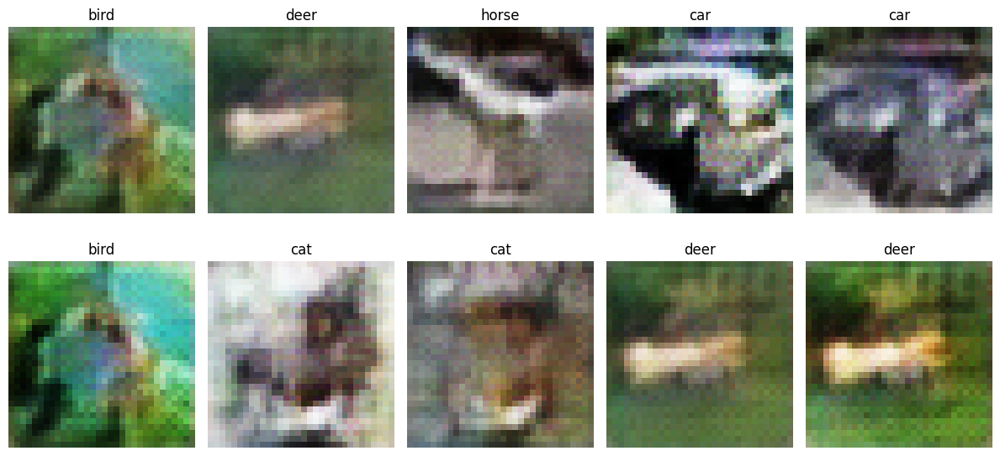

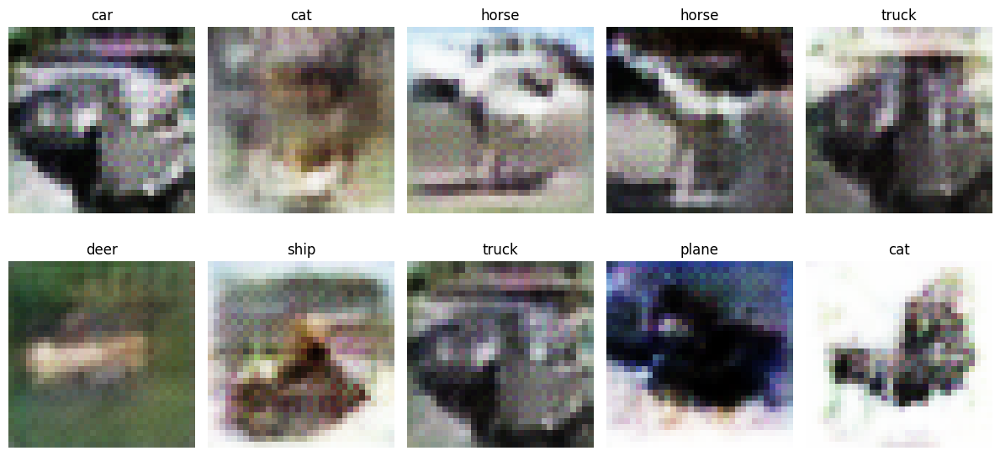

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 46.83354568481445, KID: 0.028255116194486618


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.86204147338867, KID: 0.03456706553697586


Training Epoch 451/501: 100%|██████████| 98/98 [00:01<00:00, 49.34it/s, disc_loss=0.431, gen_loss=1.61] 


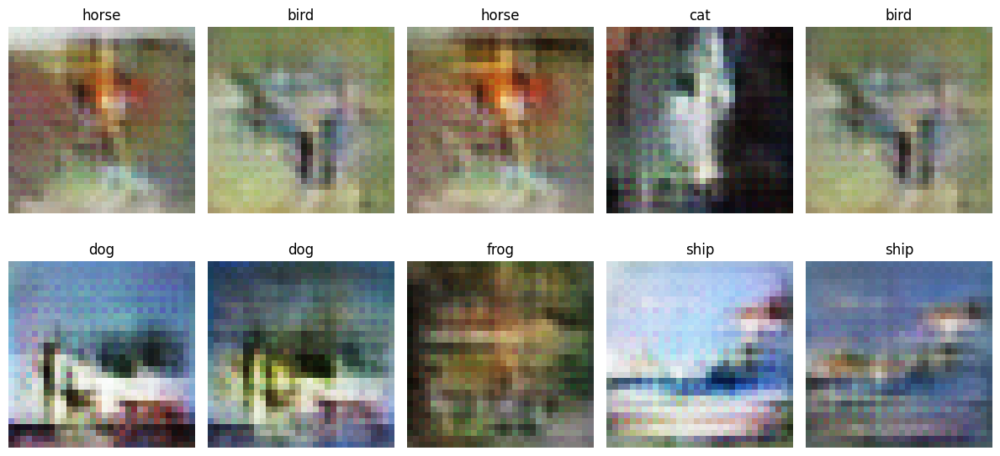

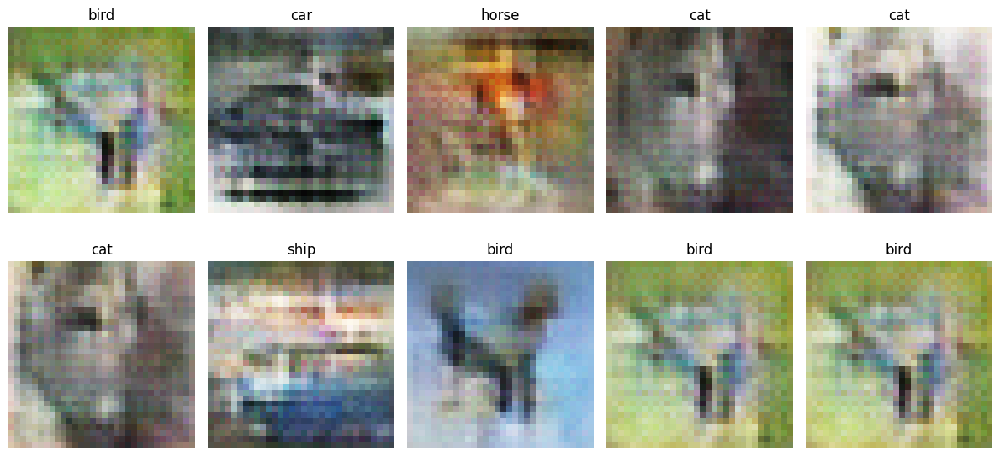

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 50.99947738647461, KID: 0.02537878043949604


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.32238006591797, KID: 0.03381608426570892


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 57.4306640625, KID: 0.03858458250761032


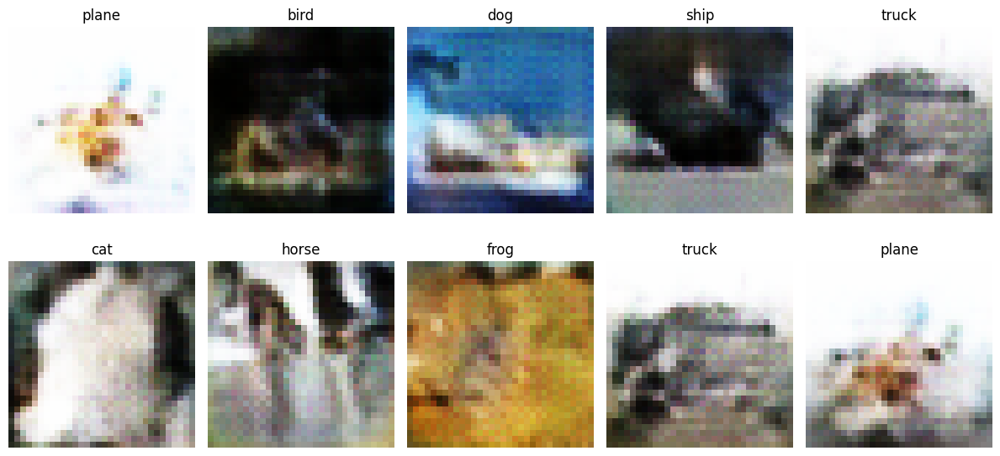

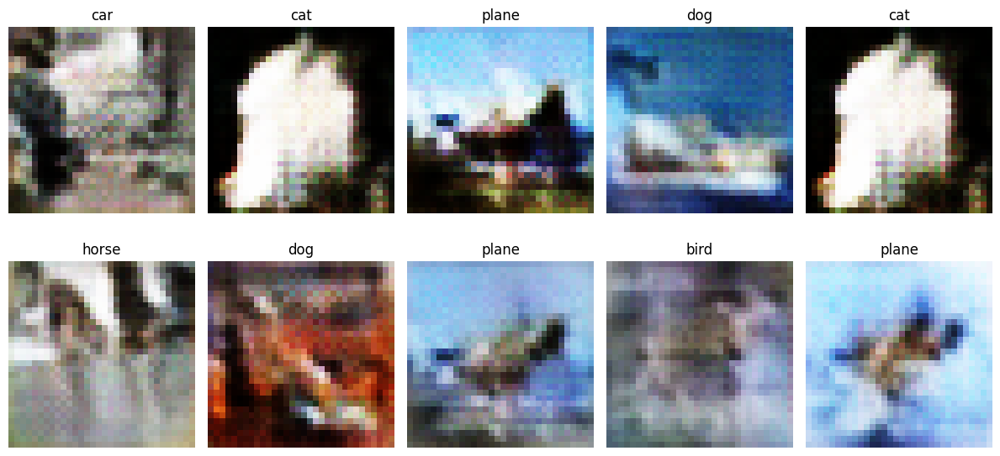

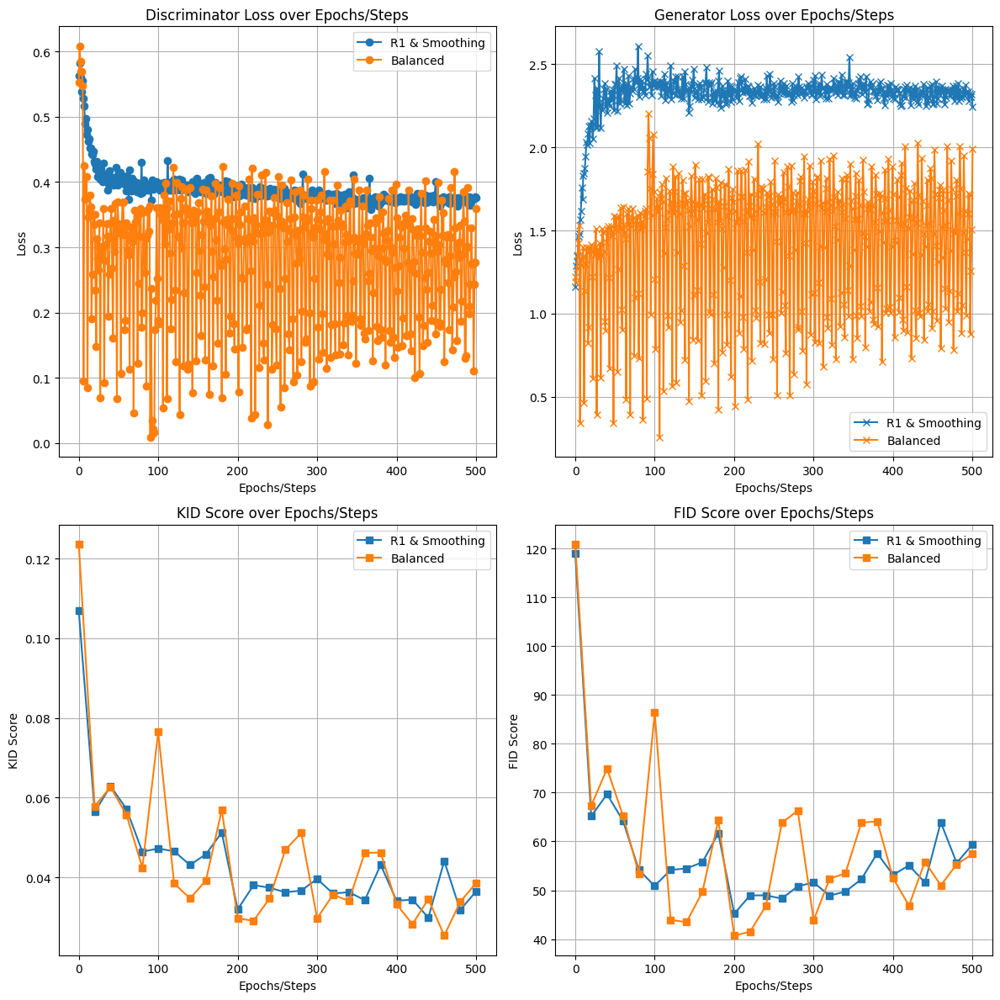

<Figure size 1200x600 with 0 Axes>

In [51]:
gen_simple = ResizeGenerator(128,1024).to(device)
disc_simple = SimpleDiscriminator().to(device)

balancedgan = BalancedGAN(gen_simple,disc_simple,train_loader)
balancedgan.fit(501,train_loader)
plot_losses(501,[(r1gan,"R1 & Smoothing"),(balancedgan,"Balanced")])

balancedgan.save("balanced-500e-v2")
torch.cuda.empty_cache()

#### Observations
- Compared to previous models this one is definitely more stable and the FID and KID consistently decreased for the first 200 epochs which is a good sign. 
- While the FID decreases constantly to around 40, it doesn begin to deteriorate after 250 epochs. This is a mistake on our end for training it too long where it begins to deteriorate
- Luckily since we have a mechanism to store the best model, we will be able to access the 40 FID models after done training. 
- Model seems to be better at drawing trucks and simple objects but struggles with animals.

> While in this training, the FID doesn't seem very impressive, in our previous runs it was much lower. This technique also helped stabilise the training of our subsequent models. A recent addition but overall value adder. 

### Spectral Normalisation

Spectral Normalisation is commonly applied to GANs to promote training stability and convergence. Takeru Miyato introduced it in [this paper](https://arxiv.org/abs/1802.05957). Intuitively speaking, spectral normalisation prevents the weights from changing too rapidly, thus making it less sensitive. 

**Theory**
Spectral Normalisation's success is because it can enforce Lipschitz continuity in the discriminator. Lipschitz continuity is a mathematical property that characterizes how much a function changes in response to a small change in input, 

![lipchitz](https://upload.wikimedia.org/wikipedia/commons/5/58/Lipschitz_Visualisierung.gif)

In this graph, we x changed, the increase in the graph is not too drastic and stays within the moving boundaries. This is a Lipschitz continuous function. Spectral Normalisation seeks to enforce this continuity on the discriminator's gradient.


In [52]:
class SpectralDiscriminator(nn.Module):
    def __init__(self):
        super(SpectralDiscriminator, self).__init__()
    
        self.conv_layers = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(CHANNELS, 32, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
        
            nn.AvgPool2d(2, stride=2)
        )
        

        self.output_layers = nn.Sequential(
            nn.Linear(256 + NUM_CLASS, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )
    
    def forward(self, x, labels):
        
        output = self.conv_layers(x).squeeze()
        x = torch.cat((output,labels), dim=1)
        x = self.output_layers(x)
        return x


Training BalancedGAN for 501 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 118.38399505615234, KID: 0.10447444766759872


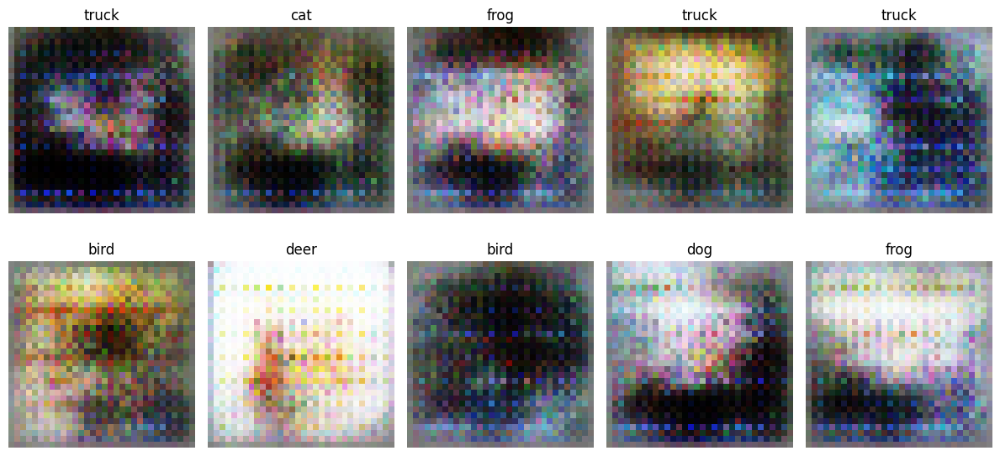

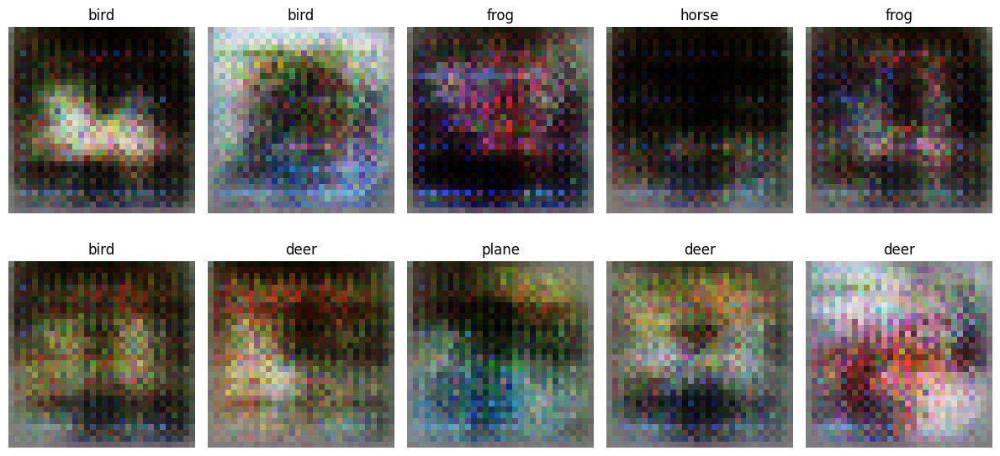

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 86.5225601196289, KID: 0.08091682195663452


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 52.430625915527344, KID: 0.0473259873688221


Training Epoch 51/501: 100%|██████████| 98/98 [00:03<00:00, 30.46it/s, disc_loss=0.464, gen_loss=1.85]


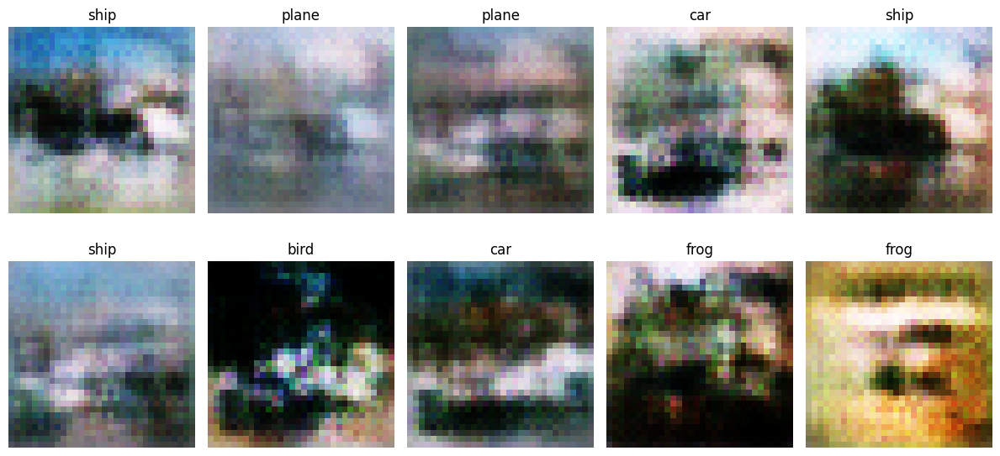

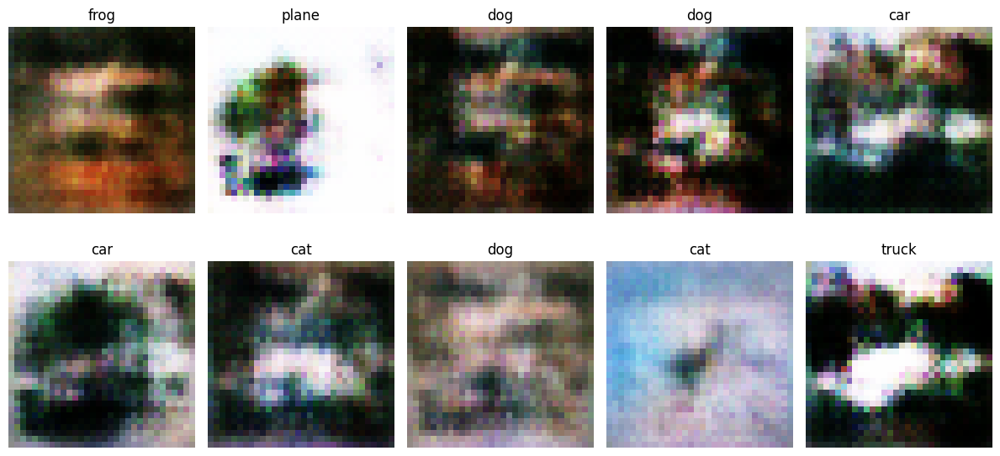

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 83.45834350585938, KID: 0.07279352843761444


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 112.64698028564453, KID: 0.11700954288244247


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 60.21035385131836, KID: 0.05029847472906113


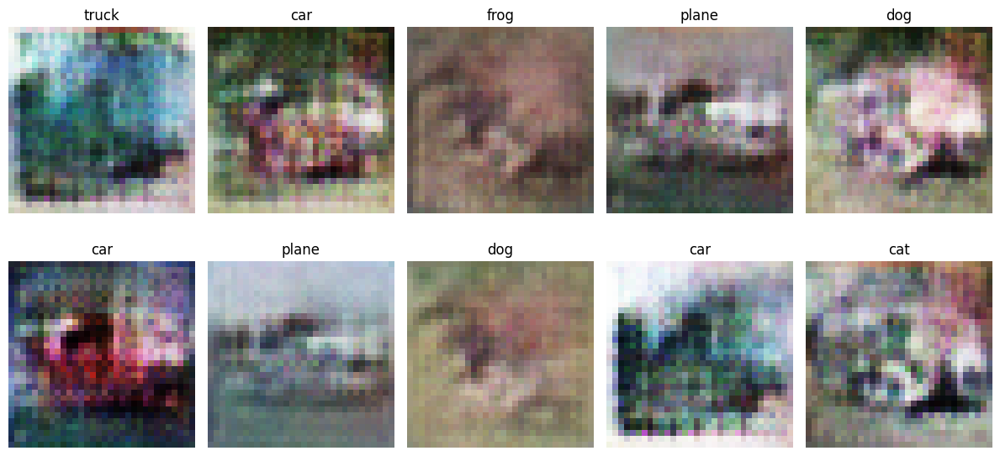

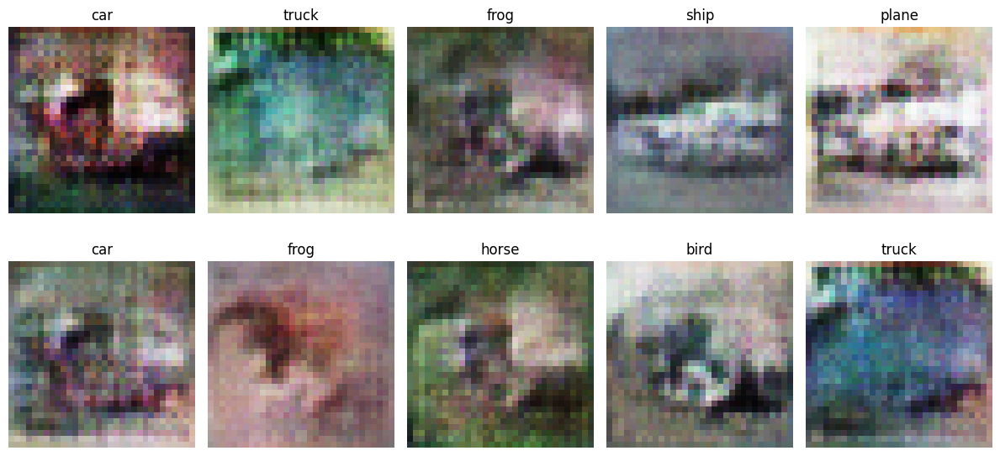

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 44.08586120605469, KID: 0.03491782024502754


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 47.73335647583008, KID: 0.037623703479766846


Training Epoch 151/501: 100%|██████████| 98/98 [00:03<00:00, 29.02it/s, gen_loss=1.76]                 


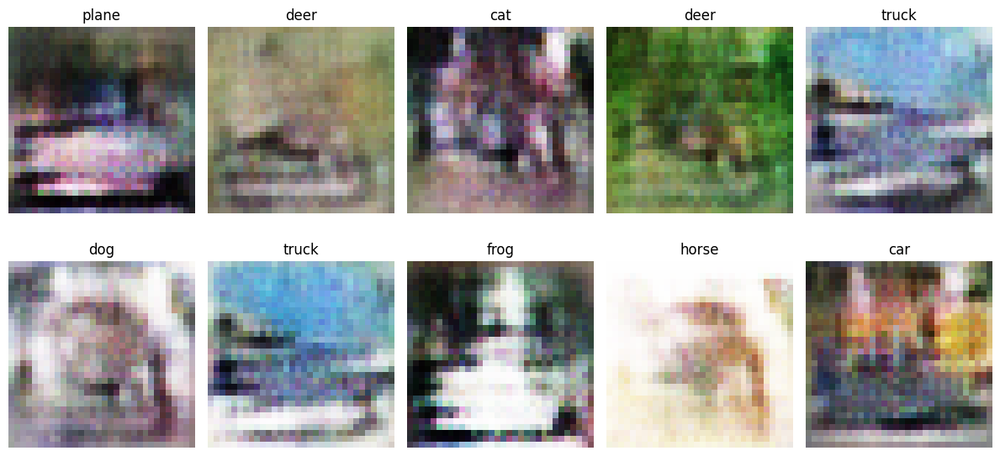

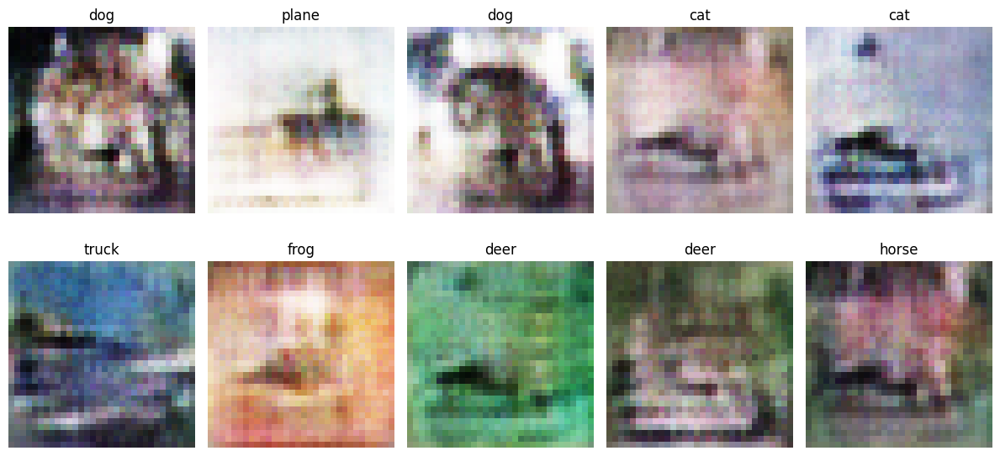

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.613922119140625, KID: 0.04040231928229332


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 61.84033966064453, KID: 0.05044092237949371


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.21028518676758, KID: 0.037098322063684464


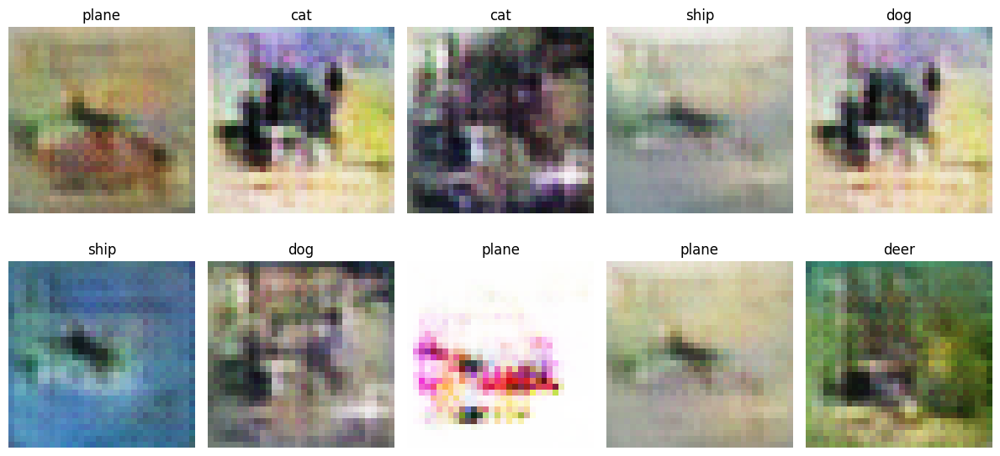

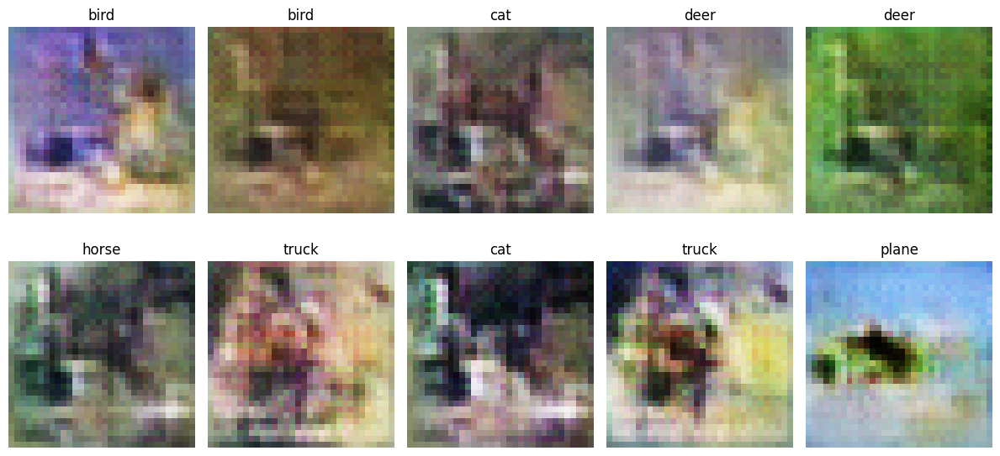

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 49.84903335571289, KID: 0.04004843160510063


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.531776428222656, KID: 0.03834521397948265


Training Epoch 251/501: 100%|██████████| 98/98 [00:03<00:00, 29.34it/s, disc_loss=0.405, gen_loss=2.03] 


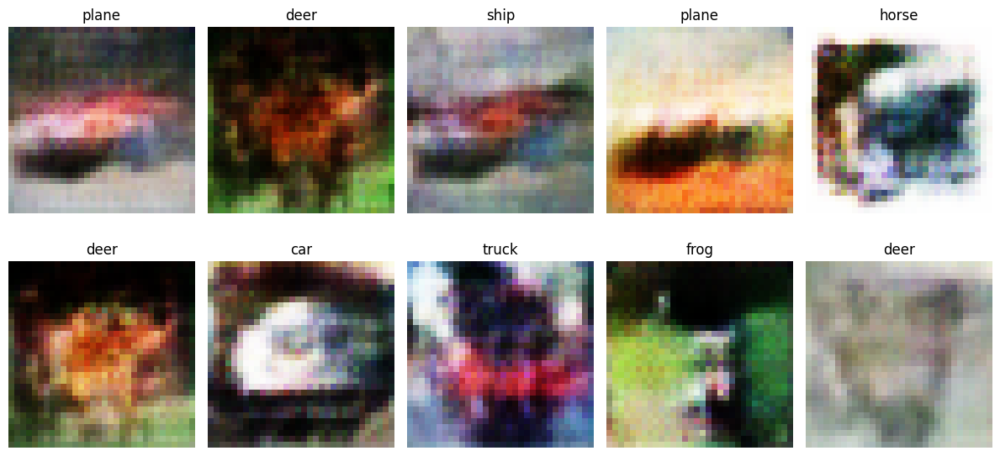

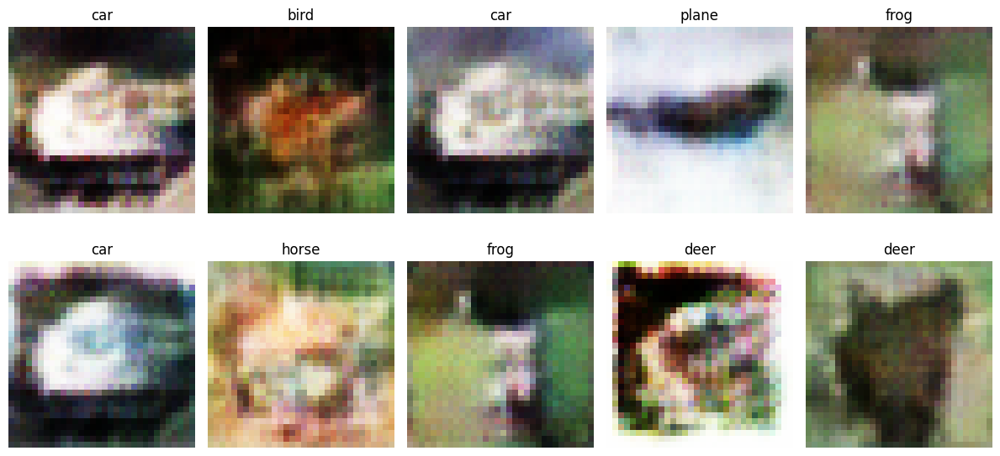

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 45.05347442626953, KID: 0.03554515913128853


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 62.177711486816406, KID: 0.058163534849882126


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.08354949951172, KID: 0.03681596368551254


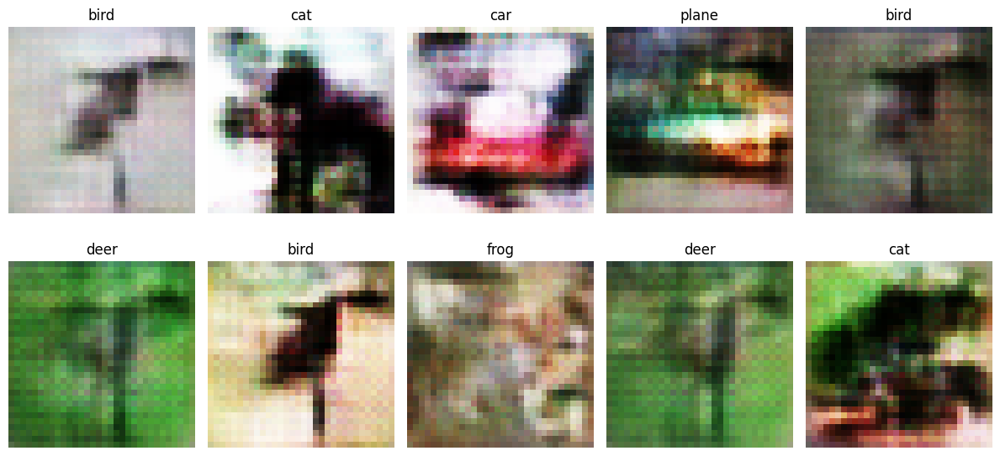

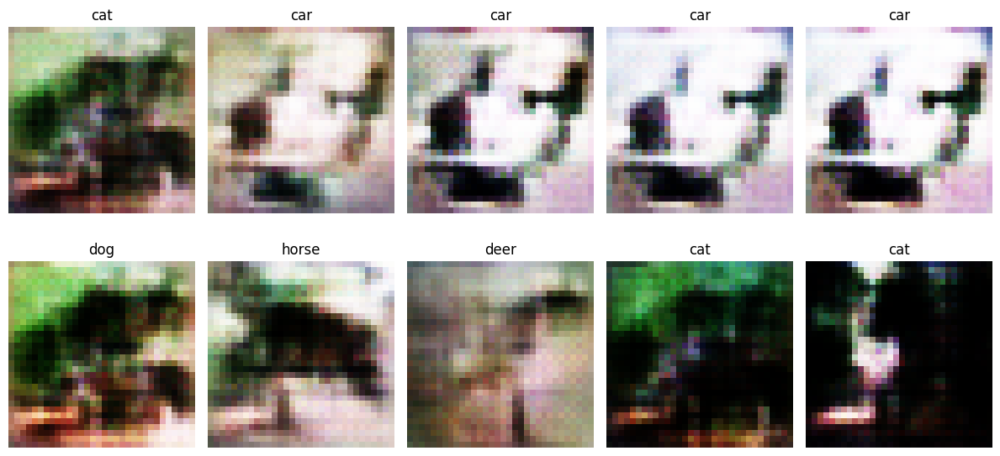

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 70.41686248779297, KID: 0.06263531744480133


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.100563049316406, KID: 0.038681741803884506


Training Epoch 351/501: 100%|██████████| 98/98 [00:03<00:00, 27.02it/s, disc_loss=0.412, gen_loss=2.41]


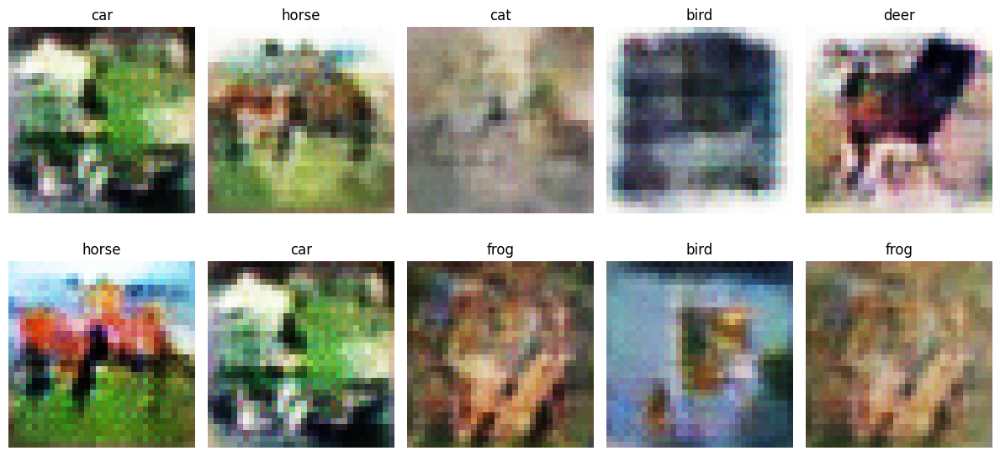

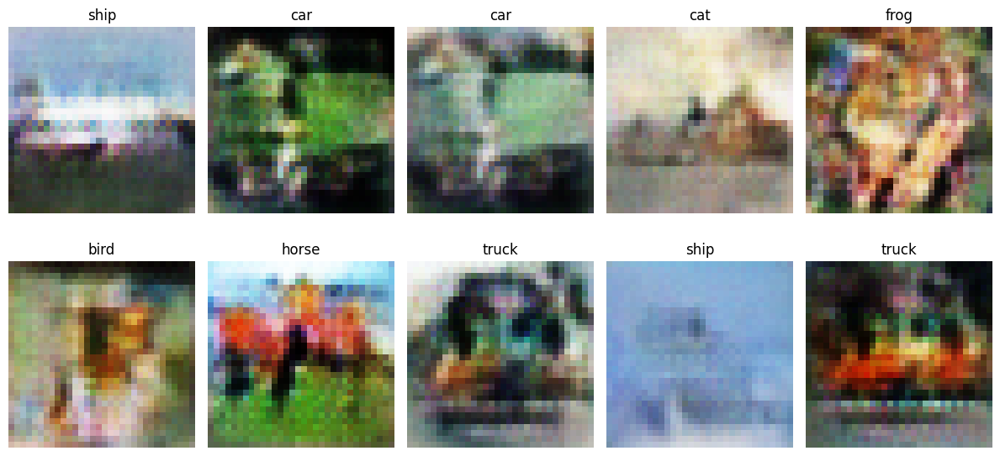

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.4597053527832, KID: 0.039917852729558945


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.53538513183594, KID: 0.0344519168138504


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 45.403507232666016, KID: 0.030722767114639282


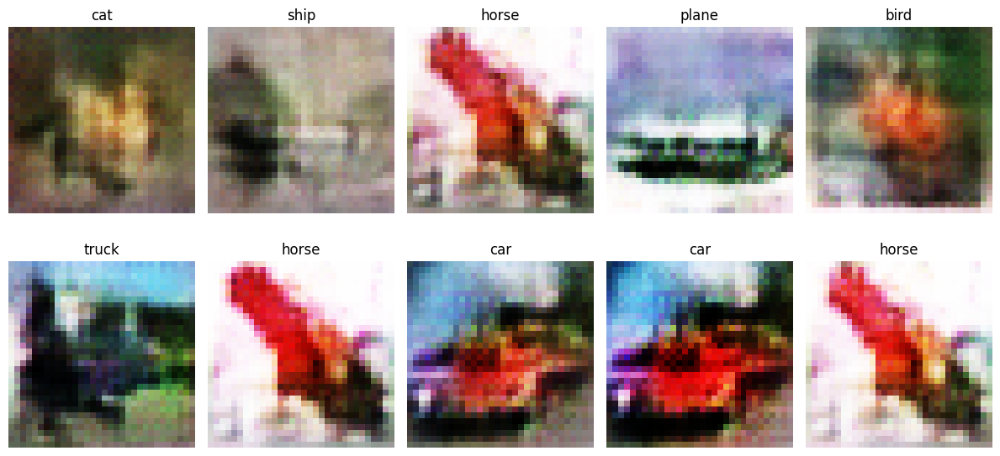

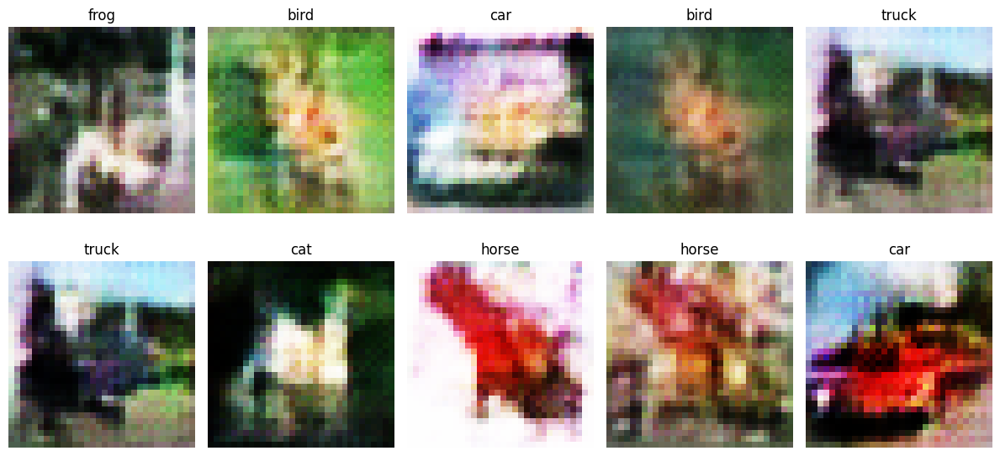

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 58.72304153442383, KID: 0.04249031841754913


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 47.76156997680664, KID: 0.029191993176937103


Training Epoch 451/501: 100%|██████████| 98/98 [00:02<00:00, 34.44it/s, disc_loss=0.443, gen_loss=1.47]


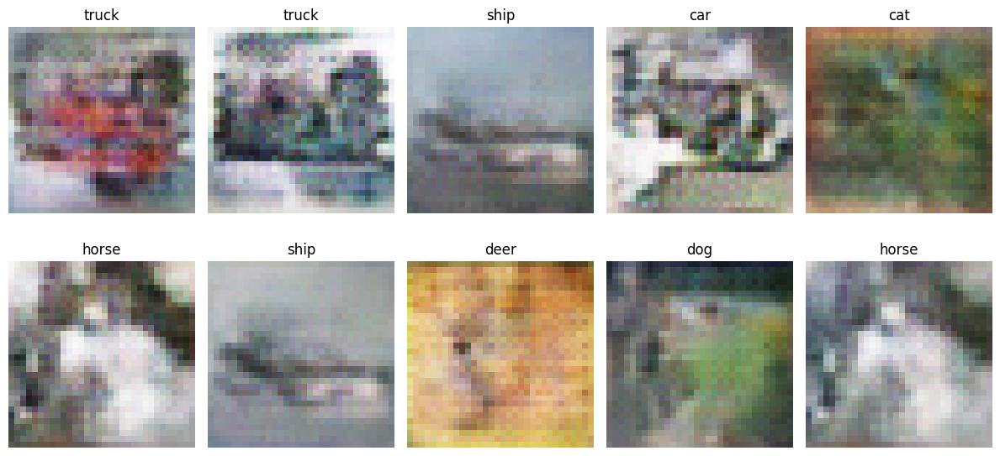

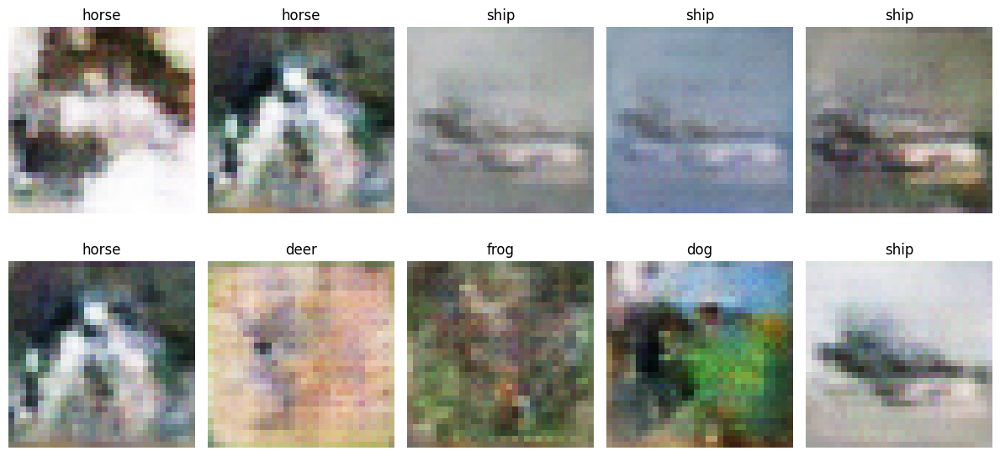

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 60.664161682128906, KID: 0.041735634207725525


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 60.9560546875, KID: 0.04388771951198578


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 49.661376953125, KID: 0.03680025413632393


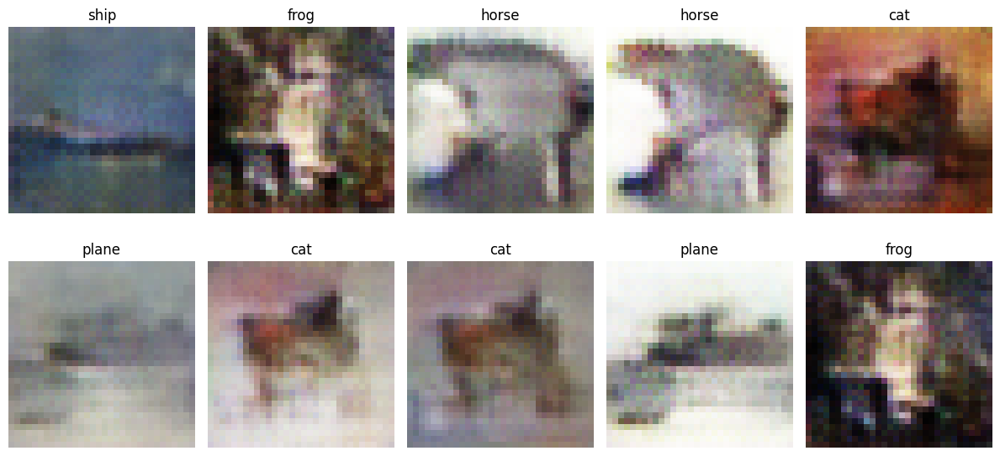

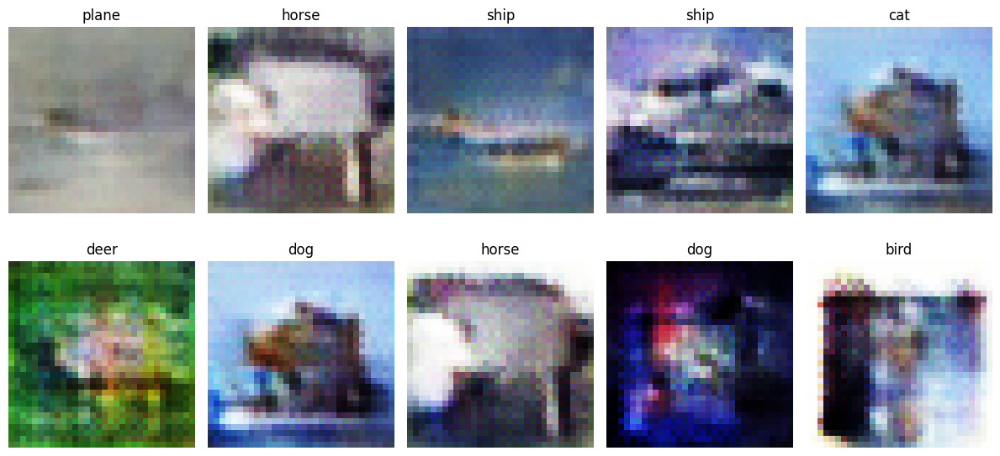

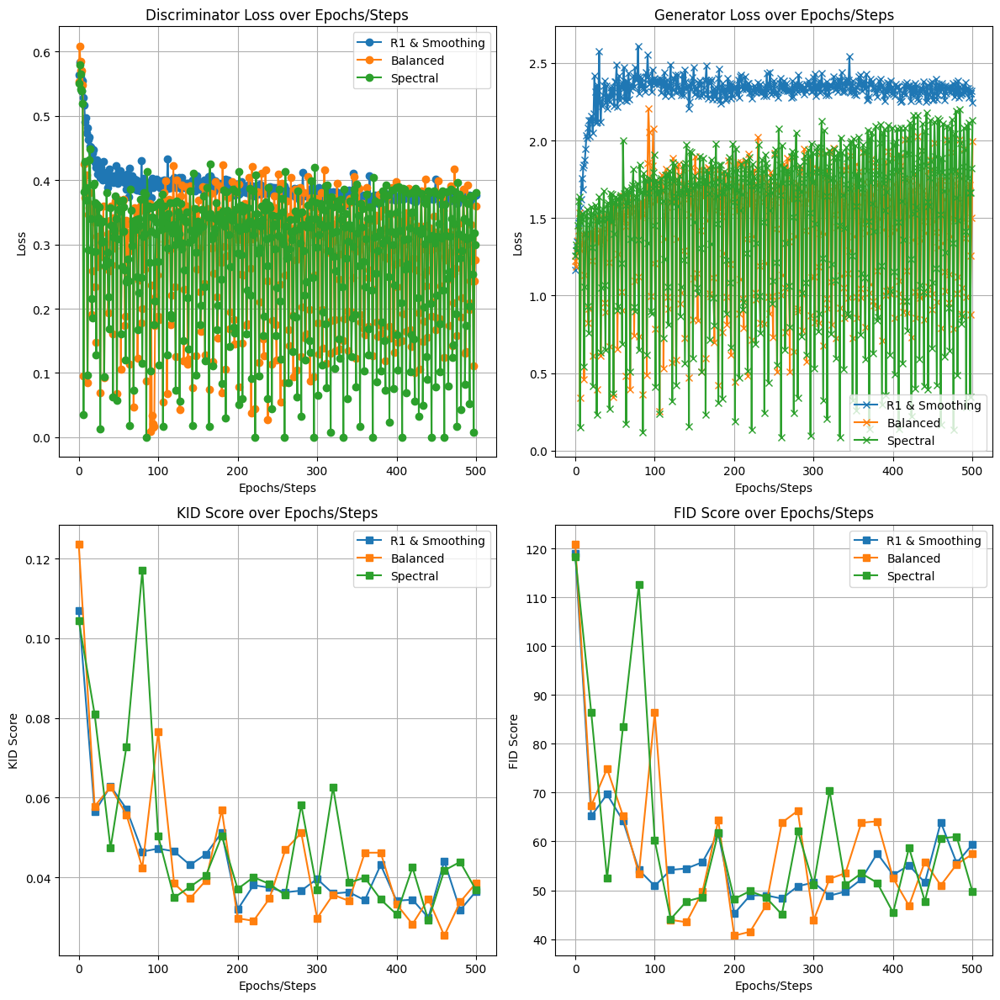

<Figure size 1200x600 with 0 Axes>

In [53]:
gen_simple = ResizeGenerator(128,1024).to(device)
disc_spectral = SpectralDiscriminator().to(device)

sngan = BalancedGAN(gen_simple,disc_spectral,train_loader)
sngan.fit(501,train_loader)
plot_losses(501,[(r1gan,"R1 & Smoothing"), 
               (balancedgan,"Balanced"),(sngan,"Spectral")])

sngan.save("sngan-500e")
torch.cuda.empty_cache()

#### Observations:
- Images definitely look more realistic. The image for a ship and horse look good. Images also seem more diverse unlike before.
- Until around 200 spoehcs, both KID and FID decrease consistently and FID touches a new minimum. But soon after FID begins to dteriorate while KID continues to slowly decrease. 
- While scores are stable, losses seem to oscillate alot but only within a certain range. This could indicate that the discriminator and generator are taking turns to fool each other which is a good thing.

### Enhancing Conditioning

One problem, we constantly observed during training was issues with conditioning the models with the right labels. The model didn't seem to take into account the labels and generated something unrelated. To combat this we will try a variety of approaches and compare them. 

#### Auxillary Classifer

The ACGAN is an extension of the traditional DCGAN (Deep Convolutional Generative Adversarial Network) architecture, introducing an auxiliary classifier to enhance its capabilities. 

![comaprison](https://machinelearningmastery.com/wp-content/uploads/2019/05/Summary-of-the-Differences-Between-the-Conditional-GAN-Semi-Supervised-GAN-InfoGAN-and-AC-GAN-1024x423.png)

##### Dual Classification Tasks:
   - ACGAN incorporates two classification tasks within the discriminator.
   - The first task involves binary classification, distinguishing between real and generated images.
   - The second task focuses on multi-class classification, determining the class labels of the generated images.

##### Auxiliary Classifier:
   - A dedicated auxiliary classifier is integrated into the discriminator to perform the additional classification task.
   - This auxiliary classifier enhances the discriminator's ability to not only discern the authenticity of images but also predict their class labels leading to better diversity of images

##### Combined Objective:
   - The generator and discriminator jointly optimize a combined objective that includes both adversarial loss (real vs. fake) and auxiliary classification loss.
   - This joint optimization encourages the generator to produce not only realistic but also class-specific images.


In [54]:
class ACDiscriminator(nn.Module):
    def __init__(self):
        super(ACDiscriminator, self).__init__()
        
        #self.embed = nn.Embedding(NUM_CLASS,128)
        
        self.conv_layers = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(CHANNELS, 32, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
        
            nn.AvgPool2d(2, stride=2)
        )
        
        
        self.output_layers = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

        self.classifier = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, NUM_CLASS),
            nn.Softmax()
        )
    
    def forward(self, x,label=None):
        
        #labels = self.embed(torch.argmax(labels,axis=1))
        
        output = self.conv_layers(x).squeeze()
        #x = torch.cat((output,labels), dim=1)
        f = self.output_layers(output)
        c = self.classifier(output)
        return f,c


In [55]:
class ACGAN(BalancedGAN):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__(generator, discriminator, train_loader)
        
    def disc_step(self,img,label):
        self.d_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        img.requires_grad = True
        
        # Discriminator Loss
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred, label_pred_fake = self.discriminator(fake_imgs)
        real_pred, label_pred_real = self.discriminator(img)
        
        fake_label = smooth_labels(torch.zeros((img.size()[0], 1), device=device))
        real_label = smooth_labels(torch.ones((img.size()[0], 1), device=device))
    
        r1_loss = self.r1_loss(real_pred, img)
        d_loss = (self.loss(fake_pred, fake_label) + self.loss(real_pred, real_label)) / 2
        d_loss = d_loss + r1_loss
        
        d_loss.backward()
        
        # Classifer Loss
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred, label_pred_fake = self.discriminator(fake_imgs)
        real_pred, label_pred_real = self.discriminator(img)
        
        aux_loss_fake = nn.CrossEntropyLoss()(label_pred_fake, label.float())
        aux_loss_real = nn.CrossEntropyLoss()(label_pred_real, label.float())
        aux_loss = (aux_loss_fake + aux_loss_real) / 2
        aux_loss.backward()
        
        self.d_opt.step()
                
        return d_loss.cpu().item()
    
    def gen_step(self,img,label):
        self.g_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        
        fake_imgs = self.generator(noise, label)
        fake_pred,_ = self.discriminator(fake_imgs, label)
        
        real_label = torch.ones((img.size()[0], 1), device=device)
        
        g_loss = self.loss(fake_pred, real_label)
        
        g_loss.backward()
        self.g_opt.step()
        
        return g_loss.cpu().item()
    
    def get_precision(self, img, label):
        with torch.no_grad():
            img = img.to(device)
            label = label.to(device)
            
            fake_label = smooth_labels(torch.zeros((img.size()[0], 1), device=device))
            real_label = smooth_labels(torch.ones((img.size()[0], 1), device=device))
            
            noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
            fake_imgs = self.generator(noise, label)

            fake_pred,_ = self.discriminator(fake_imgs, label)
            real_pred,_ = self.discriminator(img, label)
            
            tp_r = ((fake_pred  <=  0.5) & (fake_label <= 0.5)).sum().item()
            tp_f = ((real_pred  <=  0.5) & (real_label <= 0.5)).sum().item()
            tp = tp_r + tp_f
            
            fp_r = ((fake_pred >= 0.5) & (fake_label <= 0.5)).sum().item()
            fp_f = ((real_pred >= 0.5) & (real_label <= 0.5)).sum().item()
            fp = fp_r + fp_f
        
            precision = tp / max((tp + fp), 1e-9)  # Avoid division by zero
    
        return precision

Training ACGAN for 501 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 121.42070770263672, KID: 0.12733101844787598


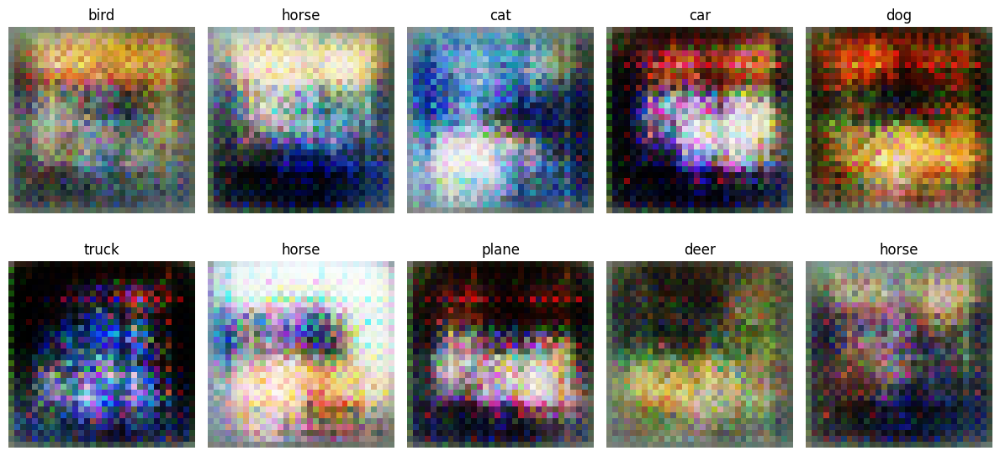

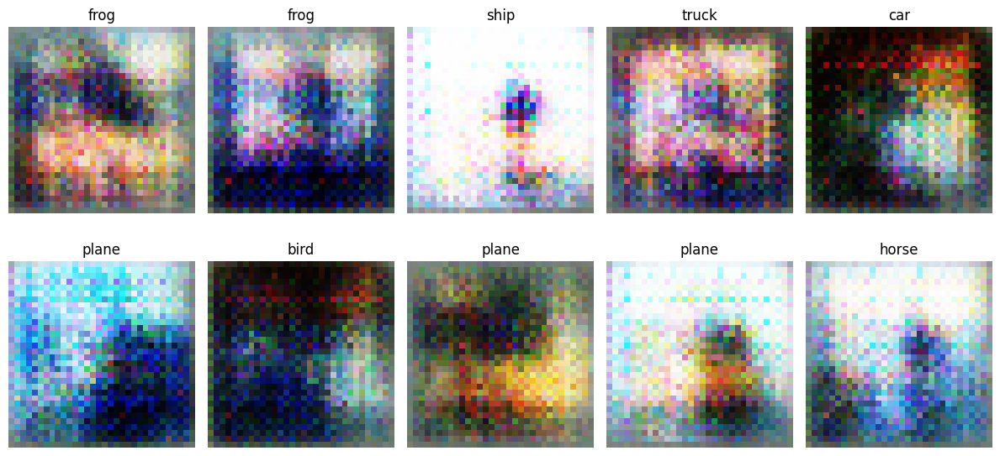

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 74.92557525634766, KID: 0.07161511480808258


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 80.34097290039062, KID: 0.07161049544811249


Training Epoch 51/501: 100%|██████████| 98/98 [00:03<00:00, 25.14it/s, disc_loss=0.528, gen_loss=1.07]


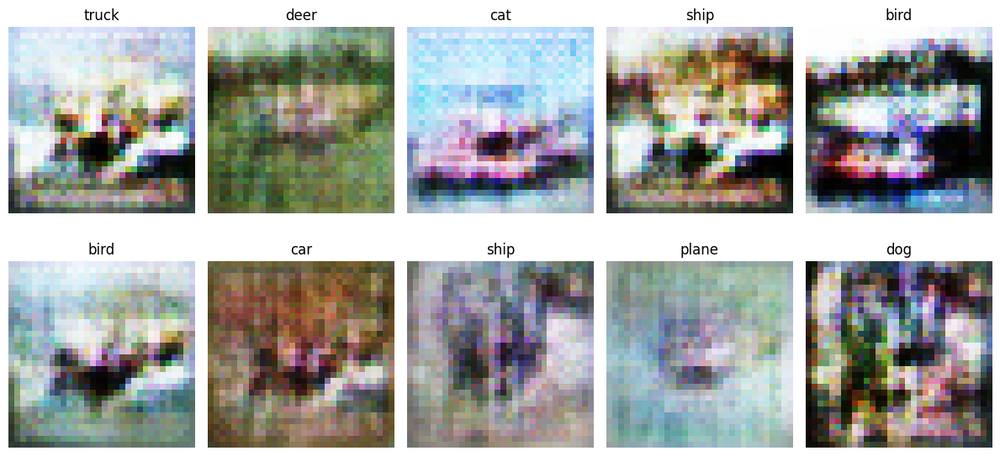

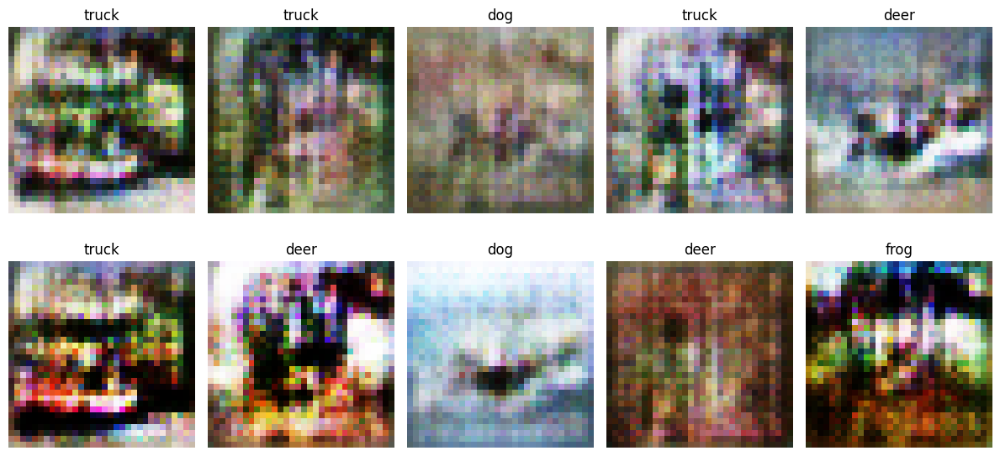

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 71.2068099975586, KID: 0.06732255965471268


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 65.24176788330078, KID: 0.06095496937632561


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 51.00214767456055, KID: 0.04183284565806389


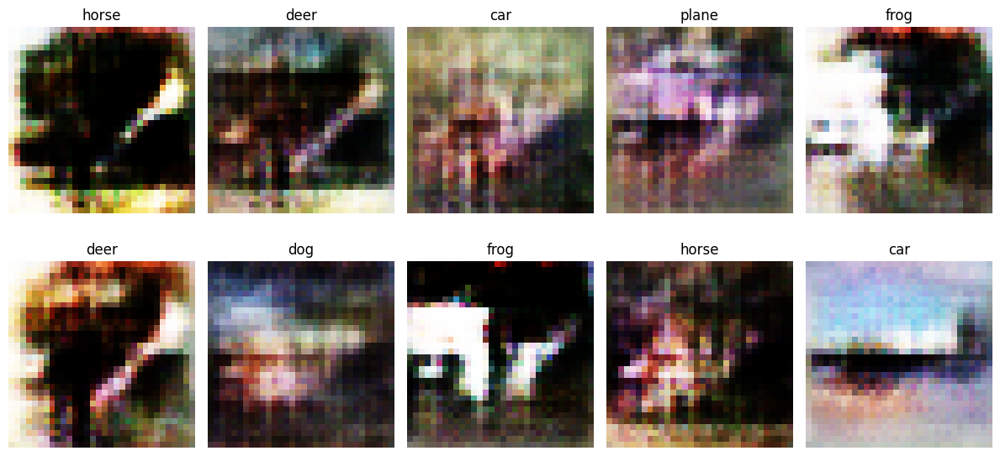

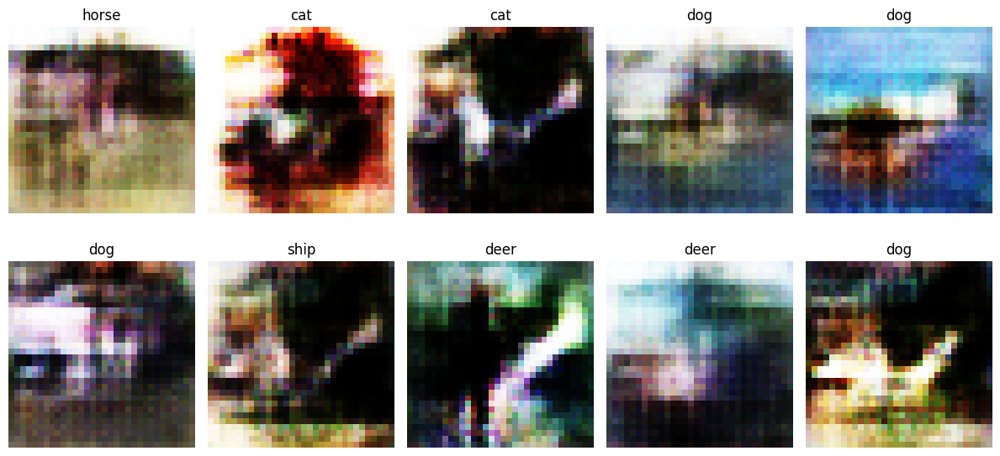

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 68.24649047851562, KID: 0.062145814299583435


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.46623229980469, KID: 0.053866248577833176


Training Epoch 151/501: 100%|██████████| 98/98 [00:04<00:00, 22.85it/s, disc_loss=0.698, gen_loss=3.42]


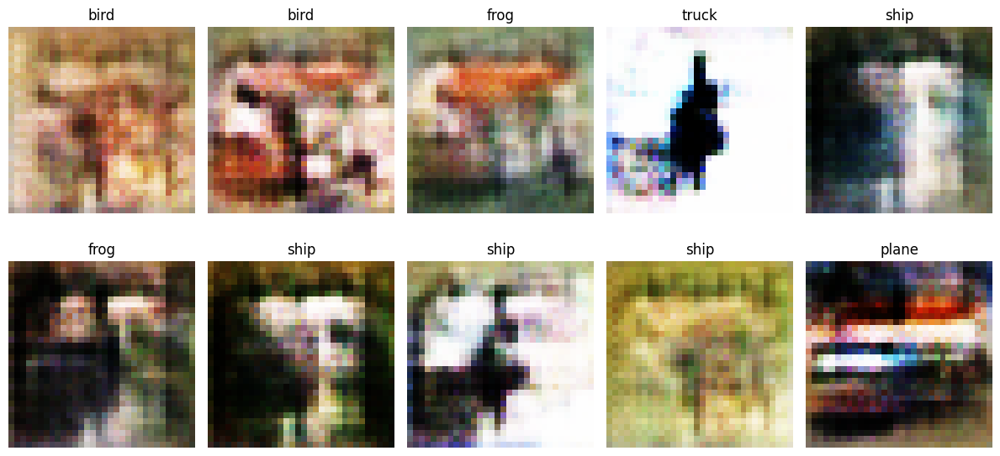

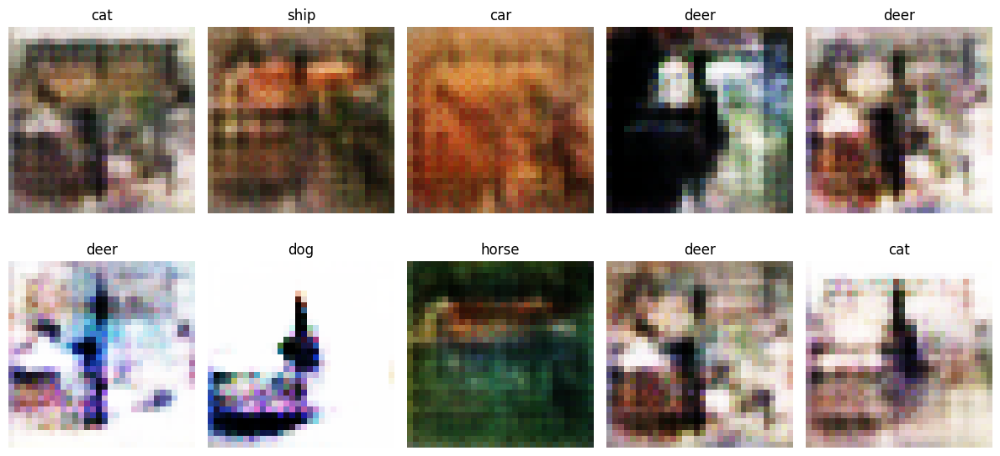

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.67381286621094, KID: 0.04115245118737221


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 166.98594665527344, KID: 0.18025989830493927


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 59.939510345458984, KID: 0.047415997833013535


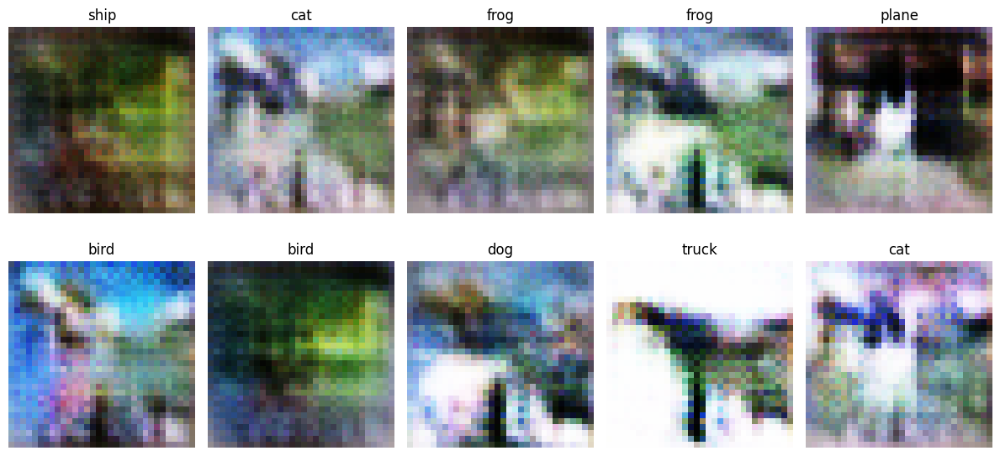

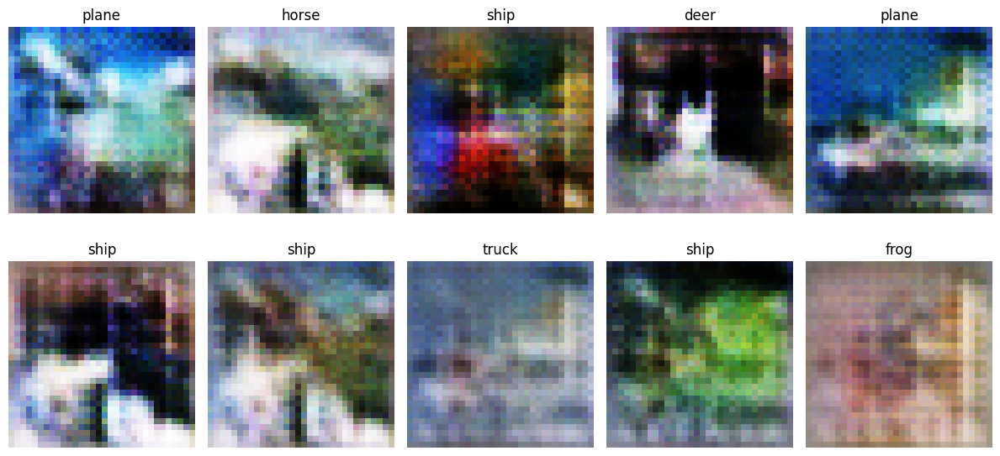

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 84.88069915771484, KID: 0.07181853801012039


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 57.13568878173828, KID: 0.04434883967041969


Training Epoch 251/501: 100%|██████████| 98/98 [00:03<00:00, 30.04it/s, disc_loss=0.369, gen_loss=2.44]


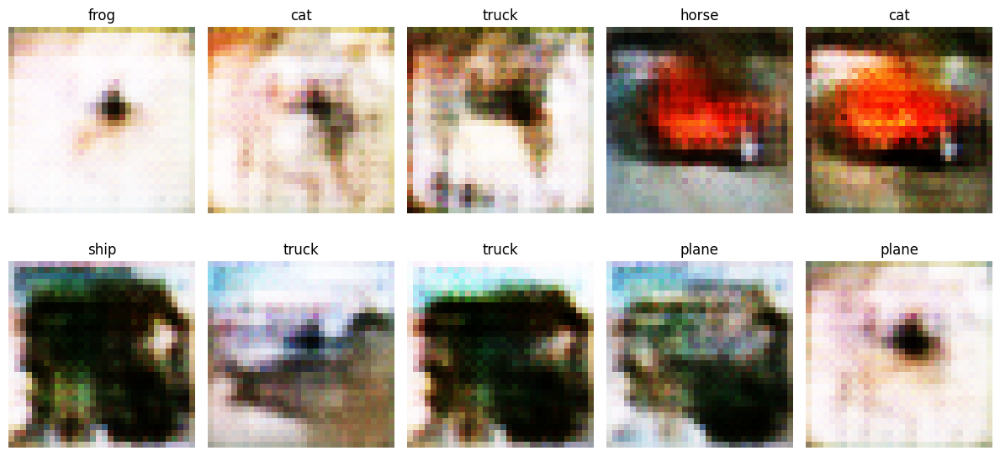

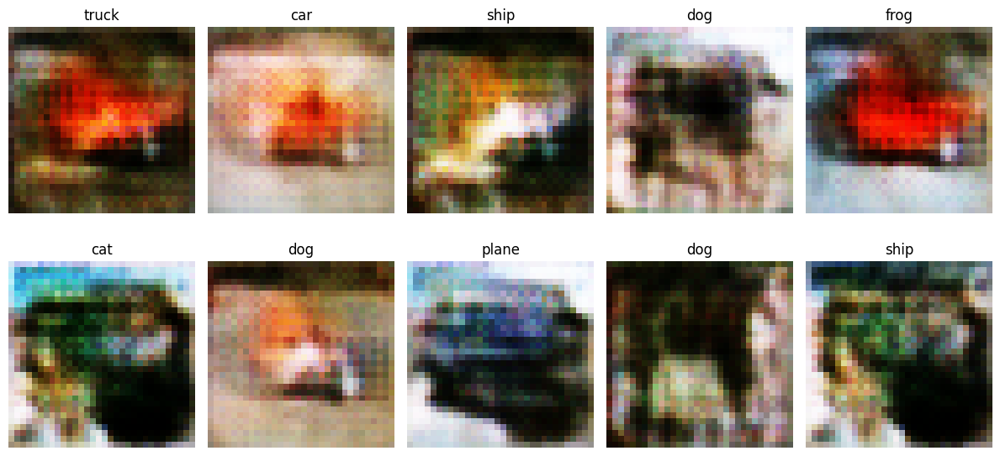

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 67.94567108154297, KID: 0.048751965165138245


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 63.32770538330078, KID: 0.054315175861120224


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 59.989845275878906, KID: 0.04810653254389763


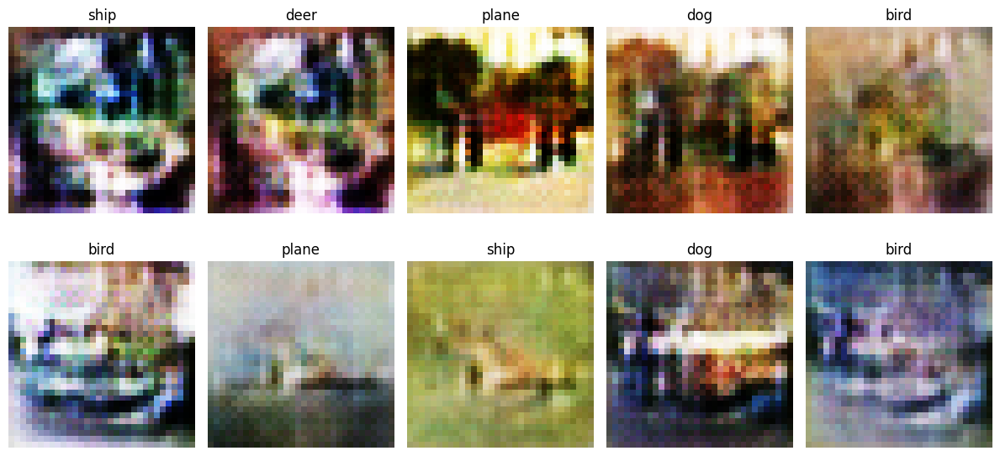

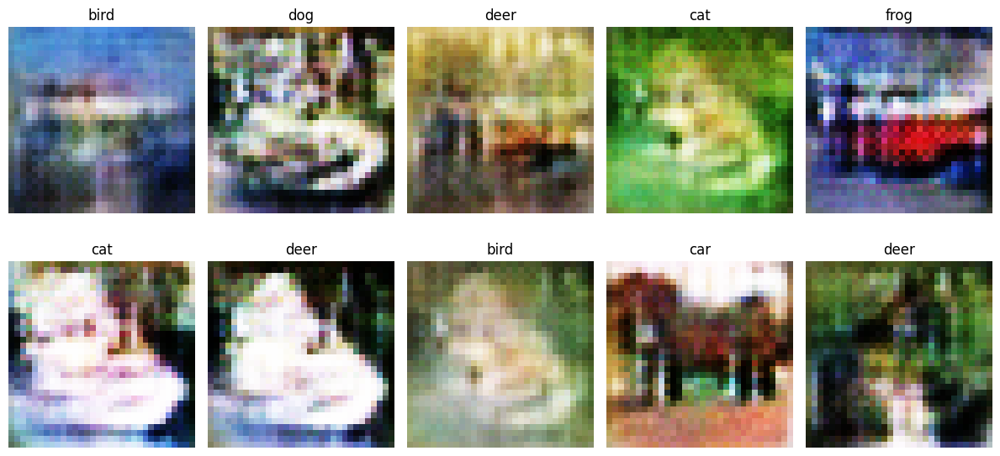

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 56.3382453918457, KID: 0.04644738510251045


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 60.95038986206055, KID: 0.05010538920760155


Training Epoch 351/501: 100%|██████████| 98/98 [00:02<00:00, 43.42it/s, gen_loss=1.81]                 


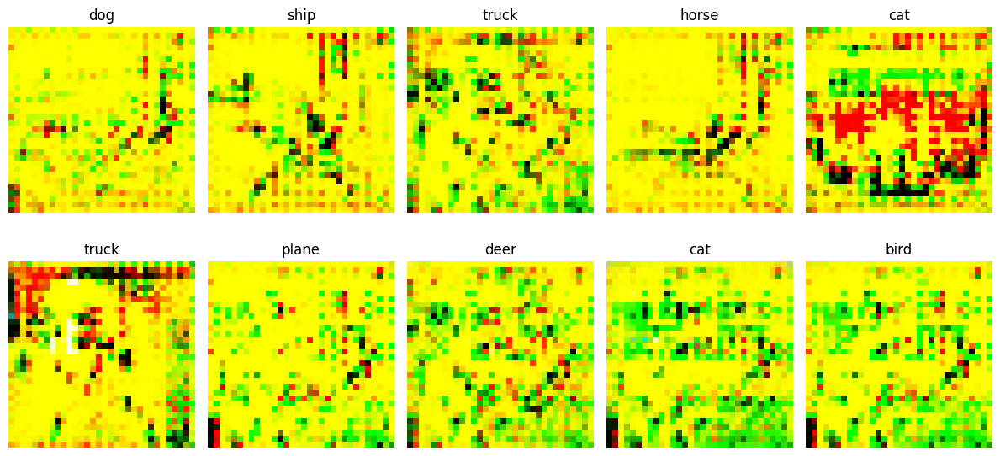

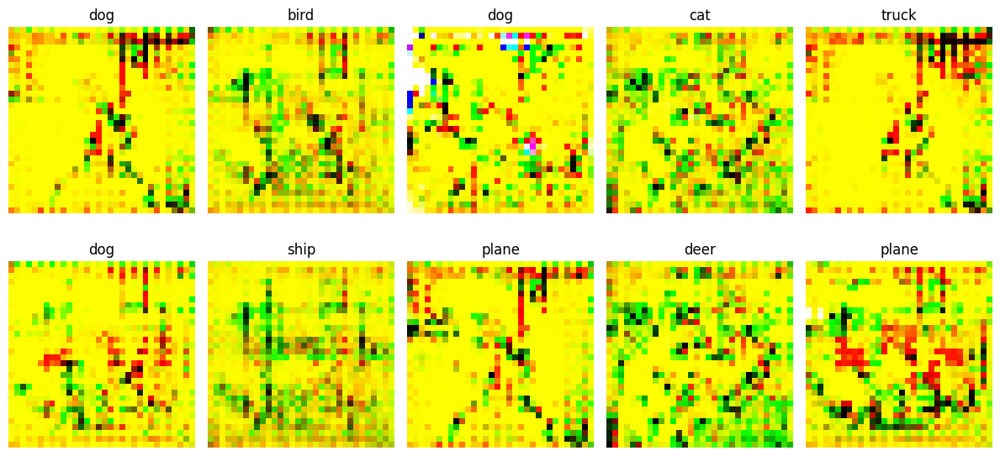

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 133.918212890625, KID: 0.13439655303955078


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 82.82144165039062, KID: 0.06408078223466873


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 55.0870475769043, KID: 0.042650409042835236


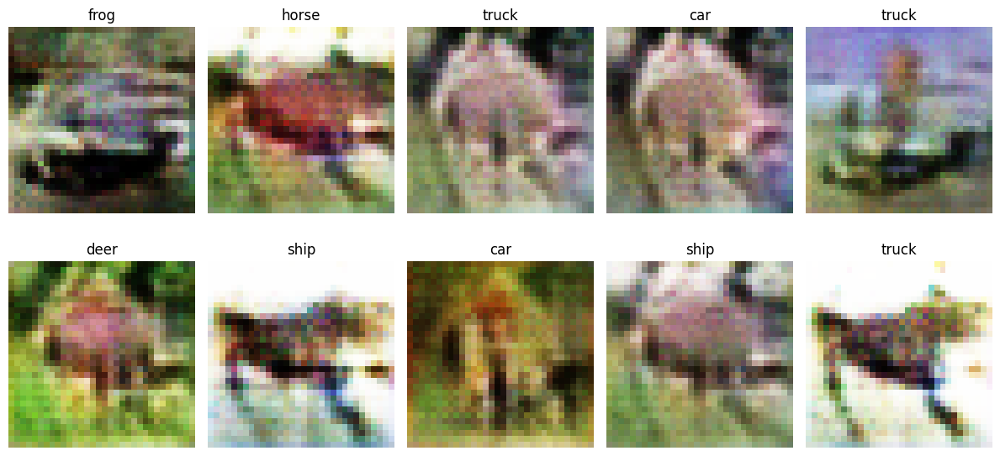

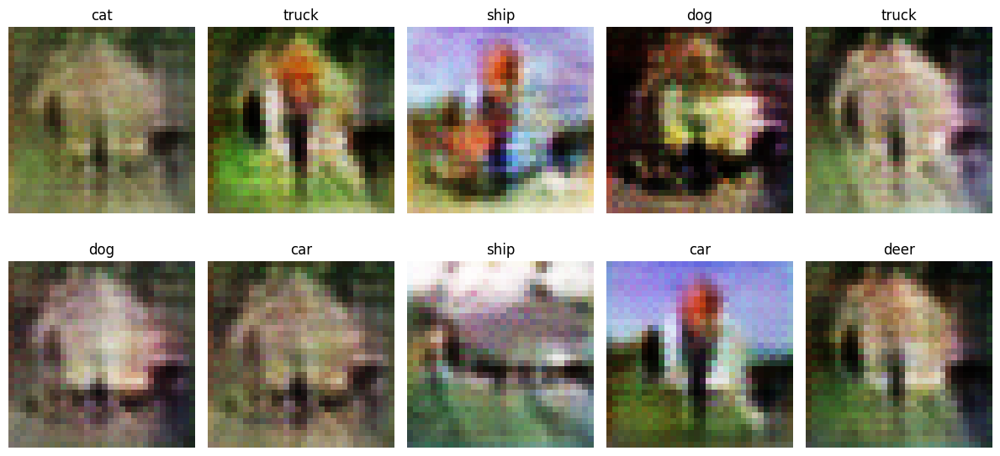

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.78739547729492, KID: 0.036700546741485596


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 40.46397018432617, KID: 0.03264511376619339


Training Epoch 451/501: 100%|██████████| 98/98 [00:01<00:00, 52.13it/s, gen_loss=0.538]


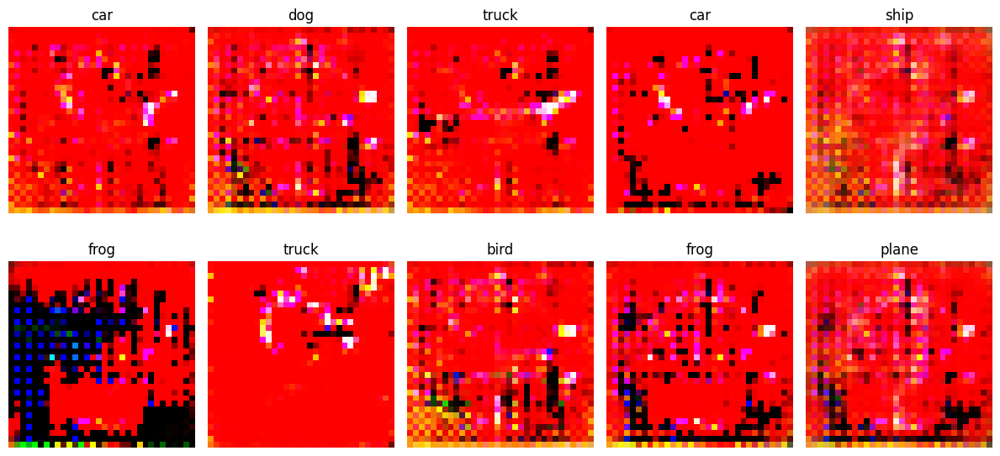

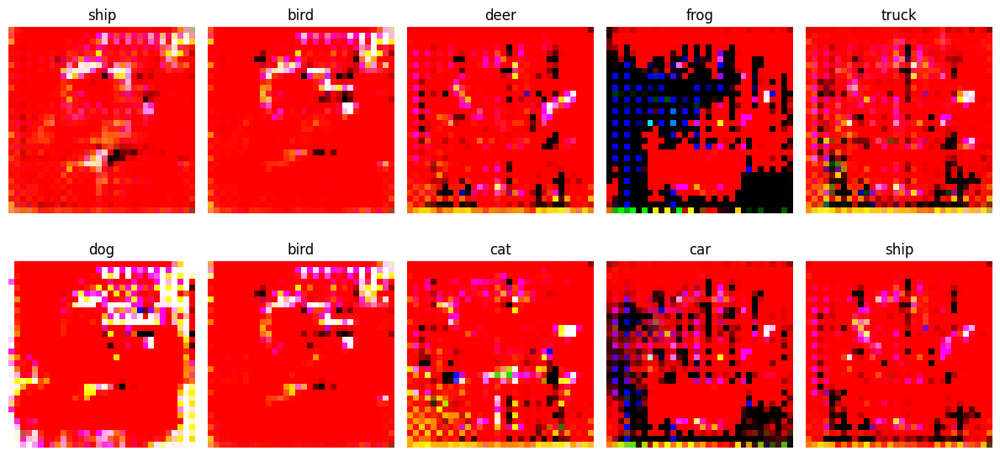

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 259.589599609375, KID: 0.3383238613605499


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 54.721527099609375, KID: 0.04857427999377251


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 44.06201934814453, KID: 0.0339730903506279


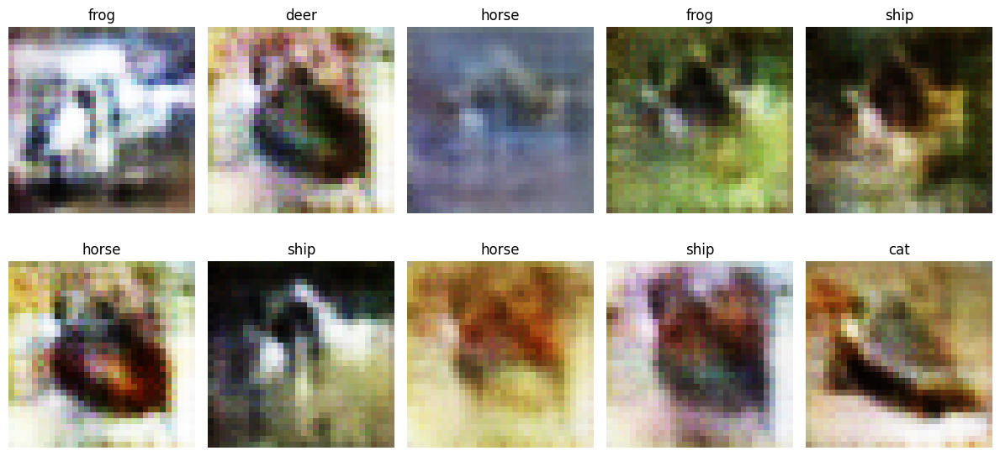

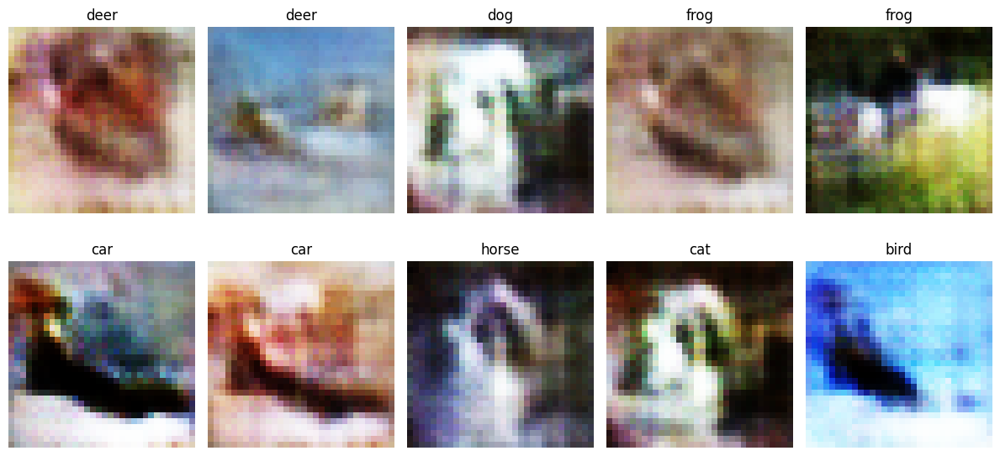

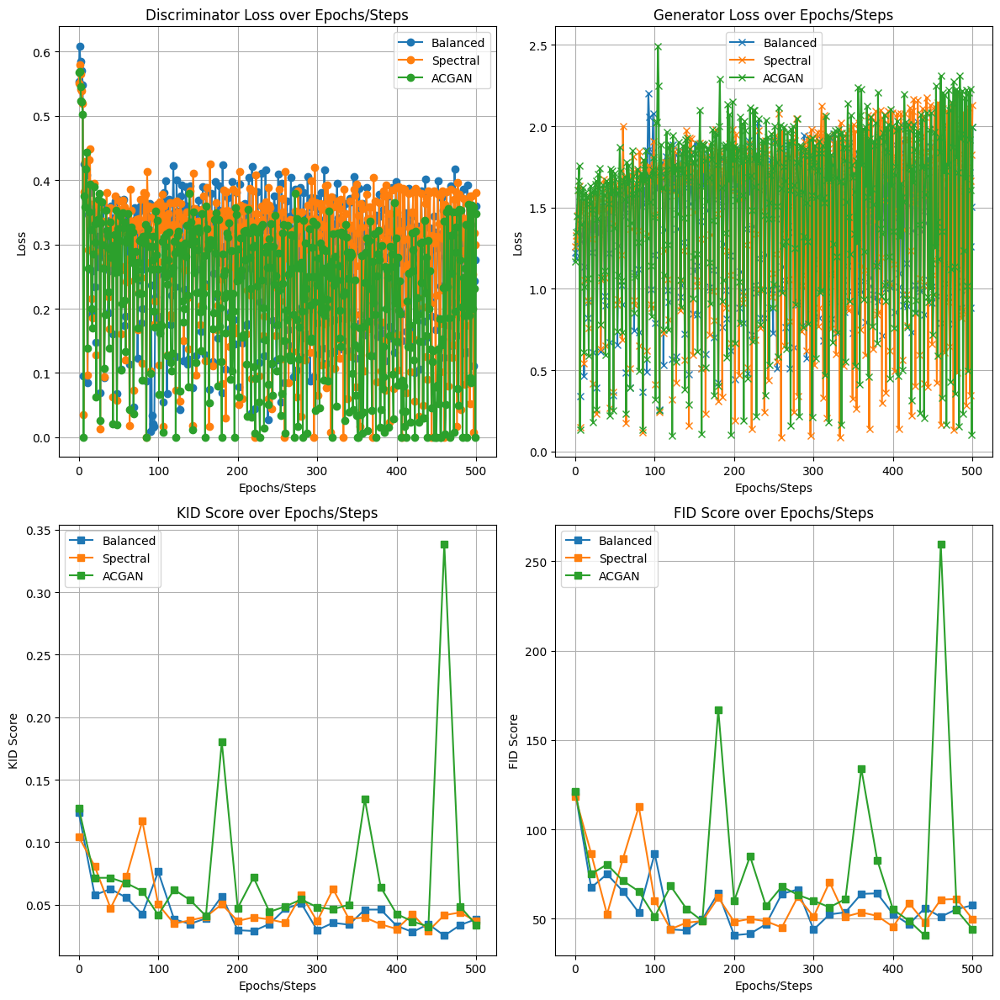

<Figure size 1200x600 with 0 Axes>

In [56]:
gen_imp = ResizeGenerator(128,1024).to(device)
ac_spectral = ACDiscriminator().to(device)

acgan = ACGAN(gen_imp,ac_spectral,train_loader)
acgan.fit(501,train_loader)
plot_losses(501,[ (balancedgan,"Balanced"),(sngan,"Spectral"),
              (acgan,"ACGAN")])

acgan.save("acgan-500e")
torch.cuda.empty_cache()

#### Observations:

- In terms of FID, this one is more unstable due as you can see random spikes here and there. 
- The loss seems more compact and stable
- Due to instability in FID it was difficult to see the diversity of images but some classes like ships and horse somewhat resembled it.

### More Improvements

#### Use of Embeddings
So far, our conditioning only targets the discriminator. To better condition the generator, we will be expanding on the idea of concatenation by using embeddings to condition the noise at latent layers.

Right now we are just concatenating once and moving one. This approach seems flawed to us because in a latent array of 128 element, it's hard to control the output using 10 elements at the end. Most likely the model will forget whatever label information was embedded.

Now we will try to mutliply the noise vector with the label embeddings. This is to ensure the label has a large impact of the intial state of the latent vector. So the difference between the model's latent dim when the label changes should be drastic so the subsequent steps will be different from each other. 

#### Modifying the Generator Loss

By observing the generator, I found out that it was not really learning the labels correctly. If you think about it, we only backpropagate using the classifier labels in the discriminator. The discirminator gets good at identifying labels. But that information is barely passed to the generator. How will the generator know that this label is related to a certain output. To explicity pass that information to the generator, I propose that we modify the generator loss function to include a classifier loss. 

What is a classifer loss? Just like in ACGAN, the discriminator backpropagtes using the classifier loss, we will use the same classifier loss to backpropagate the generator. So when we get predictions from a discriminator during the gen_step, we will get the class labels predicted by the discirminator. We will then compare these class labels to the labels that were passed to the generator to prompt it to generator a certain type of image. 

This additional backpropagation helps the discriminator learn that this label input should produce a certain label output in the generator. So the generator will essentially learn to get the classes correct. 

So how do we blend in this classifier loss. Well, I initially tried to simply add the regular generator loss and this new classifier loss. But the result I obtained were very poor. I played around the parameters and eventully found that using a weighted sum of the regular loss and the classifier loss worked best. Specifially a 70-30 weight in favour of the regular loss.


In [60]:
# Generator architecture
class EmbGenerator(nn.Module):
    def __init__(self, latent_dim, hidden_dim):
        super(EmbGenerator, self).__init__()
        
        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        
        self.embed = nn.Embedding(NUM_CLASS, 128)
        
        self.input_layers = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(0.1, inplace=True)
        )
        
        self.conv_layers = nn.Sequential(
            nn.ConvTranspose2d(int(hidden_dim/4), 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(True),
            
            nn.ConvTranspose2d(32, CHANNELS, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(CHANNELS),
            nn.LeakyReLU(True),
        
            nn.Tanh()
        )

        
    def forward(self, noise, classes):

        labels = self.embed(torch.argmax(classes, dim=1))
        
        #inputs = torch.cat((labels, noise), 1)
        inputs = torch.mul(labels, noise)
        outputs = self.input_layers(inputs)
        
        reshape_shape = int(self.hidden_dim/4)
        outputs = torch.reshape(outputs, (outputs.size()[0], reshape_shape, 2, 2))
        return self.conv_layers(outputs)


In [61]:
class EmbedACGAN(ACGAN):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__(generator, discriminator, train_loader)
    
    def gen_step(self,img,label):
        self.g_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        
        fake_imgs = self.generator(noise, label)
        fake_pred,classifier = self.discriminator(fake_imgs, label)
        
        real_label = torch.ones((img.size()[0], 1), device=device)

        aux_loss_fake = nn.CrossEntropyLoss()(classifier, label.float())
        g_loss = self.loss(fake_pred, real_label)*0.7 + aux_loss_fake*0.3
        
        
        g_loss.backward()
        self.g_opt.step()
        
        return g_loss.cpu().item()

Training EmbedACGAN for 201 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 120.8494644165039, KID: 0.12496890127658844


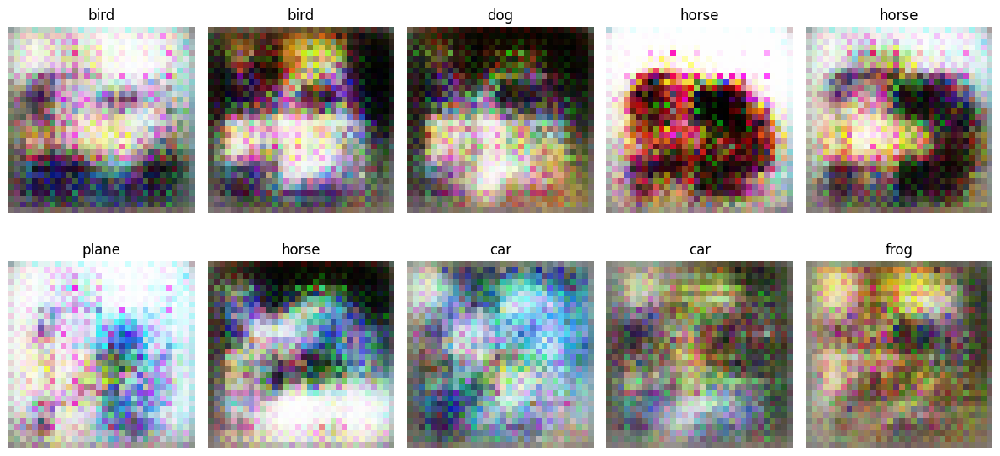

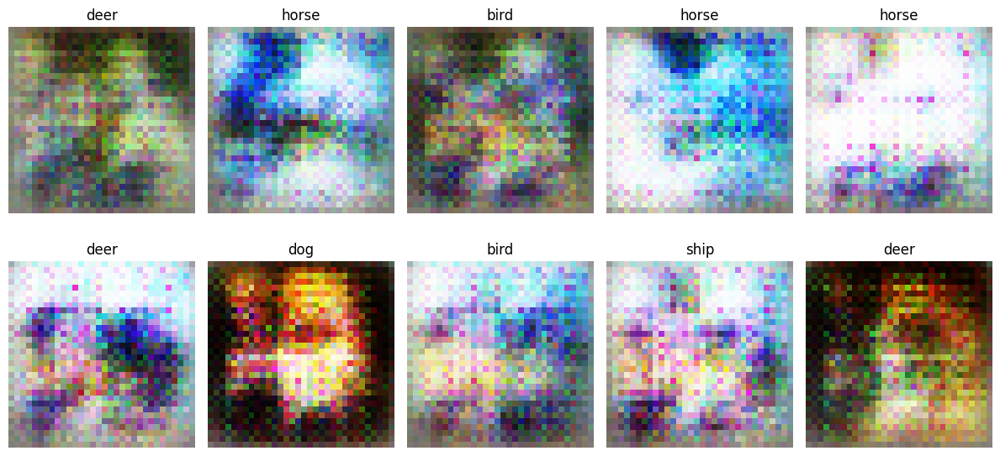

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 60.29642105102539, KID: 0.0544266514480114


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 61.54356384277344, KID: 0.05552015081048012


Training Epoch 51/201: 100%|██████████| 98/98 [00:03<00:00, 26.39it/s, disc_loss=0.484, gen_loss=1.57]


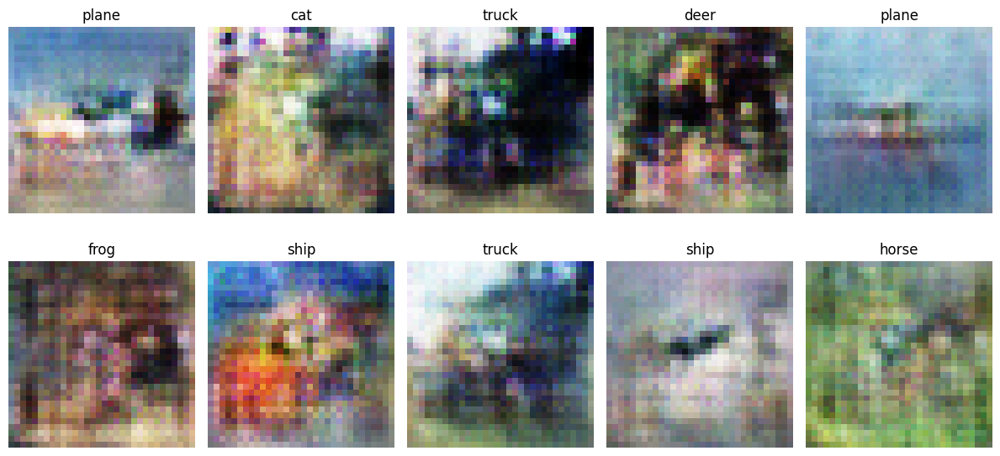

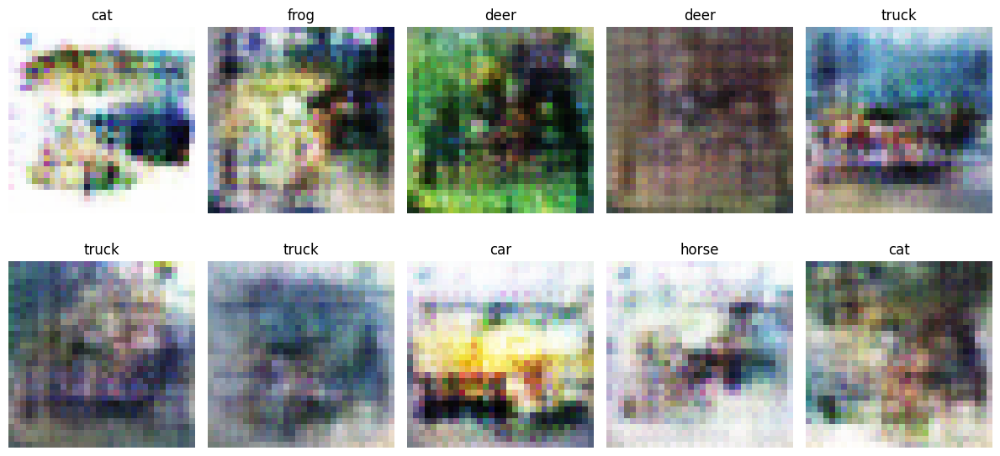

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 92.02079010009766, KID: 0.09327535331249237


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 50.23191452026367, KID: 0.04436388984322548


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 53.39084243774414, KID: 0.04365163668990135


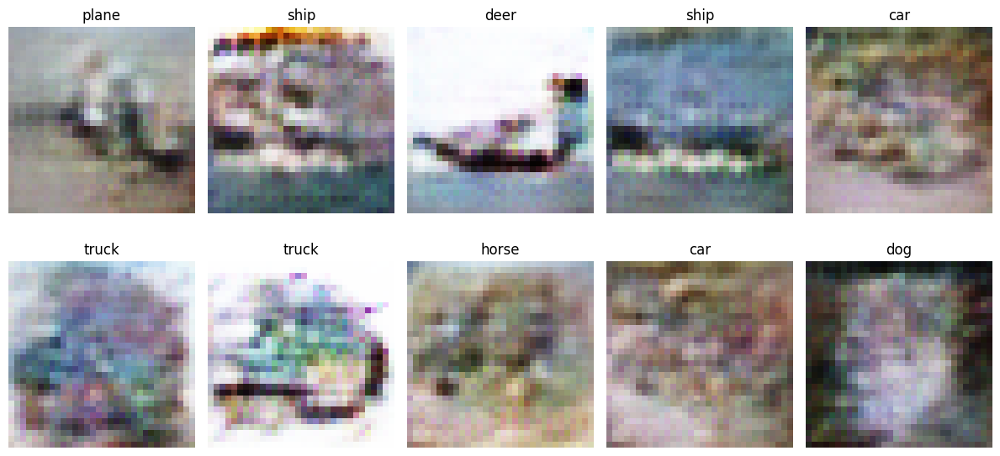

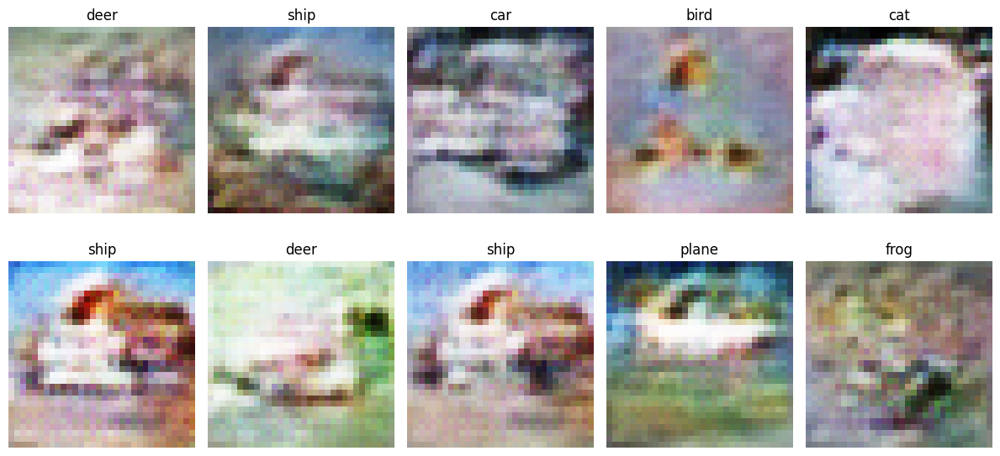

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 43.2374267578125, KID: 0.0353148989379406


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 42.34085464477539, KID: 0.03285668417811394


Training Epoch 151/201: 100%|██████████| 98/98 [00:04<00:00, 24.09it/s, disc_loss=0.454, gen_loss=1.54]


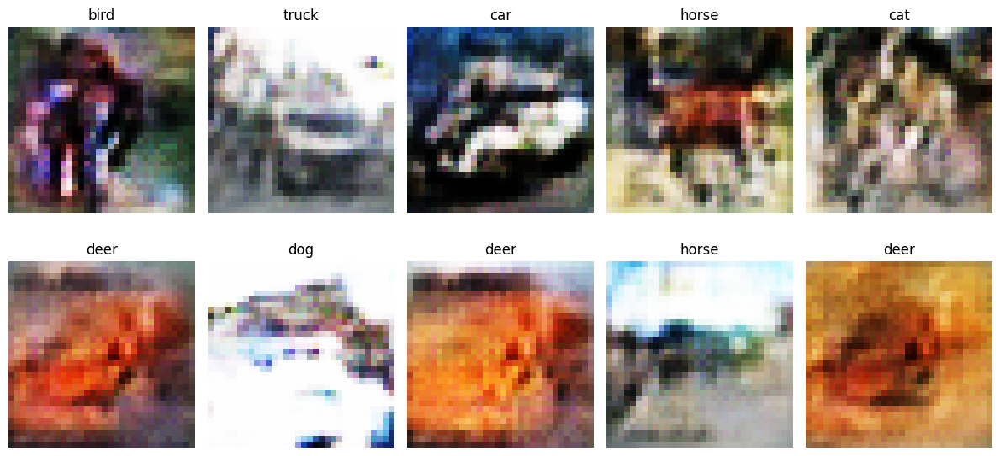

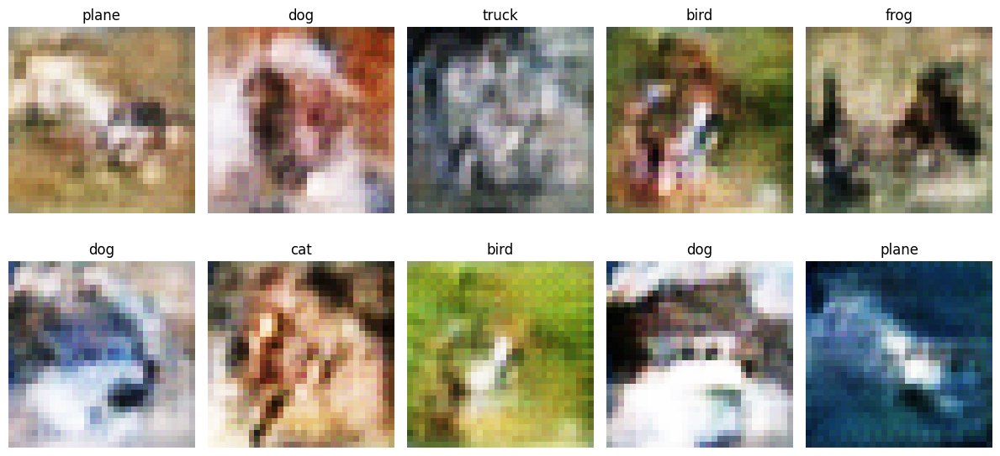

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 41.674072265625, KID: 0.033479221165180206


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 46.608787536621094, KID: 0.0358121395111084


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 30.604801177978516, KID: 0.02268698811531067


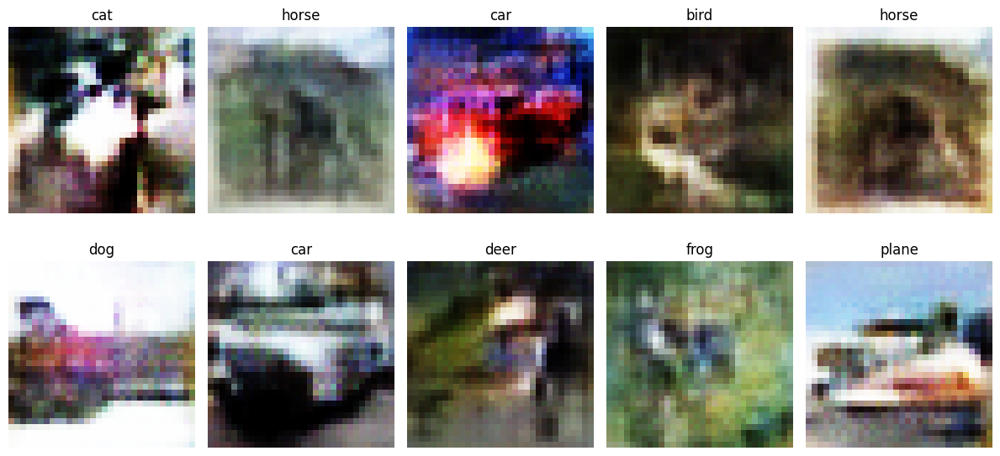

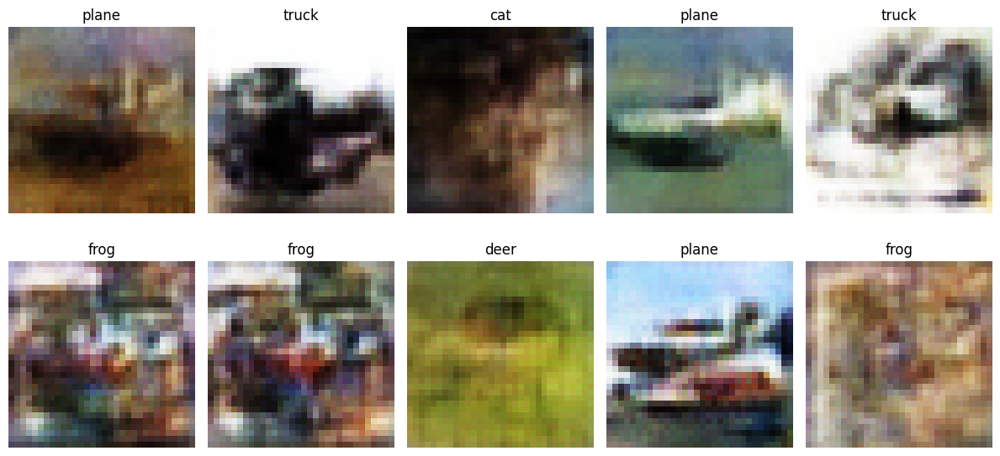

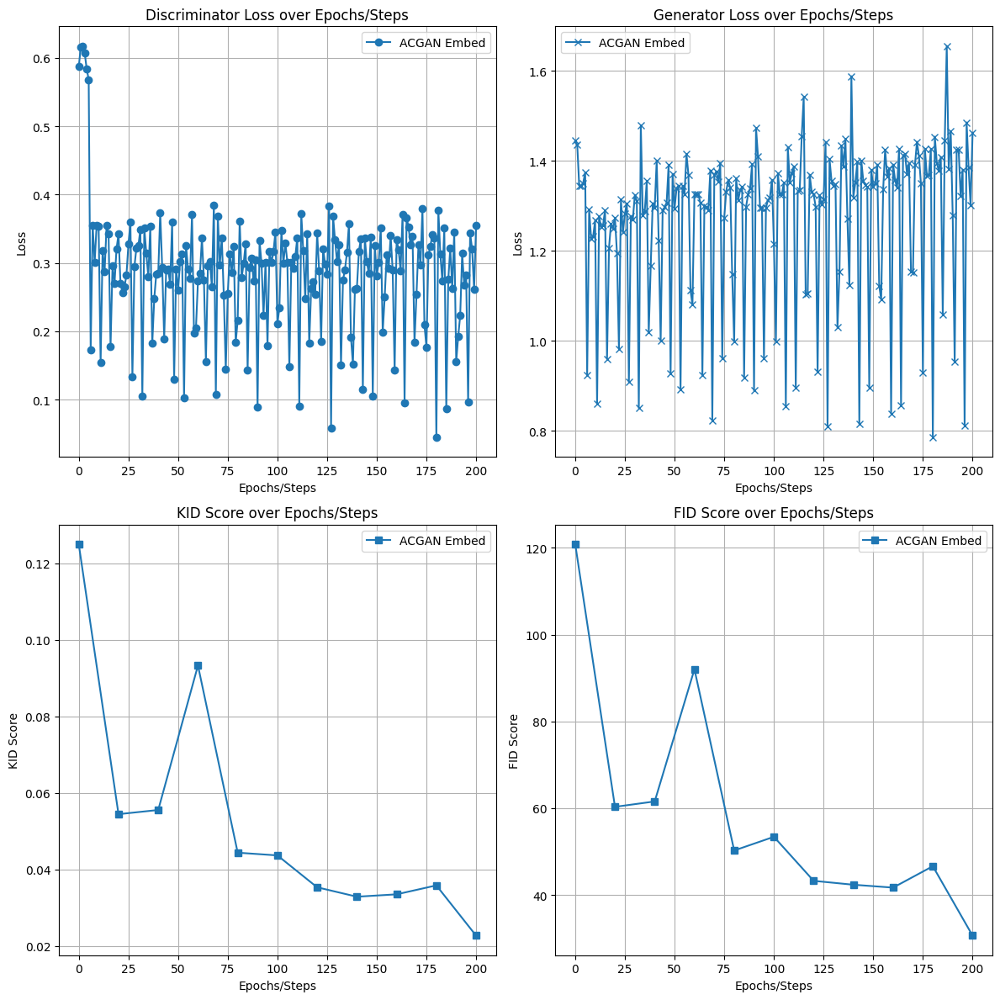

<Figure size 1200x600 with 0 Axes>

In [98]:
gen_shared = EmbGenerator(128,1024).to(device)
ac_spectral = ACDiscriminator().to(device)

acgan_embed = EmbedACGAN(gen_shared,ac_spectral,train_loader)
acgan_embed.fit(201,train_loader)
plot_losses(201,[ (acgan_embed,"ACGAN Embed")])

acgan_embed.save("acgan_embed-500e")
torch.cuda.empty_cache()

#### Observations:
- The FID seemed to improve alot and the images seemed to fit the class more
- Ideas of using embeddings seems promising
- Training is relatively stable with few collapses here and there.

### DiffAugment

As explained in an earlier section, using diff augment has been shown by researchers to greatly improve FID scores. We will utilise the Kornia library to modify the Discriminator. We will be applying Augmentation to all data that enters the discriminator in line with the "Augment Everywhere" approach. 

In [85]:
augment = nn.Sequential(
    K.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2, p=0.5),
    K.RandomAffine(degrees=0, translate=(0.2, 0.2), scale=(1.0, 1.0), p=0.5),
    K.RandomErasing(scale=(0.1, 0.2), ratio=(0.3, 3.3), same_on_batch=False, p=0.5)
)

In [86]:
class ACAugDiscriminator(nn.Module):
    def __init__(self):
        super(ACAugDiscriminator, self).__init__()
        
        self.conv_layers = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(CHANNELS, 32, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
        
            nn.AvgPool2d(2, stride=2)
        )
        
        
        self.output_layers = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

        self.classifier = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Linear(512, NUM_CLASS),
            nn.Softmax()
        )
        if augment is not None:
            self.augment = augment
        else:
            self.augment = nn.Identity()
    def forward(self, x,label=None, aug=True):
        if self.training and aug==True:
            x = self.augment(x)
        #labels = self.embed(torch.argmax(labels,axis=1))
        
        output = self.conv_layers(x).squeeze()
        #x = torch.cat((output,labels), dim=1)
        f = self.output_layers(output)
        c = self.classifier(output)
        return f,c


removing r1 loss since we are using DiffAugment.

In [87]:
class DiffGAN(EmbedACGAN):
    def __init__(self, generator, discriminator, train_loader):
        super().__init__(generator, discriminator, train_loader)
        
    def disc_step(self,img,label):
        self.d_opt.zero_grad()
        
        img = img.to(device)
        label = label.to(device)
        img.requires_grad = True
        
        # Discriminator Loss
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred, label_pred_fake = self.discriminator(fake_imgs)
        real_pred, label_pred_real = self.discriminator(img)
        
        fake_label = smooth_labels(torch.zeros((img.size()[0], 1), device=device))
        real_label = smooth_labels(torch.ones((img.size()[0], 1), device=device))
    
        d_loss = (self.loss(fake_pred, fake_label) + self.loss(real_pred, real_label)) / 2
        
        d_loss.backward()
        
        # Classifer Loss
        noise = torch.normal(0, 1, (img.size()[0], self.generator.latent_dim), device=device)
        fake_imgs = self.generator(noise, label)
        
        fake_pred, label_pred_fake = self.discriminator(fake_imgs)
        real_pred, label_pred_real = self.discriminator(img)
        
        aux_loss_fake = nn.CrossEntropyLoss()(label_pred_fake, label.float())
        aux_loss_real = nn.CrossEntropyLoss()(label_pred_real, label.float())
        aux_loss = (aux_loss_fake + aux_loss_real) / 2
        aux_loss.backward()
        
        self.d_opt.step()
                
        return d_loss.cpu().item()


I will be training this for 200 epochs only since the model takes 5x longer than previous models to train. I can't compare them directly cuz the epochs are different. 

Training DiffGAN for 201 Epochs


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 130.06069946289062, KID: 0.13312369585037231


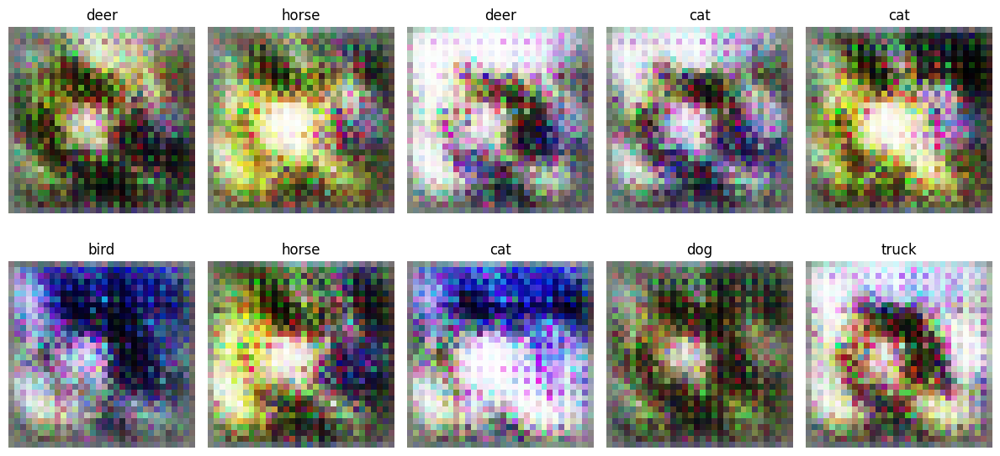

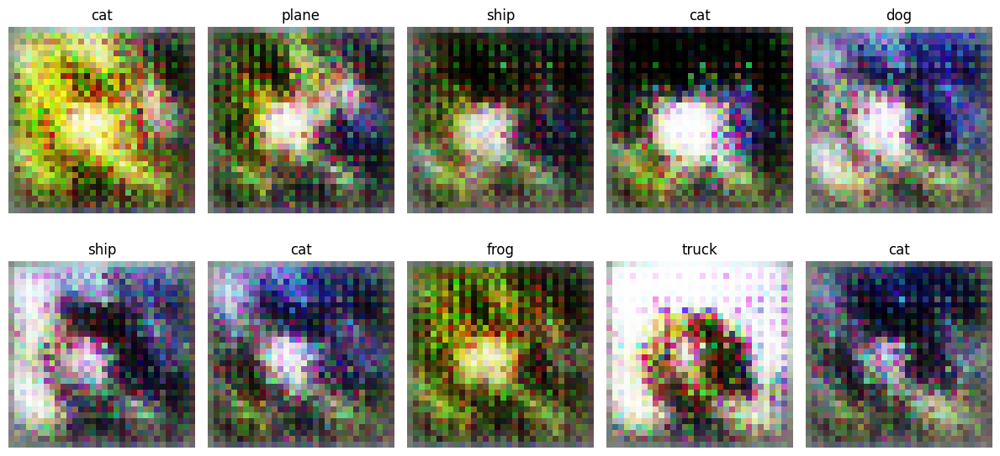

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 58.730560302734375, KID: 0.04517936706542969


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 41.49292755126953, KID: 0.03215952217578888


Training Epoch 51/201: 100%|██████████| 98/98 [00:11<00:00,  8.22it/s, gen_loss=1.75]                 


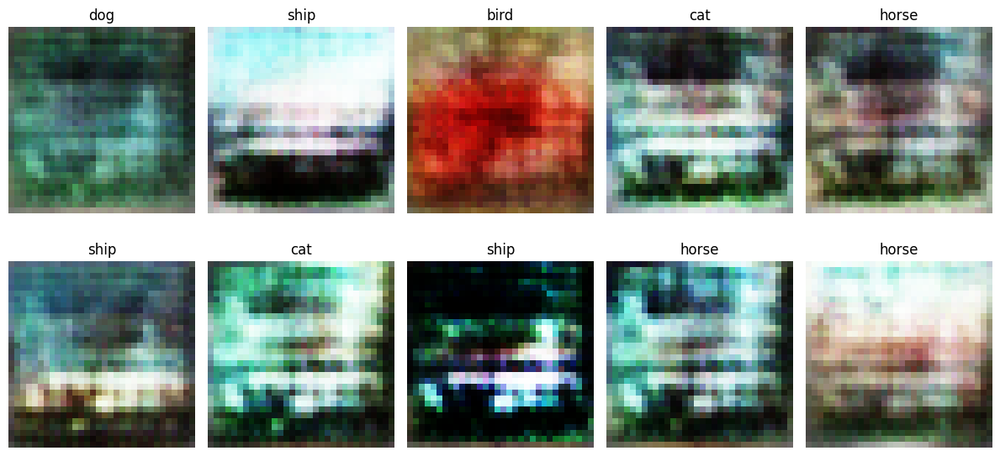

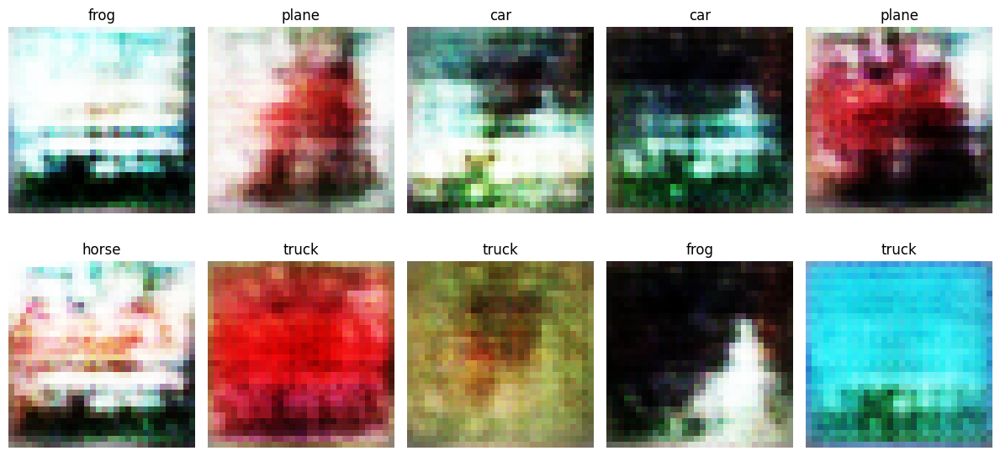

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 45.41862869262695, KID: 0.03369811922311783


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 48.75973129272461, KID: 0.03827647864818573


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 36.560211181640625, KID: 0.027411479502916336


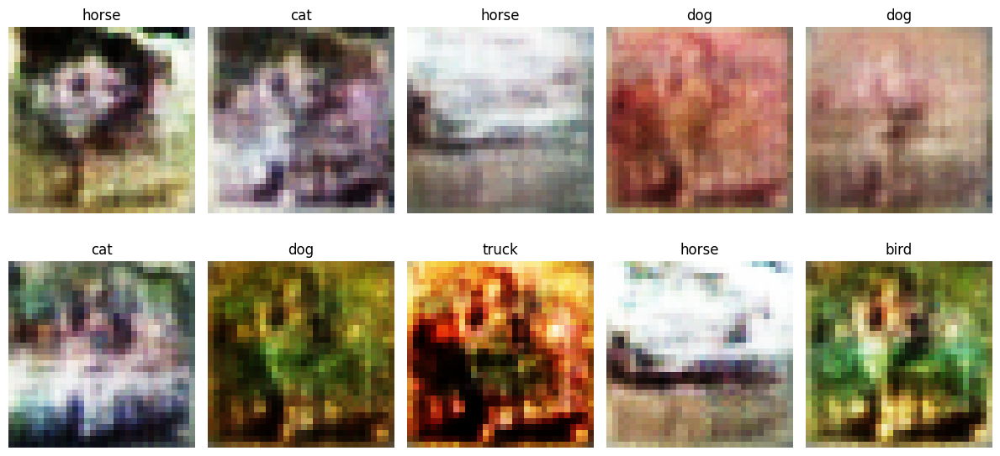

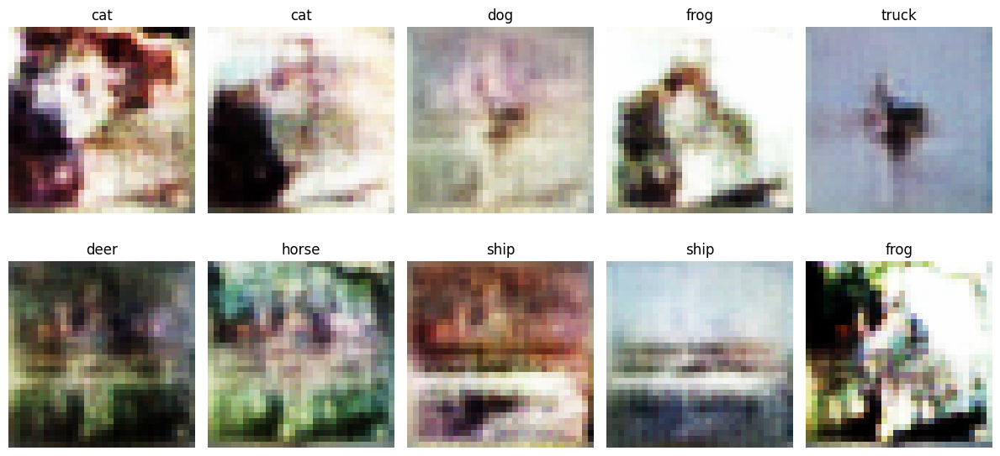

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 299.370849609375, KID: 0.41113391518592834


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 291.2506408691406, KID: 0.41043558716773987


Training Epoch 151/201: 100%|██████████| 98/98 [00:09<00:00, 10.77it/s, gen_loss=2.32]


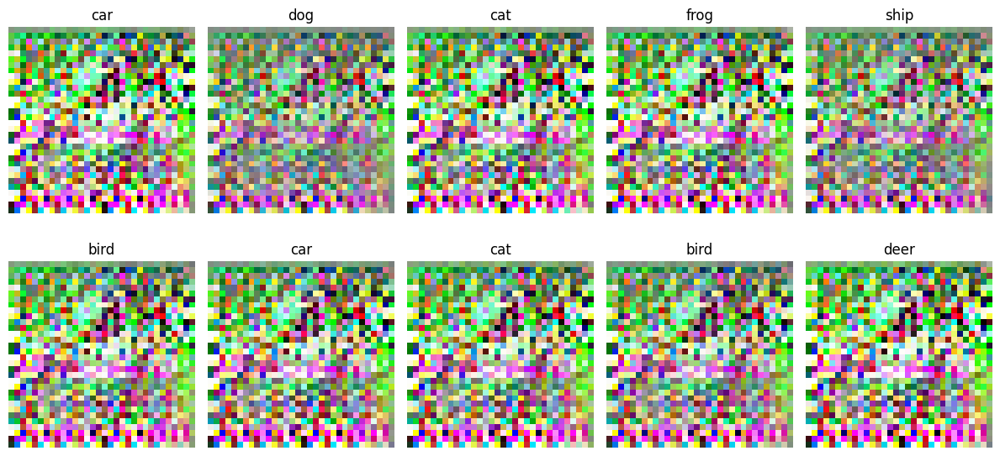

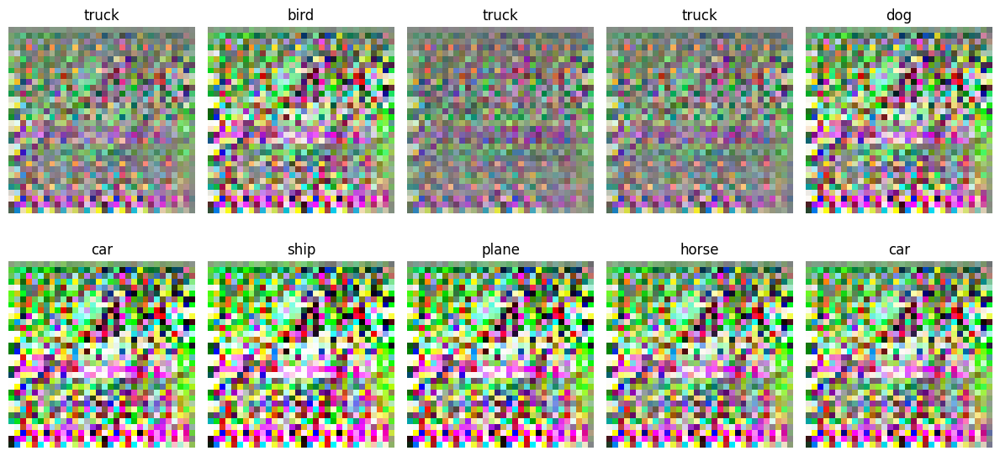

100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 290.7508544921875, KID: 0.40609511733055115


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 372.57403564453125, KID: 0.6114421486854553


100%|██████████| 19/19 [00:09<00:00,  1.99it/s]


FID: 342.0776672363281, KID: 0.5195409059524536


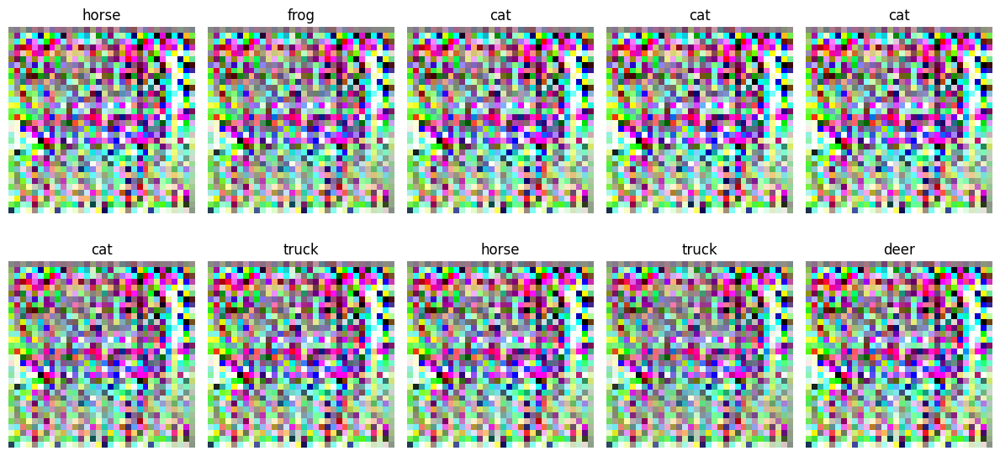

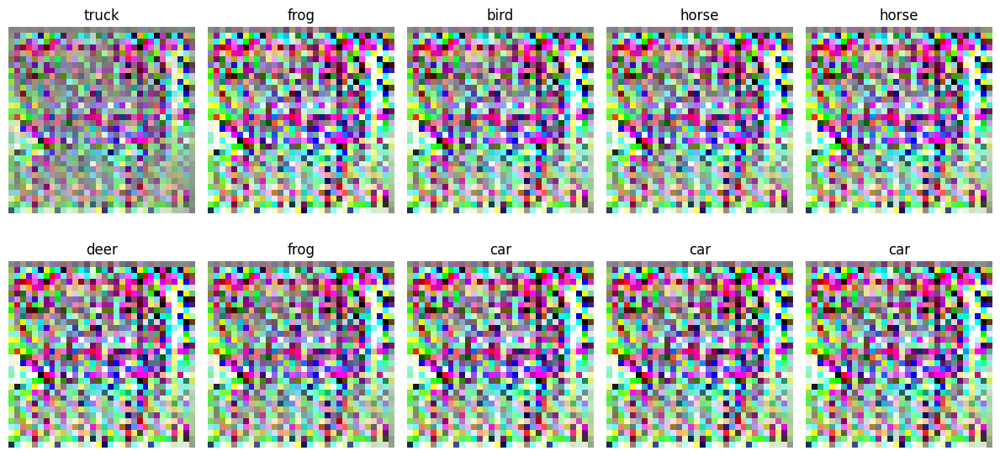

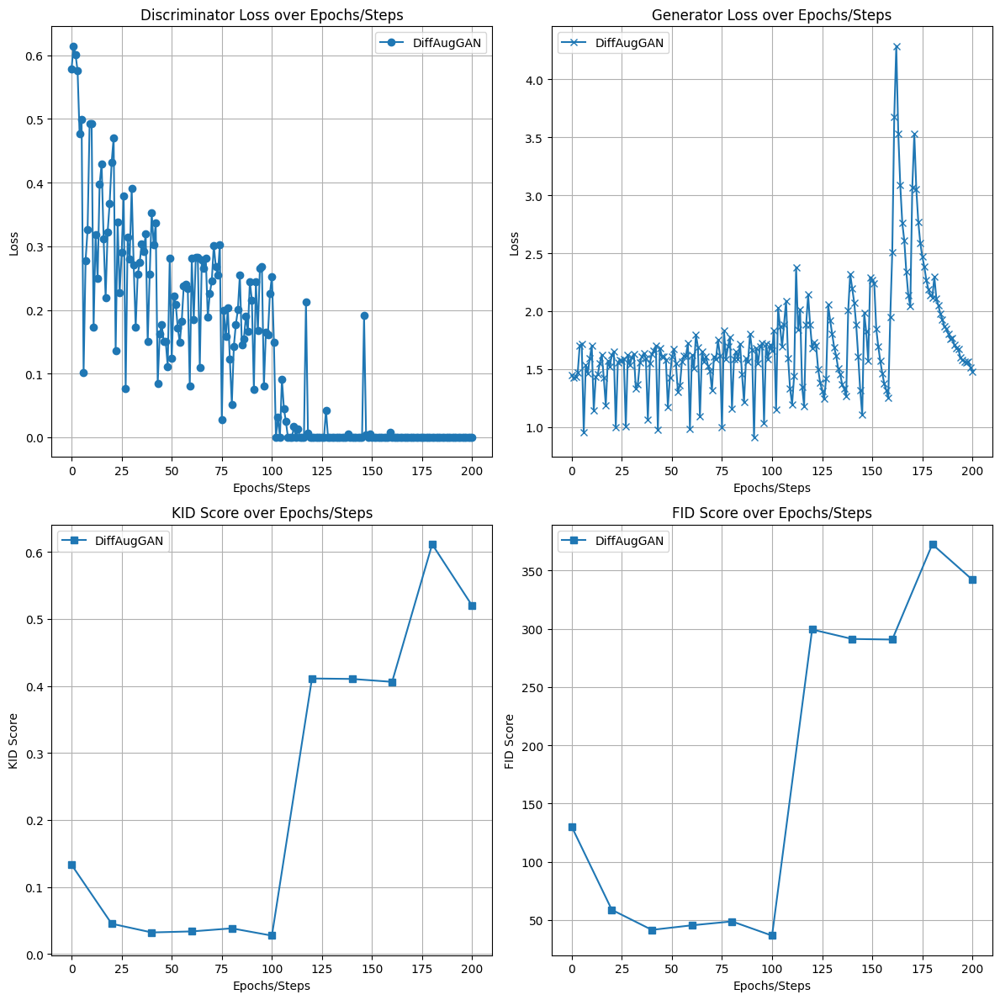

<Figure size 1200x600 with 0 Axes>

In [89]:
gen_shared = EmbGenerator(128,1024).to(device)
diff_disc = ACAugDiscriminator().to(device)

diffgan = DiffGAN(gen_shared,diff_disc,train_loader)
diffgan.fit(201,train_loader)
plot_losses(201,[(diffgan,"DiffAugGAN")])

diffgan.save("diffgan-200e")
torch.cuda.empty_cache()

#### Observations
- DiffAugment seems to have improved the FID reaching a new low of 36
- Generated images seem more not bad
- Training process is very unstable and slow
- After 100 epochs the model deteriorated heavily and even with the balancing, it didnt recover and just collapsed.

## Evaluation

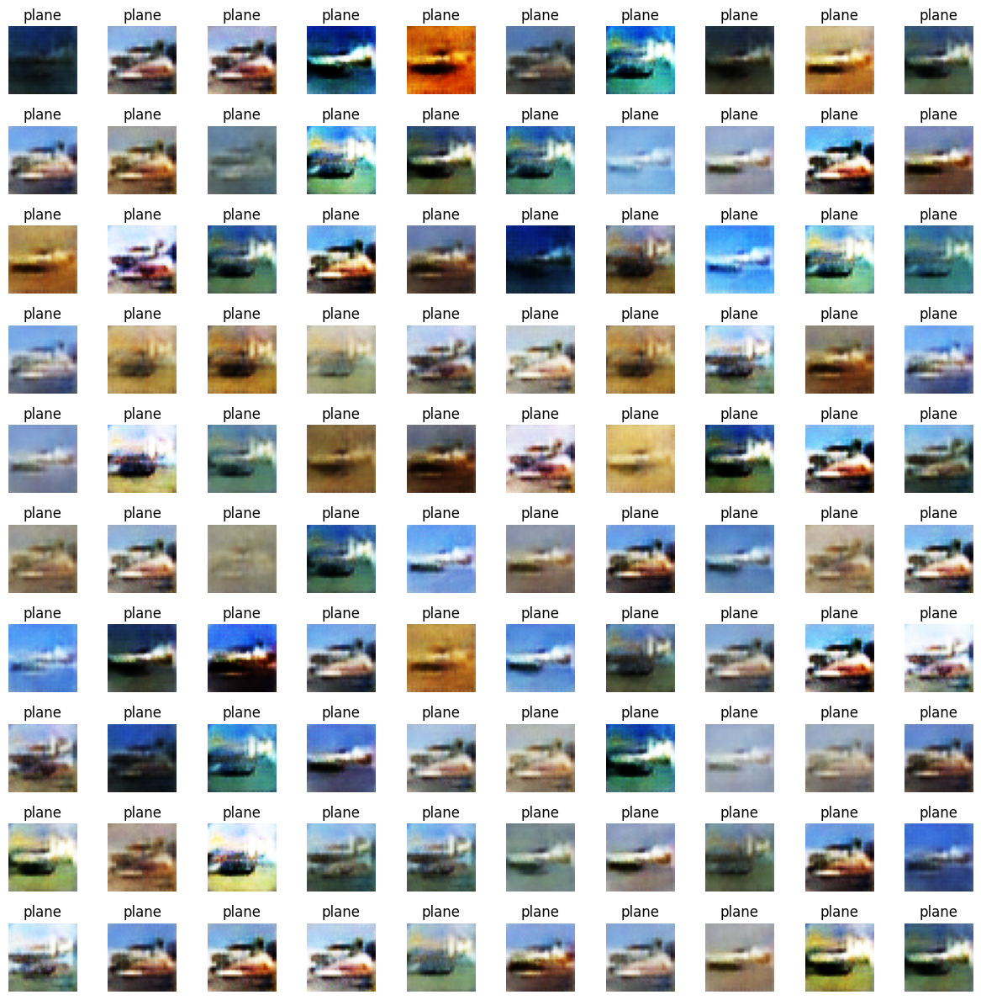

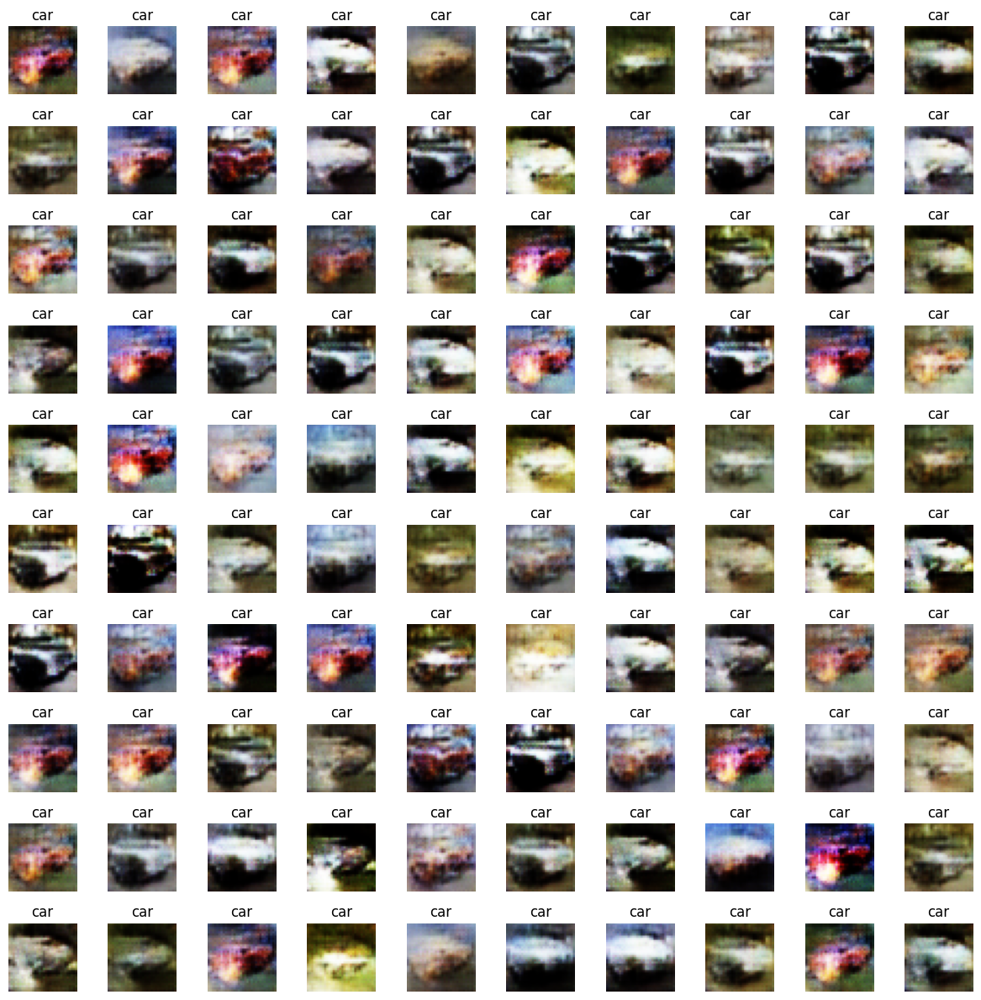

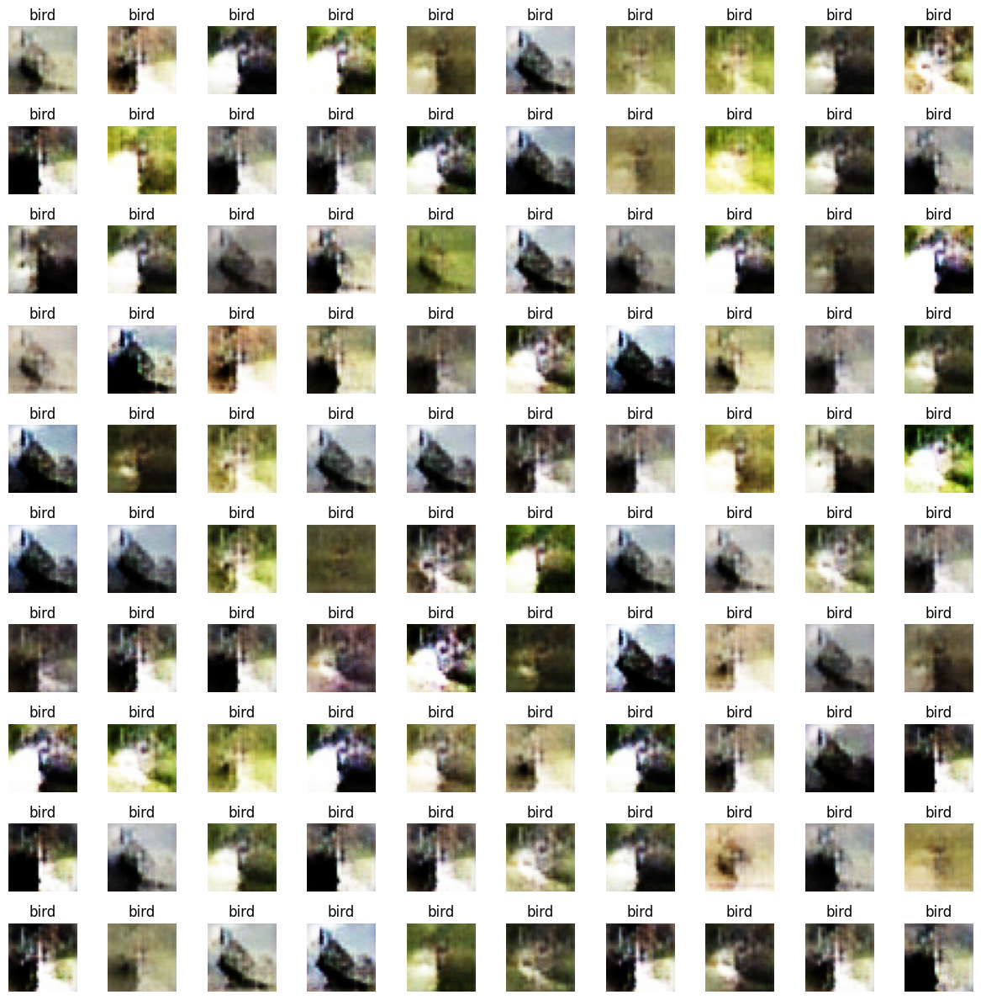

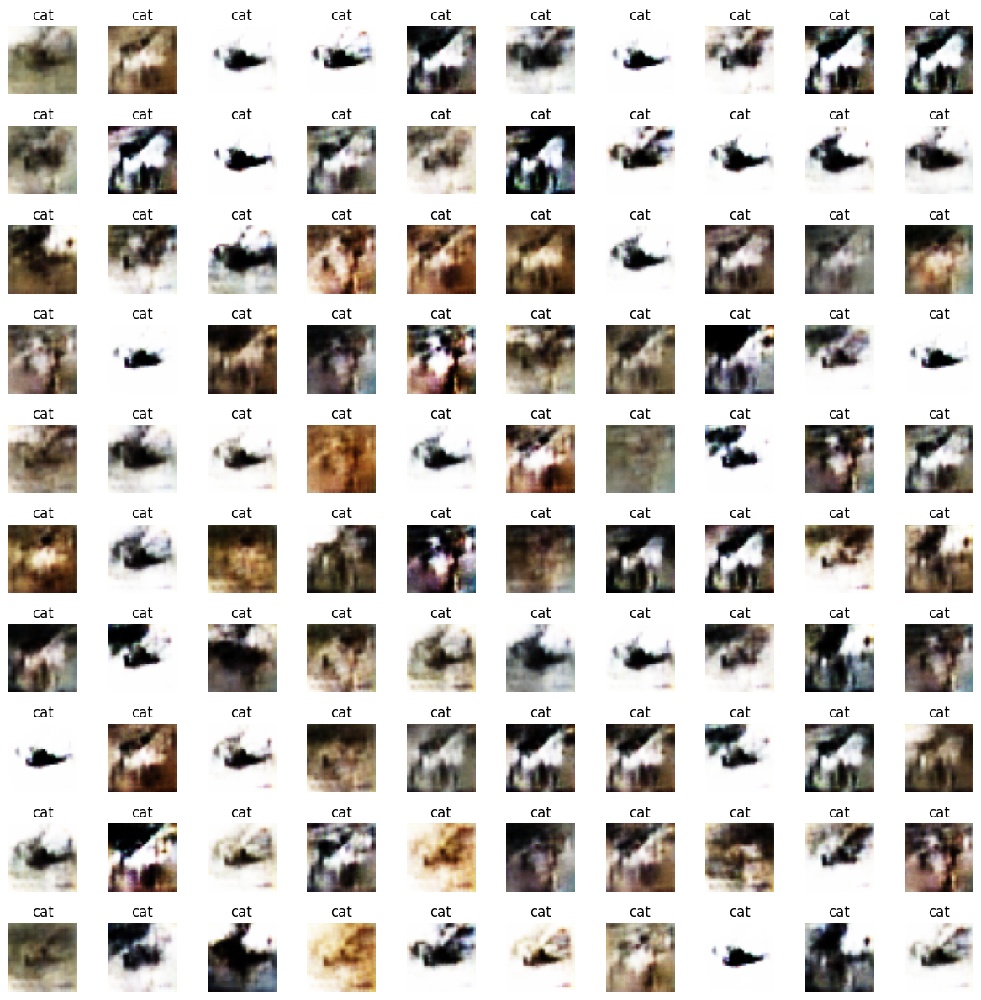

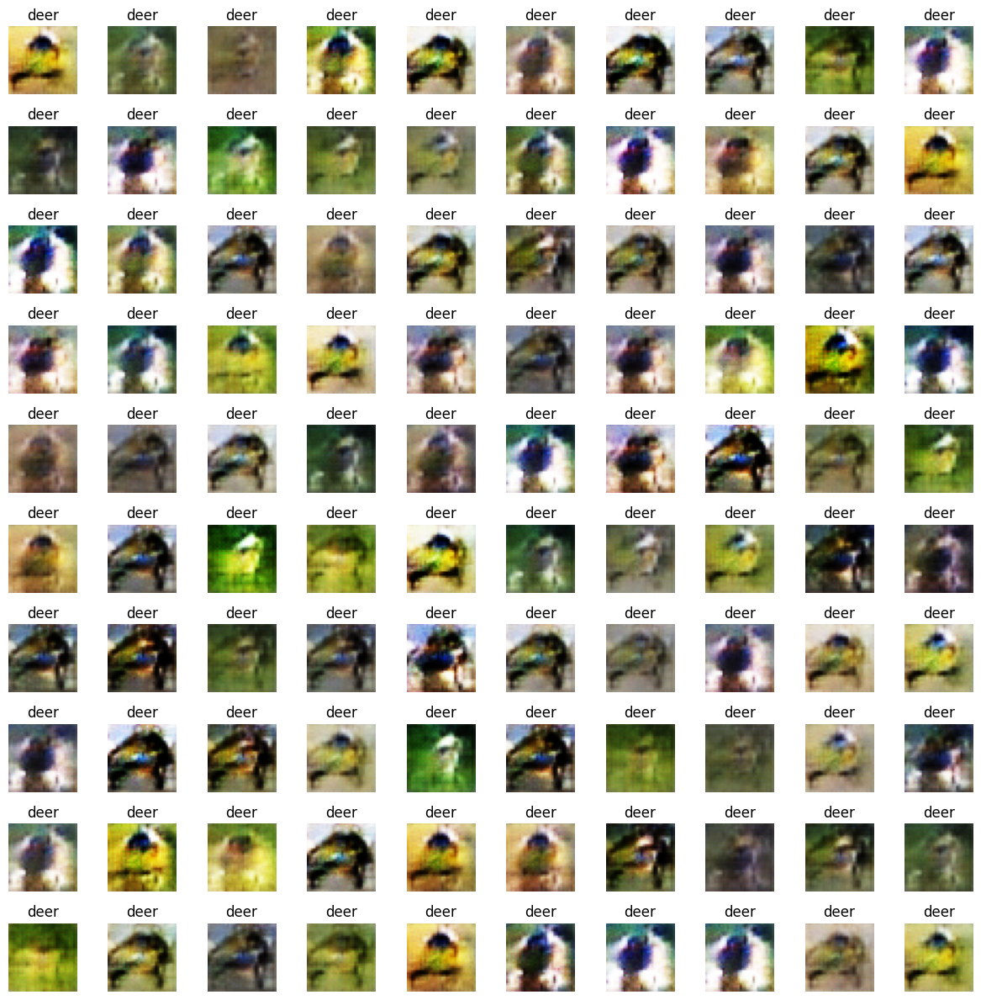

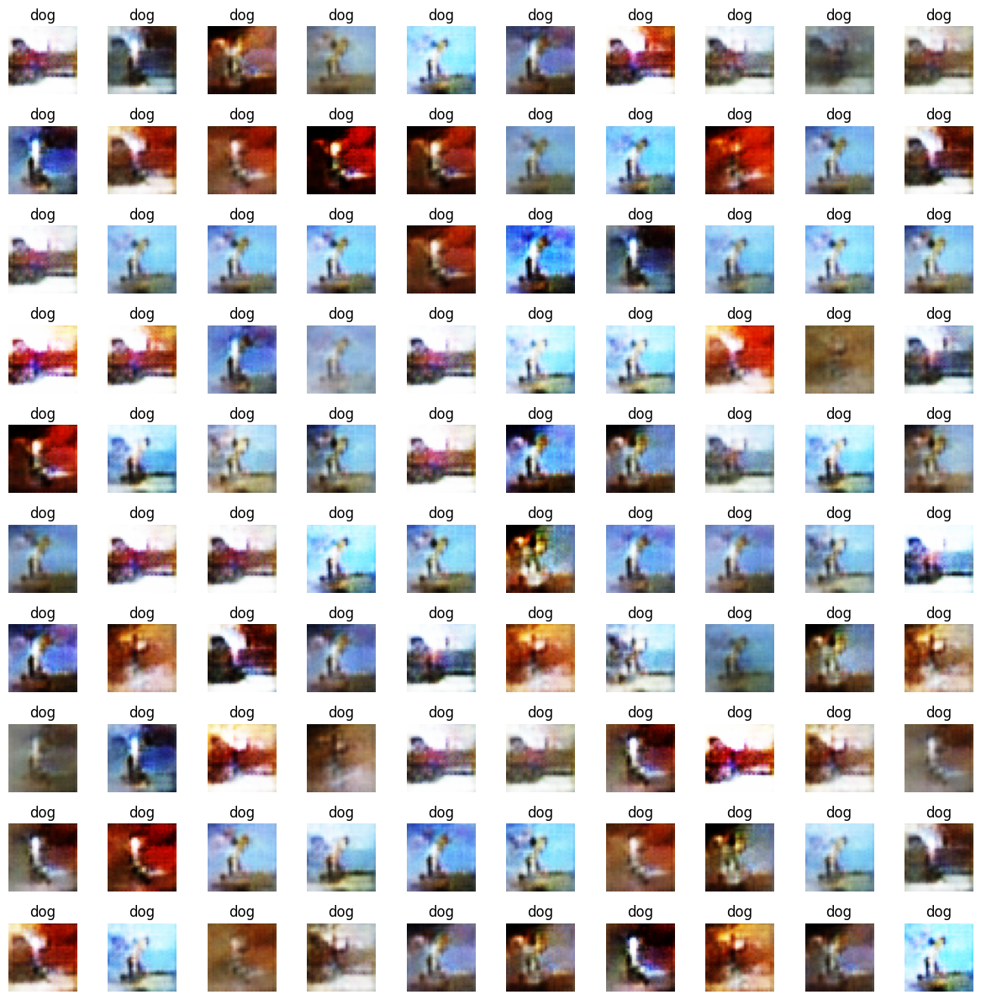

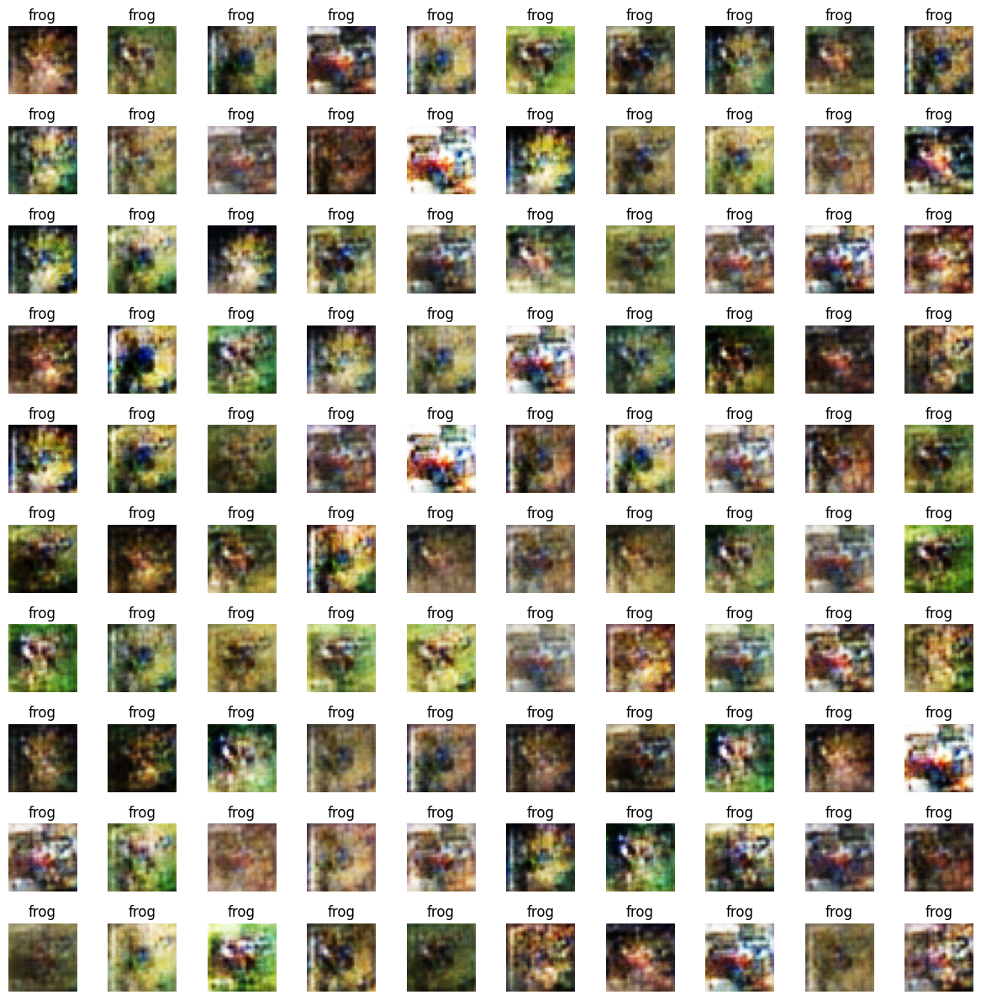

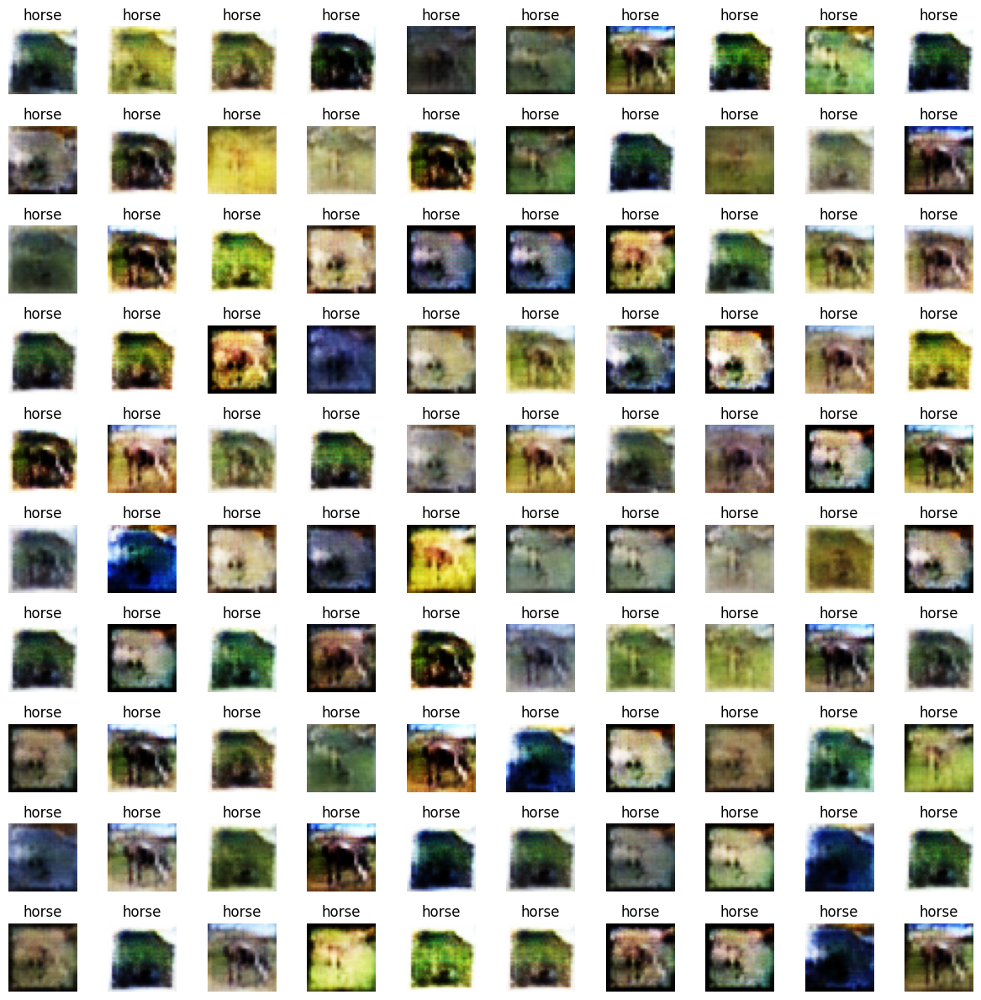

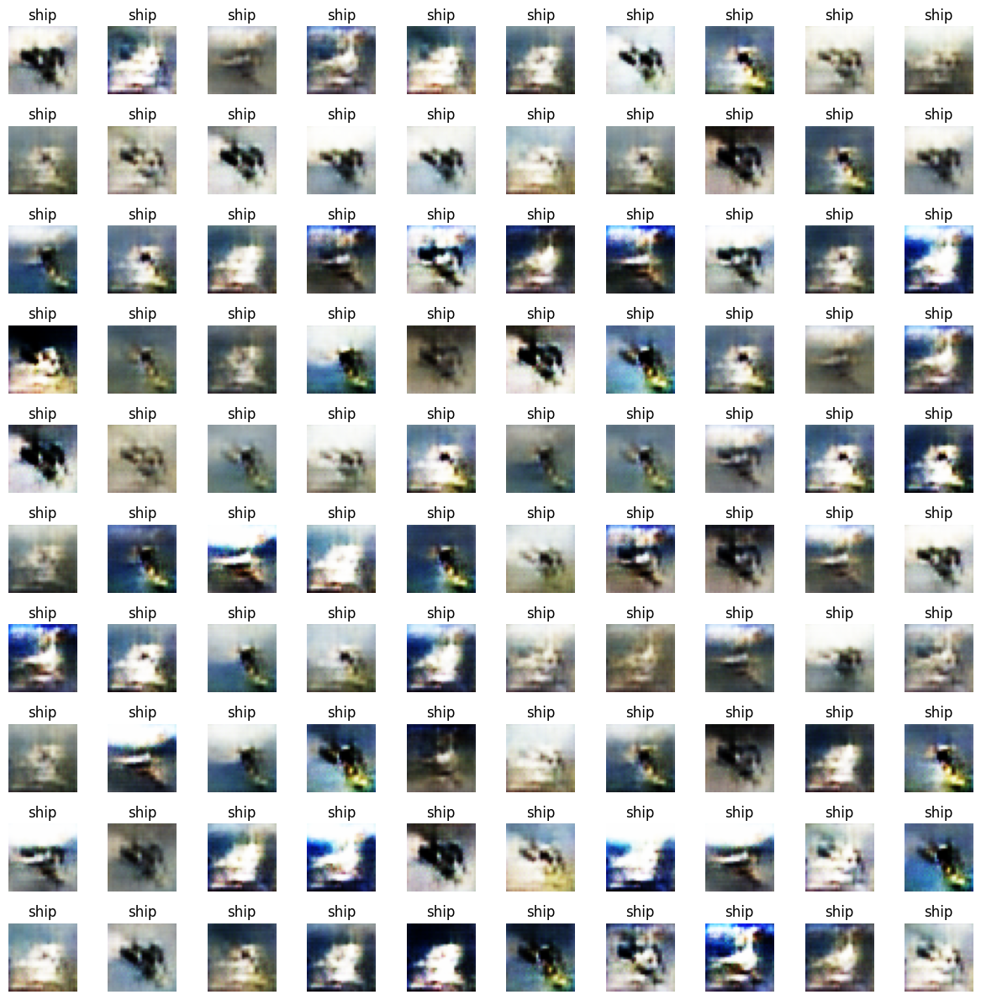

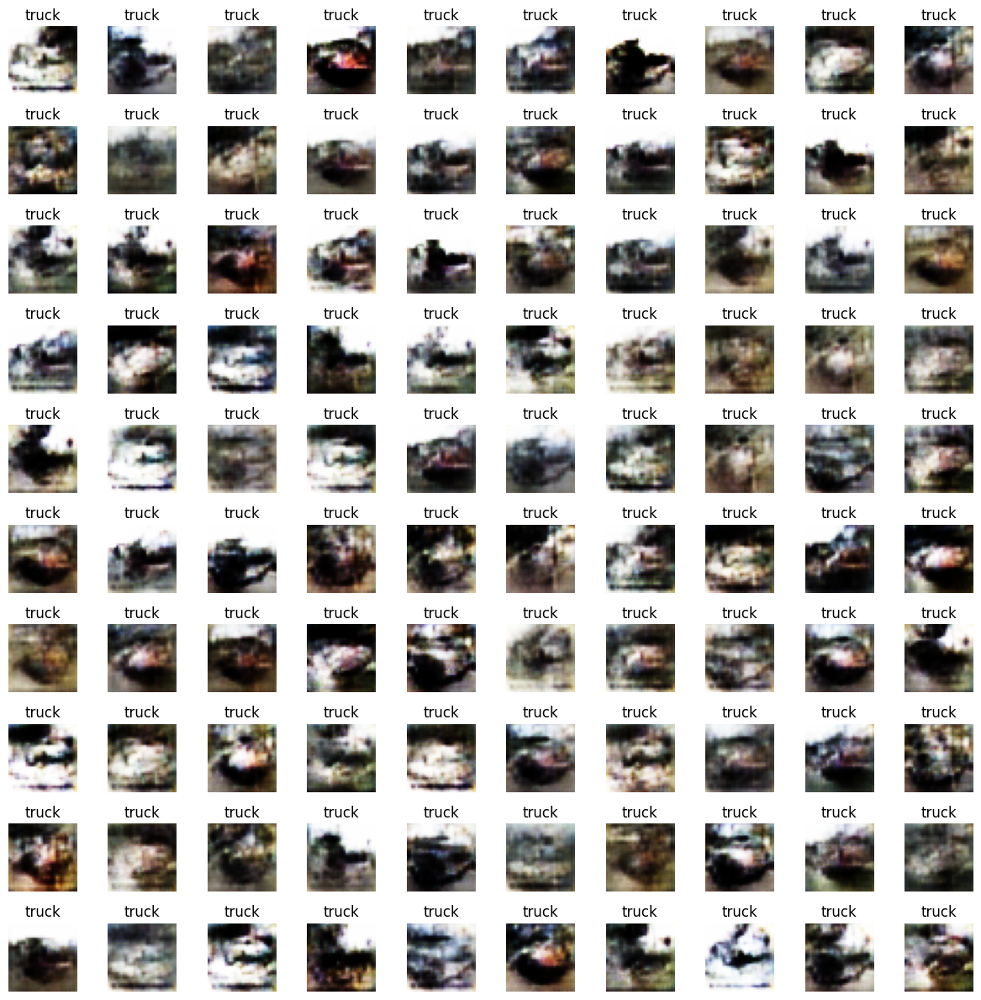

In [100]:
def display_images(imgs, labels):
    num_rows = 10
    num_cols = 10
    
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(12, 12))
    axs = axs.flatten()

    for i in range(100):
        axs[i].imshow(imgs[i])
        class_index = labels[i].nonzero().item()
        axs[i].set_title(CLASSES[class_index])
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()
    
def getClassImages(generator, num, n=100):
    generator.eval()
    noise = torch.normal(0, 1, (n, generator.latent_dim), device=device)
    
    one_hot = torch.zeros(n, 10, device=device)
    one_hot[:, num] = 1

    generated_imgs = generator(noise, one_hot)

    generated_imgs = (generated_imgs.cpu().detach().permute(0, 2, 3, 1).numpy() - (-1)) / (1 - (-1))
    display_images(generated_imgs, one_hot)

for i in range(10):
    getClassImages(acgan_embed.best_model[0], i)

## Conclusion


### Final Thoughts:

Image Quality:

Most of the images seemed to be of resonable quality. Atleast we can make up which label they are by looking at it. The model was successful in capturing the overall characteristics of an image but fails to capture the fine details. For example, for the ship, it successfully captured the sea and general shape of a ship but failes to draw the ship properly. Similiarly for the horse, it can draw the overall frame of a horse but fails at fine details like proportion and perspective. Mode collapse could be observed in many of the classes such as Dog, Cat and Bird. In Truck, Ship and Plane, although there is some diversity, there are many similiar images. I would consider Car and Truck to be our most successful generations. 

What went right?
- Conditioning: Although the variety in images is not great, all the images seem to belong ot their class or atleast exhibited the characteristics
- Stability: By using our Balancing mechanism, we were able to stabilise the model training process. This helped the discirminator and generator to go back on trakc if either begins to diverge. 

Limitations:

- Data Limitations: In many of the images present in the dataset, they have questionable photos such as a picture of the head of an oscrich classified as a bird or a dog curled up and not showing the face. These images, although are technically belong to their class, by showing weird perspectives they confuse the model on how a image should look like
- Model Limitations: We feel that the low variety of images could be attributed to our simpler architecture which may not capture all the necessary information. 
- Mode Collapse: We feel that some mode collapse might be due to excessive conditioning done at the generator, essentially making the latent vector for same class images very similiar. Although this helps in better control over the class of an image, it compromises image variety. We feel that we didn't balance the two correctly.
- DiffAugment: Although in terms of FID, diffaugment obtained our lowest ever FID values, it didn't generate good looking images and was very slow. Each epoch using diffaugment was 4-5x slower than our normal epochs. This contrained our ability to train for more epochs due to the sheer amount of time it took to train. 

How can we improve?

- More efficient FID: We had initially tries to use a library called Torch-Fidelity for our FID calculations and had fully integrated it into our code but there was a issue with the library itself. After diagnosing the problem, we found that the maintainers of the library had not properly transitioned thei code as Numpy got updates. So they were using `np.int` which was deprecated in favour of `np.int64` and `np.int32` and as a result, our lates numpy wasn't compaitble with their library. We also experimented with implementing a custom FID calculation but our method was very slow and poorly optimised as compared to TorchMetrics. 
- Better Conditioning: We tried to use Conditional Batch Normalisation to be used but couldn't get it to work properly. It was very buggy and crashed our training sometimes. But we are aware that it is a very powerful method.
- More control over image generation: We had explored the StyleGAN architecture but we decided that it was beyond the realm of our capabilities
- Different Loss functions: We found a few formulas pertaining to Hinge Loss and Wassersteing Loss but neither of them imrpoved our model substantially and we had to drop it in favour of the simpler BCE Loss. 
- ResNet Style Architectures: Although we have a good model, we somes think that maybe the model might not be complex enough to learn the information at hand. A more complex model might be the solution. But due to computing requirements as well as time requirements, we decided that a simpler architecture is good enough and decided to focus on the training process and strategies.

Future Plans:

- Experimenting with FID: We were quite intrigued with FID from the beginning and thought of using it as our loss function but that became impractical due to the slowness of FID. But in this realm there has ben progress in the research world where [in this paper](https://arxiv.org/pdf/2009.14075.pdf) researchers have found a way to calculated FID much faster and used it to backpropagate. This is something we would like to try in the future.
- Better Tuning: When training our model, we found that changing certain parameters vastly improved model performacne. We would like to explore more automated ways of doing this. One library we are look at is [Optuna](https://optuna.org/) which we didn't have time to implement. So for this project, we mainly did tuning manually.
- Different Architectures and Losses: Right now we have just one loss function mentioned here although we technically tried 3. We want to review our implementation and fix it so that is is more effective in the future. Same for architecture, as mentioned above, we would like to try more advanced archtecture patterns to enable the model to learn more information.